In [1]:
import numpy as np
from matplotlib import pyplot as plt
from scipy.linalg import eigvalsh
import gc
import csv
from scipy import stats
from matplotlib.pyplot import cm

In [2]:
def dBM(beta, num_steps, T, N):
  '''
  Generates "dBt"s for num_steps steps from t=0 to t=T, generally generates gaussians scaled by sqrt(2/nB)
  '''

  dt = (T) / (num_steps - 1)

  rng = np.random.default_rng()


  return np.sqrt(2/(N * beta)) * rng.normal(0, np.sqrt(dt), (N, num_steps - 1))

In [3]:
def DBMnp(beta, num_steps, T, N, dBM, X_0=[], window=1, plot=False, divide=True, drift=False):
  if(not isinstance(X_0, int) or not isinstance(X_0, float) or len(X_0) == 0):
    #X_0 = np.random.rand(N) #not sure what the range of initial values should be
    #X_0 = window*cp.array(rng.random(N)) - (window/2) #somewhat costly, moves numpy array to gpu
    X_0 = (window * (np.random.rand(N))) - window/2
    X_0 = np.sort(X_0)
  elif len(X_0) != N:
    raise Exception("Number of initial values does not match N!")
  else:
    X_0 = np.array(X_0, dtype=np.float64)
  
  result = X_0[:, np.newaxis]

  dt = (T) / (num_steps - 1)
  
  #could maybe be done quicker by doing numpy stuff or something else?
  if(divide):
    for i in range(num_steps - 1):
      dB = dBM[:,i]
      #dB = dB[:, np.newaxis]
      lastCol = result[:, -1][:, np.newaxis]
      temp = lastCol - lastCol.T
      np.fill_diagonal(temp, float('inf'))
      temp = np.reciprocal(temp)
      temp = np.sum(temp, axis=1) #, keepdims=True
      temp = dt  * temp * (1 / N)  #* (1 / N) #do we multiply by 1/N?
      if(drift):
        nextCol = (result[:,-1] + dB + temp - 0.5*dt*result[:,-1])[:, np.newaxis]
      else:
        nextCol = (result[:,-1] + dB + temp)[:, np.newaxis]
      result = np.append(result, nextCol, axis=1)
  else:
    for i in range(num_steps - 1):
      dB = dBM[:,i]
      #dB = dB[:, np.newaxis]
      lastCol = result[:, -1][:, np.newaxis]
      temp = lastCol - lastCol.T
      np.fill_diagonal(temp, float('inf'))
      temp = np.reciprocal(temp)
      temp = np.sum(temp, axis=1) #, keepdims=True
      temp = dt  * temp  #* (1 / N) #do we multiply by 1/N?
      
      if(drift):
        nextCol = (result[:,-1] + dB + temp - 0.5*dt*result[:,-1])[:, np.newaxis]
      else:
        nextCol = (result[:,-1] + dB + temp)[:, np.newaxis]
      
      result = np.append(result, nextCol, axis=1)
  
  times = np.linspace(0, T, num_steps)
  if(plot):
    plt.plot(times, result.T)
    plt.xlabel("time")
    plt.ylabel("value")
    plt.title("Dyson Brownian Motion for " + str(N) + " particles and beta: " + str(beta) + " with " + str(num_steps) + " steps")
    #ax = plt.gca()
    #ax.set_xlim([0,1])
    #ax.set_ylim([-window,2])
    #plt.savefig("DBM_" + str(N))
    #plt.show()
  return result, times

In [4]:
def DBMTamed(beta, num_steps, T, N, dBM, X_0=[], vprime="default", window=1, plot=False):
  if(len(X_0) == 0):
    #X_0 = np.random.rand(N) #not sure what the range of initial values should be
    #X_0 = window*cp.array(rng.random(N)) - (window/2) #somewhat costly, moves numpy array to gpu
    X_0 = (window * (np.random.rand(N))) - window/2
    X_0 = np.sort(X_0)
  elif len(X_0) != N:
    raise Exception("Number of initial values does not match N!")
  else:
    X_0 = np.array(X_0, dtype=np.float64)
  
  result = X_0[:, np.newaxis]

  dt = (T) / (num_steps - 1)

  if(isinstance(vprime, str)):
    if(vprime=="default"):
      for i in range(num_steps - 1):
        dB = dBM[:,i]
        #dB = dB[:, np.newaxis]
        lastCol = result[:, -1][:, np.newaxis]
        temp = lastCol - lastCol.T
        np.fill_diagonal(temp, float('inf'))
        temp = np.reciprocal(temp)
        temp = np.sum(temp, axis=1) #, keepdims=True
        #don't divide by 1/N??
        #temp = dt  * temp * (1 / N)  #* (1 / N) #do we multiply by 1/N?
        temp = dt * temp * (1/N)
        temp2 = dt * lastCol / (2 + dt * np.abs(lastCol))
        temp2 = temp2[:,0]
        nextCol = (result[:,-1] + dB + temp + temp2)[:, np.newaxis]
        result = np.append(result, nextCol, axis=1)
    elif(vprime=="flatish"):
      raise(Exception("TODO: Not implemented"))
  else:
    #could maybe be done quicker by doing numpy stuff or something else?
    for i in range(num_steps - 1):
      dB = dBM[:,i]
      #dB = dB[:, np.newaxis]
      lastCol = result[:, -1][:, np.newaxis]
      temp = lastCol - lastCol.T
      np.fill_diagonal(temp, float('inf'))
      temp = np.reciprocal(temp)
      temp = np.sum(temp, axis=1) #, keepdims=True
      #temp = dt  * temp * (1 / N)  #* (1 / N) #do we multiply by 1/N?
      temp = dt* temp * (1/N)
      temp2 = np.array(list(map(vprime, lastCol)))
      temp2 = dt * temp2 / (2 + dt * np.abs(lastCol))
      nextCol = (result[:,-1] + dB + temp)[:, np.newaxis]
      result = np.append(result, nextCol, axis=1)
  
  times = np.linspace(0, T, num_steps)
  if(plot):
    plt.plot(times, result.T)
    plt.xlabel("time")
    plt.ylabel("value")
    plt.title("Dyson Brownian Motion for " + str(N) + " particles and beta: " + str(beta) + " with " + str(num_steps) + " steps")
    #ax = plt.gca()
    #ax.set_xlim([0,1])
    #ax.set_ylim([-window,2])
    #plt.savefig("DBM_" + str(N))
    #plt.show()
  return result, times

In [5]:
def SLEEuler(result, num_steps, N, y0, t0, tf, t_eval=[]):
  dt = (tf - t0) / (num_steps - 1)
  zs = np.asarray([y0], dtype=np.complex128)
  for i in range(num_steps - 1):
    z = zs[-1]
    temp = z*np.ones(N)
    temp = temp - result[:,(i + 1)]
    temp = np.reciprocal(temp)
    temp = np.sum(temp)
    z = z + dt * (2/N) * temp
    zs = np.append(zs, [z])
    #print(zs)
  return zs

In [6]:
def SLEEulerE(result, num_steps, N, y0, t0, tf, E, t_eval=[], multN = True):
  dt = (tf - t0) / (num_steps - 1)
  zs = np.asarray([y0], dtype=np.complex128)
  if(multN):
    for i in range(num_steps - 1):
      z = zs[-1]
      temp = z*np.ones(N)
      temp = temp - (N * (result[:,(i + 1)] - E))
      temp = np.reciprocal(temp)
      temp = N * np.sum(temp)
      #not sure if entirely correct
      z = z + dt * 2 * temp
      zs = np.append(zs, [z])
      #print(zs)
  else:
    for i in range(num_steps - 1):
      z = zs[-1]
      temp = z*np.ones(N)
      temp = temp - (N * (result[:,(i + 1)] - E))
      temp = np.reciprocal(temp)
      temp = np.sum(temp)
      #not sure if entirely correct
      z = z + dt * 2 * temp
      zs = np.append(zs, [z])
      #print(zs)
  return zs

In [7]:
def WM(n, dist="gaussian", diag="gaussian", beta=1, scale=True, **kwargs):
    '''
    Generates eigenvalues of an nxn Wigner matrix of distribution
    defaults to GOE
    available distributions are: gaussian, bernoulli, TODO: uniform, gamma 
    '''
    rng = np.random.default_rng()
    if(dist=="gaussian"):
        if(beta == 1):
            if(scale):
                mat = rng.standard_normal((n,n))
                mat = (mat + mat.T) / (np.sqrt(2*n))
            else:
                mat = rng.standard_normal((n,n))
                mat = (mat + mat.T) / (np.sqrt(2))
        elif(beta == 2):
            if(scale):
                mat = rng.standard_normal((n,n)) + 1.j*rng.standard_normal((n,n))
                mat = (mat + mat.conj().T) / (np.sqrt(2*n))
            else:
                mat = rng.standard_normal((n,n)) + 1.j*rng.standard_normal((n,n))
                mat = (mat + mat.conj().T) / (np.sqrt(2))
    else:
        match dist:
            case "bernoulli":
                if(beta==1):
                    if(scale):
                        mat = (1/ np.sqrt(n)) * (2 * rng.binomial(1, 0.5, (n,n)) - 1)
                    else:
                        mat = 2 * rng.binomial(1, 0.5, (n,n)) - 1
                elif(beta == 2):
                    if(scale):
                        mat = (1/ np.sqrt(n)) * (2 * rng.binomial(1, 0.5, (n,n)) - 1) + 1.j * (1/ np.sqrt(n)) * (2 * rng.binomial(1, 0.5, (n,n)) - 1)
                    else:
                        mat = (2 * rng.binomial(1, 0.5, (n,n)) - 1) + 1.j * (2 * rng.binomial(1, 0.5, (n,n)) - 1)
            case "uniform":
                mat = rng.uniform(-1, 1, (n,n))
            case "gamma":
                k = kwargs.get('k', 1)
                theta = np.sqrt(1 / k)
                mat = rng.gamma(k, theta, (n, n)) - (k * theta)
        mat = np.tril(mat) + np.tril(mat, -1).T
    
    return eigvalsh(mat), mat

In [8]:
def doExperimentsTimes(beta, num_particles, num_experiments, num_steps, T, x01, x02, z0, times, label1="Gaussian", label2="Bernoulli", imgpath="", plot=True, sheet="SpreadExperimentsFinals.csv", figsize=(6.4, 4.8), plotReal=False, nscale=False, drift=False):
    
    finals1 = np.zeros(num_experiments, dtype=np.complex128)
    finals2 = np.zeros(num_experiments, dtype=np.complex128)

    shorts1 = np.zeros((len(times), num_experiments), dtype=np.complex128)
    shorts2 = np.zeros((len(times), num_experiments), dtype=np.complex128)

    fig, axes = plt.subplots(1, len(times) + 1, figsize=figsize)
    figR, axesR = plt.subplots(1, len(times) + 1, figsize=figsize)

    colors = ["red", "blue"]

    for i in range(num_experiments):
        bms = dBM(beta, num_steps, T, num_particles)
        result1, times1 = DBMnp(beta, num_steps, T, num_particles, bms, X_0=x01, drift=drift)
        result2, times2 = DBMnp(beta, num_steps, T, num_particles, bms, X_0=x02, drift=drift)
        zs1 = SLEEuler(result1, num_steps, num_particles, z0, 0, T, times1)
        zs2 = SLEEuler(result2, num_steps, num_particles, z0, 0, T, times2)
        plt.figure(fig)
        axes[0].plot(zs1.real, zs1.imag, color=colors[0], label=label1)
        axes[0].plot(zs2.real, zs2.imag, color=colors[1], label=label2)
        plt.figure(figR)
        axesR[0].plot(times1, zs1.real, color=colors[0], label=label1)
        axesR[0].plot(times2, zs2.real, color=colors[1], label=label2)

        finals1[i] = zs1[-1]
        finals2[i] = zs2[-1]

        for j in range(len(times)):
            k = round(((num_steps - 1) /  (T)) * times[j])
            shorts1[j][i] = zs1[k]
            shorts2[j][i] = zs2[k]
            #np.append(shorts1[j],zs1[k])
            #np.append(shorts2[j], zs2[k])
            plt.figure(fig)
            axes[j + 1].plot(zs1.real[:k + 1], zs1.imag[:k + 1], color=colors[0], label=label1)
            axes[j + 1].plot(zs2.real[:k + 1], zs2.imag[:k + 1], color=colors[1], label=label2)
            plt.figure(figR)
            axesR[j + 1].plot(times1[:k + 1], zs1.real[:k + 1], color=colors[0], label=label1)
            axesR[j + 1].plot(times2[:k + 1], zs2.real[:k + 1], color=colors[1], label=label2)
        #hopefully increases memory efficiency
        del zs1
        del zs2
        del result1
        del result2
        del times1
        del times2
        gc.collect()
    
    plt.figure(fig)
    fig.suptitle("Trajectories of " + str(num_experiments) + " SLEs with beta:" + str(beta) + " and n=" + str(num_particles) + " particles each from z0 = " + str(z0))
    for ax in axes:
        ax.set(xlabel="Re(z)", ylabel="Im(Z)")
    
    for ax in axes:
        ax.label_outer()
    
    axes[0].set_title("T = " + str(T))
    for j in range(0, len(times)):
        axes[j + 1].set_title("T = " + str(times[j]))
    #combines labels: https://stackoverflow.com/questions/14770735/how-do-i-change-the-figure-size-with-subplots
    handles, labels = plt.gca().get_legend_handles_labels()
    newLabels, newHandles = [], []
    for handle, label in zip(handles, labels):
      if label not in newLabels:
        newLabels.append(label)
        newHandles.append(handle)
    plt.legend(newHandles, newLabels)
    plt.savefig(imgpath + "Trajs_" + str(beta) + "_" + str(num_particles) + "_" + str(num_experiments))

    plt.figure(figR)
    figR.suptitle("Trajectories of the Real Parts of " + str(num_experiments) + " SLEs with beta:" + str(beta) + " and n=" + str(num_particles) + " particles each from z0 = " + str(z0))
    for ax in axesR:
        ax.set(xlabel="t", ylabel="Re(Z)")
    for ax in axesR:
        ax.label_outer()
    axesR[0].set_title("T = " + str(T))
    for j in range(0, len(times)):
        axesR[j + 1].set_title("T = " + str(times[j]))
    #combines labels: https://stackoverflow.com/questions/14770735/how-do-i-change-the-figure-size-with-subplots
    handles, labels = plt.gca().get_legend_handles_labels()
    newLabels, newHandles = [], []
    for handle, label in zip(handles, labels):
      if label not in newLabels:
        newLabels.append(label)
        newHandles.append(handle)
    plt.legend(newHandles, newLabels)
    plt.savefig(imgpath + "TrajsReal_" + str(beta) + "_" + str(num_particles) + "_" + str(num_experiments))
    plt.show()

    fig, axes = plt.subplots(1, len(times) + 1, figsize=figsize)
    for ax in axes:
        ax.set(xlabel="|z - mean|", ylabel="Count")
    for ax in axes:
        ax.label_outer()
    
    fig.suptitle("Distances From Mean of " + str(num_experiments) + " SLEs with beta:" + str(beta) + " and n=" + str(num_particles) + " Particles Each From z0 = " + str(z0))
    axes[0].set_title("T = " + str(T))
    sample_mean1 = np.mean(finals1)
    sample_mean2 = np.mean(finals2)
    if(nscale):
        spreads1 = num_particles * np.abs(finals1 - sample_mean1)
        spreads2 = num_particles * np.abs(finals2 - sample_mean2)
    else:
        spreads1 = np.abs(finals1 - sample_mean1)
        spreads2 = np.abs(finals2 - sample_mean2)
    #plt.hold(True)
    _, bins, _ = axes[0].hist(spreads1, color=colors[0], alpha=0.5, label=label1)
    axes[0].hist(spreads2, bins=bins, color=colors[1], alpha=0.5, label=label2)
    #axes[0].hist(spreads2, color=colors[1], label=label2)
    for j in range(0, len(times)):
        axes[j + 1].set_title("T = " + str(times[j]))
        sample_mean1 = np.mean(shorts1[j])
        sample_mean2 = np.mean(shorts2[j])
        if(nscale):
            spreads1 = num_particles * np.abs(shorts1[j] - sample_mean1)
            spreads2 = num_particles * np.abs(shorts2[j] - sample_mean2)
        else:
            spreads1 = np.abs(shorts1[j] - sample_mean1)
            spreads2 = np.abs(shorts2[j] - sample_mean2)
        _, bins, _ = axes[j + 1].hist(spreads1, color=colors[0], alpha=0.5, label=label1)
        axes[j + 1].hist(spreads2, bins=bins, color=colors[1], alpha=0.5, label=label2)
        #axes[j + 1].hist(spreads2, color=colors[1], label=label2)
    plt.legend()
    plt.savefig(imgpath + "Histogram_" + str(beta) + "_" + str(num_particles) + "_" + str(num_experiments))
    plt.show()
    
    fig, axes = plt.subplots(1, len(times) + 1, figsize=figsize)
    for ax in axes:
        ax.set(xlabel="x - mean", ylabel="Count")
    for ax in axes:
        ax.label_outer()
    fig.suptitle("Distances for Real Parts From Mean of " + str(num_experiments) + " SLEs with beta:" + str(beta) + " and n=" + str(num_particles) + " Particles Each From z0 = " + str(z0))
    axes[0].set_title("T = " + str(T))
    sample_mean1 = np.mean(finals1.real)
    sample_mean2 = np.mean(finals2.real)
    if(nscale):
        spreads1 = num_particles * (finals1.real - sample_mean1)
        spreads2 = num_particles * (finals2.real - sample_mean2)
    else:
        spreads1 = (finals1.real - sample_mean1)
        spreads2 = (finals2.real - sample_mean2)
    #plt.hold(True)
    _, bins, _ = axes[0].hist(spreads1, color=colors[0], alpha=0.5, label=label1)
    axes[0].hist(spreads2, bins=bins, color=colors[1], alpha=0.5, label=label2)
    #axes[0].hist(spreads2, color=colors[1], label=label2
    for j in range(0, len(times)):
        axes[j + 1].set_title("T = " + str(times[j]))
        sample_mean1 = np.mean(shorts1[j].real)
        sample_mean2 = np.mean(shorts2[j].real)
        if(nscale):
            spreads1 = num_particles * (shorts1[j].real - sample_mean1)
            spreads2 = num_particles * (shorts2[j].real - sample_mean2)
        else:
            spreads1 = shorts1[j].real - sample_mean1
            spreads2 = shorts2[j].real - sample_mean2
        
        _, bins, _ = axes[j + 1].hist(spreads1, color=colors[0], alpha=0.5, label=label1)
        axes[j + 1].hist(spreads2, bins=bins, color=colors[1], alpha=0.5, label=label2)
        #axes[j + 1].hist(spreads2, color=colors[1], label=label2)
    plt.legend()
    plt.savefig(imgpath + "HistogramReal_" + str(beta) + "_" + str(num_particles) + "_" + str(num_experiments))
    plt.show()

    """ print("Are the two the same at T = " + str(T) + "?")
    sample_mean1 = np.mean(finals1)
    sample_mean2 = np.mean(finals2)
    spreads1 = num_particles * (finals1 - sample_mean1) if nscale else (finals1 - sample_mean1)
    spreads2 = num_particles * (finals2 - sample_mean2) if nscale else (finals2 - sample_mean2)
    print(stats.ks_2samp(spreads1, spreads2))

    for i in range(0, len(times)):
        t = times[i]
        sample_mean1 = np.mean(shorts1[i])
        sample_mean2 = np.mean(shorts2[i])
        spreads1 = num_particles * (shorts1[i] - sample_mean1) if nscale else (shorts1[i] - sample_mean1)
        spreads2 = num_particles * (shorts2[i] - sample_mean2) if nscale else (shorts2[i] - sample_mean2)
        print("Are the two the same at T = " + str(t) + "?")

        print(stats.ks_2samp(spreads1, spreads2))
    """

    """print("Running Shaprio Wilk")
    sample_mean1 = np.mean(finals1)
    sample_mean2 = np.mean(finals2)
    spreads1 = num_particles * (finals1 - sample_mean1) if nscale else (finals1 - sample_mean1)
    spreads2 = num_particles * (finals2 - sample_mean2) if nscale else (finals2 - sample_mean2)
    swres1 = stats.shapiro(spreads1)
    swres2 = stats.shapiro(spreads2)
    print(swres1)
    print(swres2)
    swShorts1 = []
    swShorts2 = []
    for i in range(0, len(times)):
        t = times[i]
        sample_mean1 = np.mean(shorts1[i])
        sample_mean2 = np.mean(shorts2[i])
        spreads1 = num_particles * (shorts1[i] - sample_mean1) if nscale else (shorts1[i] - sample_mean1)
        spreads2 = num_particles * (shorts2[i] - sample_mean2) if nscale else (shorts2[i] - sample_mean2)
        print("T = " + str(t))
        swShorts1.append(stats.shapiro(spreads1))
        swShorts2.append(stats.shapiro(spreads2))
        print(swShorts1[i])
        print(swShorts2[i])"""

    """print("Fitting to generalized normal, note shape=2 is normal")
    print("T = " + str(T))
    #bounds = {"beta" : (0, float('inf'))}
    bounds = {"a" : (0, 1000)}
    dist = stats.levy_stable #stats.gennorm
    sample_mean1 = np.mean(finals1)
    sample_mean2 = np.mean(finals2)
    spreads1 = num_particles * np.abs((finals1 - sample_mean1)) if nscale else np.abs((finals1 - sample_mean1))
    spreads2 = num_particles * np.abs((finals2 - sample_mean2)) if nscale else np.abs((finals2 - sample_mean2))
    genNormRes1 = stats.fit(dist, spreads1, bounds=bounds)
    genNormRes2 = stats.fit(dist, spreads2, bounds=bounds)
    print(genNormRes1)
    print(genNormRes2)
    genNormResShorts1 = []
    genNormResShorts2 = []
    #for i in range(0, len(times)):
    #    t = times[i]
    #    sample_mean1 = np.mean(shorts1[i])
    #    sample_mean2 = np.mean(shorts2[i])
    #    spreads1 = num_particles * np.abs((shorts1[i] - sample_mean1)) if nscale else np.abs((shorts1[i] - sample_mean1))
    #    spreads2 = num_particles * np.abs((shorts2[i] - sample_mean2)) if nscale else np.abs((shorts2[i] - sample_mean2))
    #    print("T = " + str(t))
    #    genNormResShorts1.append(stats.fit(dist, spreads1, bounds=bounds))
    #    genNormResShorts2.append(stats.fit(dist, spreads2, bounds=bounds))
    #    print(genNormResShorts1[i])
    #    print(genNormResShorts2[i])

    genNormRes1.plot()
    plt.title("Fitted gennorm for " + label1 + " at T = " + str(T))
    plt.show()
    plt.savefig(imgpath + "Fitted for " + label1)
    genNormRes2.plot()
    plt.title("Fitted gennorm for " + label2 + " at T = " + str(T))
    plt.show()
    plt.savefig(imgpath + "Fitted for " + label2)

    #TODO maybe plot for inner times too
    for i in range(0, len(times)):
        t = times[i]
        genNormResShorts1[i].plot()
        plt.title("Fitted gennorm for " + label1 + " at T = " + str(T))
        plt.show()
        plt.savefig(imgpath + "Fitted for " + label1)
        genNormResShorts2[i].plot()
        plt.title("Fitted gennorm for " + label2 + " at T = " + str(T))
        plt.show()
        plt.savefig(imgpath + "Fitted for " + label2)

    #TODO
    #print("Testing GOF for various distribtuions for x01")
    #dists = [stats.norm, ]
    #print("Testing various distributions")
    """
    
    return finals1, finals2, shorts1, shorts2


In [9]:
def doExperimentsSingleTimes(beta, num_particles, num_experiments, num_steps, T, x0, z0, times, label1="Gaussian", label2="Bernoulli", imgpath="", plot=True, sheet="SpreadExperimentsFinals.csv", figsize=(6.4, 4.8), plotReal=False, nscale=False, drift=False):
    
    finals1 = np.zeros(num_experiments, dtype=np.complex128)

    shorts1 = np.zeros((len(times), num_experiments), dtype=np.complex128)

    fig, axes = plt.subplots(1, len(times) + 1, figsize=figsize)
    figR, axesR = plt.subplots(1, len(times) + 1, figsize=figsize)

    colors = ["red", "blue"]

    for i in range(num_experiments):
        bms = dBM(beta, num_steps, T, num_particles)
        result1, times1 = DBMnp(beta, num_steps, T, num_particles, bms, X_0=x01, drift=drift)
        zs1 = SLEEuler(result1, num_steps, num_particles, z0, 0, T, times1)
        plt.figure(fig)
        axes[0].plot(zs1.real, zs1.imag, color=colors[0], label=label1)
        plt.figure(figR)
        axesR[0].plot(times1, zs1.real, color=colors[0], label=label1)

        finals1[i] = zs1[-1]

        for j in range(len(times)):
            k = round(((num_steps - 1) /  (T)) * times[j])
            shorts1[j][i] = zs1[k]
            #np.append(shorts1[j],zs1[k])
            #np.append(shorts2[j], zs2[k])
            plt.figure(fig)
            axes[j + 1].plot(zs1.real[:k + 1], zs1.imag[:k + 1], color=colors[0], label=label1)
            plt.figure(figR)
            axesR[j + 1].plot(times1[:k + 1], zs1.real[:k + 1], color=colors[0], label=label1)
        #hopefully increases memory efficiency
        del zs1
        del result1
        del times1
        gc.collect()
    
    plt.figure(fig)
    fig.suptitle("Trajectories of " + str(num_experiments) + " SLEs with beta:" + str(beta) + " and n=" + str(num_particles) + " particles each from z0 = " + str(z0))
    for ax in axes:
        ax.set(xlabel="Re(z)", ylabel="Im(Z)")
    
    for ax in axes:
        ax.label_outer()
    
    axes[0].set_title("T = " + str(T))
    for j in range(0, len(times)):
        axes[j + 1].set_title("T = " + str(times[j]))
    #combines labels: https://stackoverflow.com/questions/14770735/how-do-i-change-the-figure-size-with-subplots
    handles, labels = plt.gca().get_legend_handles_labels()
    newLabels, newHandles = [], []
    for handle, label in zip(handles, labels):
      if label not in newLabels:
        newLabels.append(label)
        newHandles.append(handle)
    #plt.legend(newHandles, newLabels)
    plt.savefig(imgpath + "Trajs_" + str(num_particles) + "_" + str(num_experiments))

    plt.figure(figR)
    figR.suptitle("Trajectories of the Real Parts of " + str(num_experiments) + " SLEs with beta:" + str(beta) + " and n=" + str(num_particles) + " particles each from z0 = " + str(z0))
    for ax in axesR:
        ax.set(xlabel="t", ylabel="Re(Z)")
    for ax in axesR:
        ax.label_outer()
    axesR[0].set_title("T = " + str(T))
    for j in range(0, len(times)):
        axesR[j + 1].set_title("T = " + str(times[j]))
    #combines labels: https://stackoverflow.com/questions/14770735/how-do-i-change-the-figure-size-with-subplots
    handles, labels = plt.gca().get_legend_handles_labels()
    newLabels, newHandles = [], []
    for handle, label in zip(handles, labels):
      if label not in newLabels:
        newLabels.append(label)
        newHandles.append(handle)
    plt.legend(newHandles, newLabels)
    plt.savefig(imgpath + "TrajsReal_" + str(num_particles) + "_" + str(num_experiments))
    plt.show()

    fig, axes = plt.subplots(1, len(times) + 1, figsize=figsize)
    for ax in axes:
        ax.set(xlabel="|z - mean|", ylabel="Count")
    for ax in axes:
        ax.label_outer()
    
    fig.suptitle("Distances From Mean of " + str(num_experiments) + " SLEs with beta:" + str(beta) + " and n=" + str(num_particles) + " Particles Each From z0 = " + str(z0))
    axes[0].set_title("T = " + str(T))
    sample_mean1 = np.mean(finals1)
    if(nscale):
        spreads1 = num_particles * np.abs(finals1 - sample_mean1)
    else:
        spreads1 = np.abs(finals1 - sample_mean1)
    #plt.hold(True)
    _, bins, _ = axes[0].hist(spreads1, color=colors[0], alpha=1, label=label1)
    #axes[0].hist(spreads2, color=colors[1], label=label2)
    for j in range(0, len(times)):
        axes[j + 1].set_title("T = " + str(times[j]))
        sample_mean1 = np.mean(shorts1[j])
        if(nscale):
            spreads1 = num_particles * np.abs(shorts1[j] - sample_mean1)
        else:
            spreads1 = np.abs(shorts1[j] - sample_mean1)
        _, bins, _ = axes[j + 1].hist(spreads1, color=colors[0], alpha=1, label=label1)
        #axes[j + 1].hist(spreads2, color=colors[1], label=label2)
    plt.legend()
    plt.savefig(imgpath + "Histogram_" + str(num_particles) + "_" + str(num_experiments))
    plt.show()
    
    fig, axes = plt.subplots(1, len(times) + 1, figsize=figsize)
    for ax in axes:
        ax.set(xlabel="x - mean", ylabel="Count")
    for ax in axes:
        ax.label_outer()
    fig.suptitle("Distances for Real Parts From Mean of " + str(num_experiments) + " SLEs with beta:" + str(beta) + " and n=" + str(num_particles) + " Particles Each From z0 = " + str(z0))
    axes[0].set_title("T = " + str(T))
    sample_mean1 = np.mean(finals1.real)
    if(nscale):
        spreads1 = num_particles * (finals1.real - sample_mean1)
    else:
        spreads1 = (finals1.real - sample_mean1)
    #plt.hold(True)
    _, bins, _ = axes[0].hist(spreads1, color=colors[0], alpha=1, label=label1)
    #axes[0].hist(spreads2, color=colors[1], label=label2
    for j in range(0, len(times)):
        axes[j + 1].set_title("T = " + str(times[j]))
        sample_mean1 = np.mean(shorts1[j].real)
        if(nscale):
            spreads1 = num_particles * (shorts1[j].real - sample_mean1)
        else:
            spreads1 = shorts1[j].real - sample_mean1
        
        _, bins, _ = axes[j + 1].hist(spreads1, color=colors[0], alpha=1, label=label1)
        #axes[j + 1].hist(spreads2, color=colors[1], label=label2)
    plt.legend()
    plt.savefig(imgpath + "HistogramReal_" + str(num_particles) + "_" + str(num_experiments))
    plt.show()
    
    return finals1, shorts1


In [13]:
%matplotlib inline

#TODO: Look into fitter

import warnings
import numpy as np
import pandas as pd
import scipy.stats as st
#import statsmodels.api as sm
from scipy.stats._continuous_distns import _distn_names
import matplotlib
import matplotlib.pyplot as plt

def plotFit(data, title, xlab, ylab, savetitle):

    matplotlib.rcParams['figure.figsize'] = (16.0, 12.0)
    matplotlib.style.use('ggplot')

    #calculate number of bins
    n = np.size(data)
    bins = (np.max(data) - np.min(data)) / (2 * st.iqr(data) * pow(np.size(data), (-1/3)))

    # Create models from data
    def best_fit_distribution(data, bins=bins, ax=None):
        """Model data by finding best fit distribution to data"""
        # Get histogram of original data
        y, x = np.histogram(data, bins=bins, density=True)
        x = (x + np.roll(x, -1))[:-1] / 2.0

        # Best holders
        best_distributions = []

        # Estimate distribution parameters from data
        for ii, distribution in enumerate([d for d in _distn_names if not d in ['levy_stable', 'studentized_range']]):

            #print("{:>3} / {:<3}: {}".format( ii+1, len(_distn_names), distribution ))

            distribution = getattr(st, distribution)

            # Try to fit the distribution
            try:
                # Ignore warnings from data that can't be fit
                with warnings.catch_warnings():
                    warnings.filterwarnings('ignore')

                    # fit dist to data
                    params = distribution.fit(data)

                    # Separate parts of parameters
                    arg = params[:-2]
                    loc = params[-2]
                    scale = params[-1]

                    # Calculate fitted PDF and error with fit in distribution
                    pdf = distribution.pdf(x, loc=loc, scale=scale, *arg)
                    sse = np.sum(np.power(y - pdf, 2.0))

                    # if axis pass in add to plot
                    try:
                        if ax:
                            pd.Series(pdf, x).plot(ax=ax)
                        end
                    except Exception:
                        pass

                    # identify if this distribution is better
                    best_distributions.append((distribution, params, sse))

            except Exception:
                pass

            
        return sorted(best_distributions, key=lambda x:x[2])

    def make_pdf(dist, params, size=10000):
        """Generate distributions's Probability Distribution Function """

        # Separate parts of parameters
        arg = params[:-2]
        loc = params[-2]
        scale = params[-1]

        # Get sane start and end points of distribution
        start = dist.ppf(0.01, *arg, loc=loc, scale=scale) if arg else dist.ppf(0.01, loc=loc, scale=scale)
        end = dist.ppf(0.99, *arg, loc=loc, scale=scale) if arg else dist.ppf(0.99, loc=loc, scale=scale)

        # Build PDF and turn into pandas Series
        x = np.linspace(start, end, size)
        y = dist.pdf(x, loc=loc, scale=scale, *arg)
        pdf = pd.Series(y, x)

        return pdf

    # Load data from statsmodels datasets
    #data = pd.Series(sm.datasets.elnino.load_pandas().data.set_index('YEAR').values.ravel())

    # Plot for comparison
    plt.figure(figsize=(12,8))
    fig, ax = plt.subplots()
    ax.hist(data, bins=50, density=True, alpha=0.5, color=list(matplotlib.rcParams['axes.prop_cycle'])[1]['color'])
    #ax = data.plot(kind='hist', bins=50, density=True, alpha=0.5, color=list(matplotlib.rcParams['axes.prop_cycle'])[1]['color'])

    # Save plot limits
    dataYLim = ax.get_ylim()

    # Find best fit distribution
    best_distibutions = best_fit_distribution(data, 200, ax)
    best_dist = best_distibutions[0]

    # Update plots
    ax.set_ylim(dataYLim)
    ax.set_title(title + '\n All Fitted Distributions')
    ax.set_xlabel(xlab)
    #ax.set_xlabel(u'Temp (°C)')
    ax.set_ylabel(ylab)
    plt.savefig(savetitle + "_alldist")

    # Make PDF with best params 
    pdf = make_pdf(best_dist[0], best_dist[1])

    # Display
    plt.figure(figsize=(12,8))
    ax = pdf.plot(lw=2, label='PDF', legend=True)
    plt.hist(data, bins=50, density=True, alpha=0.5, color=list(matplotlib.rcParams['axes.prop_cycle'])[1]['color'])
    #data.plot(kind='hist', bins=50, density=True, alpha=0.5, label='Data', legend=True, ax=ax)

    param_names = (best_dist[0].shapes + ', loc, scale').split(', ') if best_dist[0].shapes else ['loc', 'scale']
    param_str = ', '.join(['{}={:0.2f}'.format(k,v) for k,v in zip(param_names, best_dist[1])])
    dist_str = '{}({})'.format(best_dist[0].name, param_str)

    ax.set_title(title + "\n" + dist_str)
    ax.set_xlabel(xlab)
    ax.set_ylabel(ylab)
    plt.savefig(savetitle + "_bestdist")
    print("Best Distribution: " + str(dist_str))
    print("MSE: " + str((1/n) * np.sqrt(best_dist[2])))

    

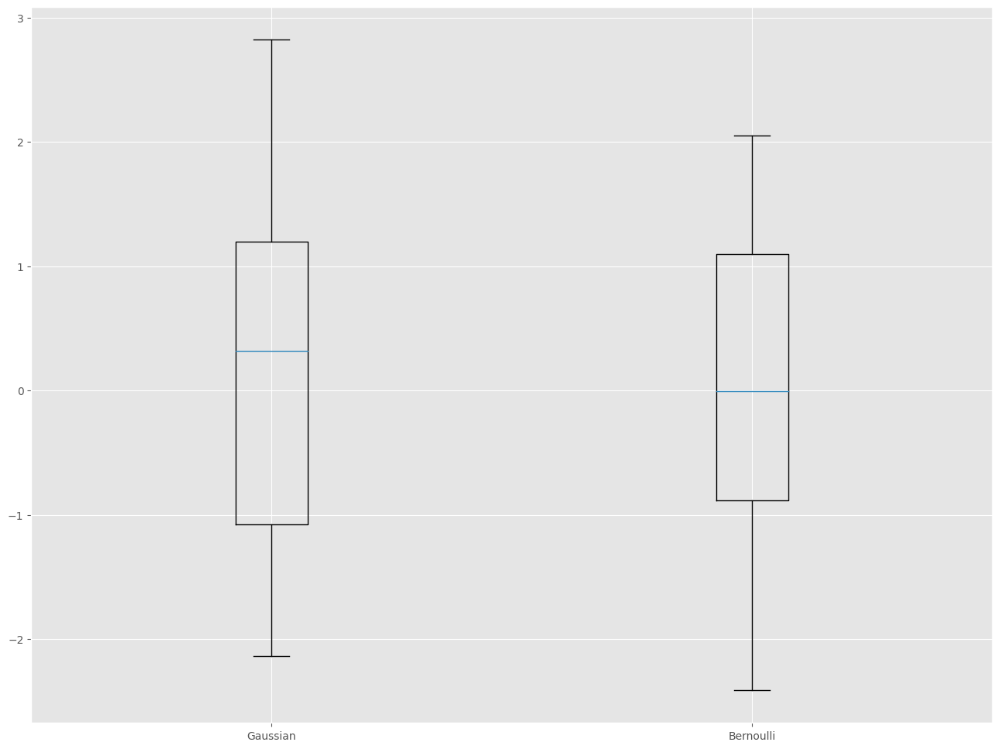

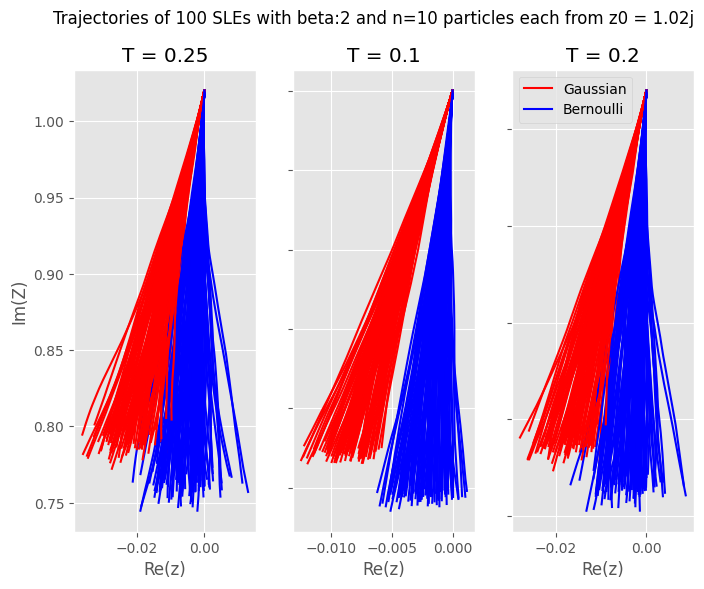

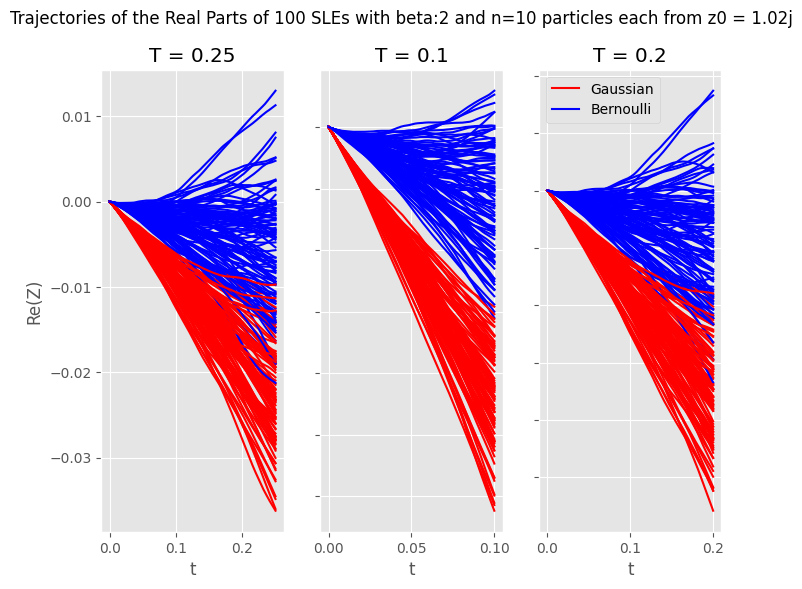

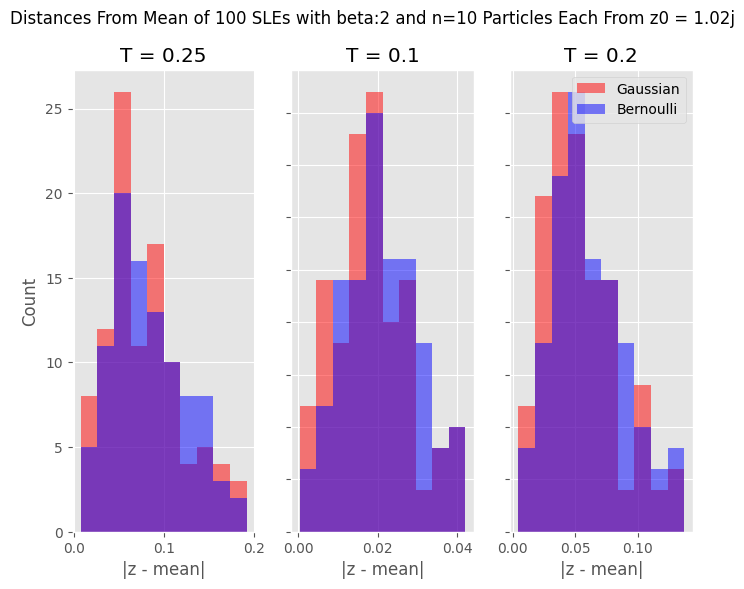

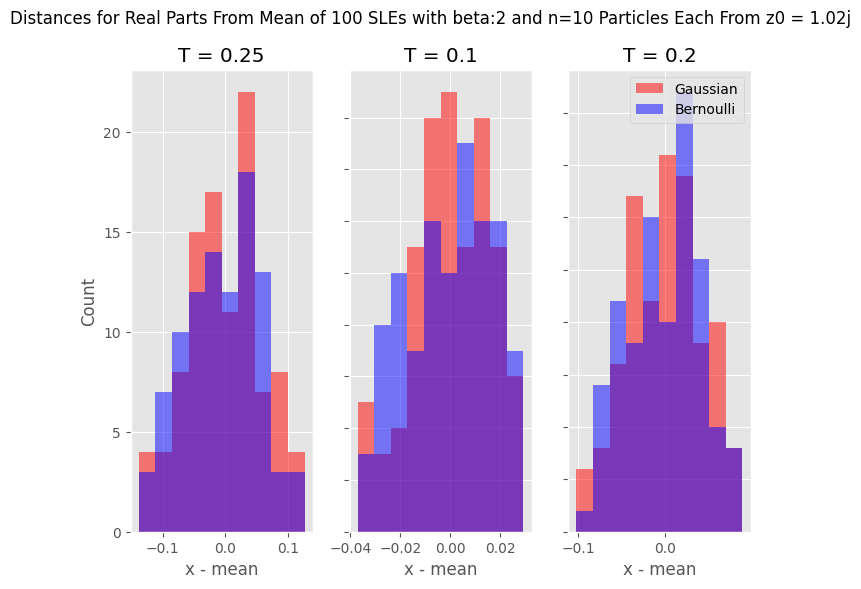

Are the two the same at T = 0.25?
KstestResult(statistic=0.07, pvalue=0.9684099261397212, statistic_location=(-0.0692958550241143-0.0189075201340827j), statistic_sign=-1)
Are the two the same at T = 0.1?
KstestResult(statistic=0.11, pvalue=0.5830090612540064, statistic_location=(-0.017471216795809118+0.012509130849387429j), statistic_sign=-1)
Are the two the same at T = 0.2?
KstestResult(statistic=0.07, pvalue=0.9684099261397212, statistic_location=(-0.04058192408501076+0.032806064067155694j), statistic_sign=-1)
Best Distribution: dgamma(a=1.92, loc=0.07, scale=0.02)
SSE: 13226.80068412672
Best Distribution: skewnorm(a=5.80, loc=0.03, scale=0.07)
SSE: 11003.321731798489


<Figure size 1200x800 with 0 Axes>

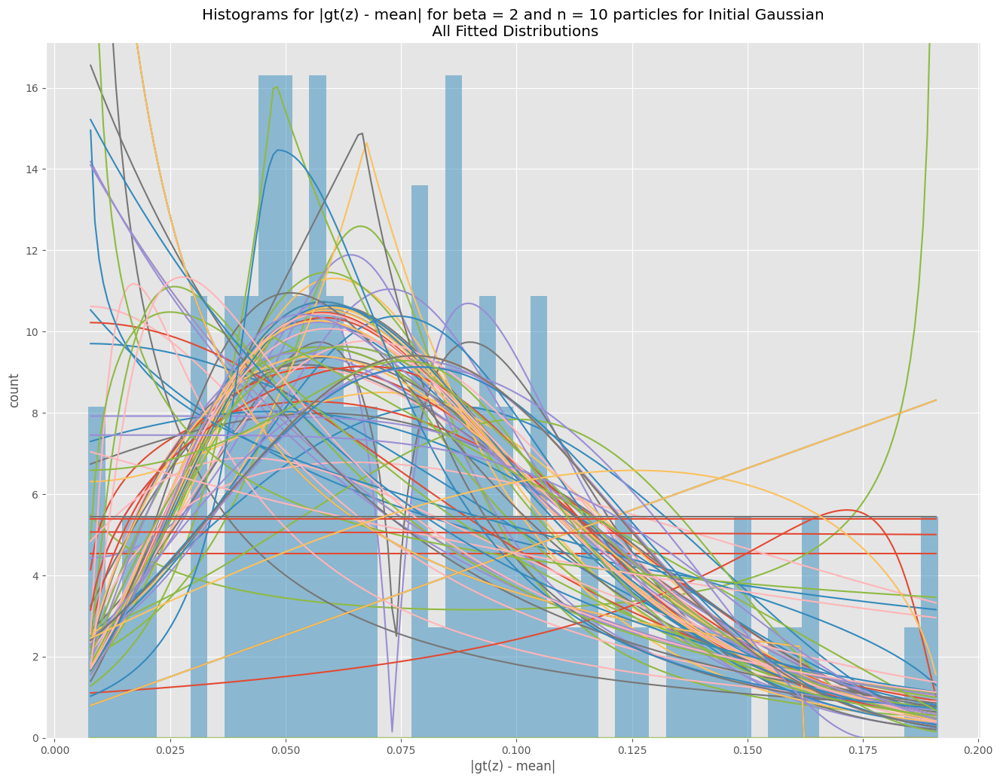

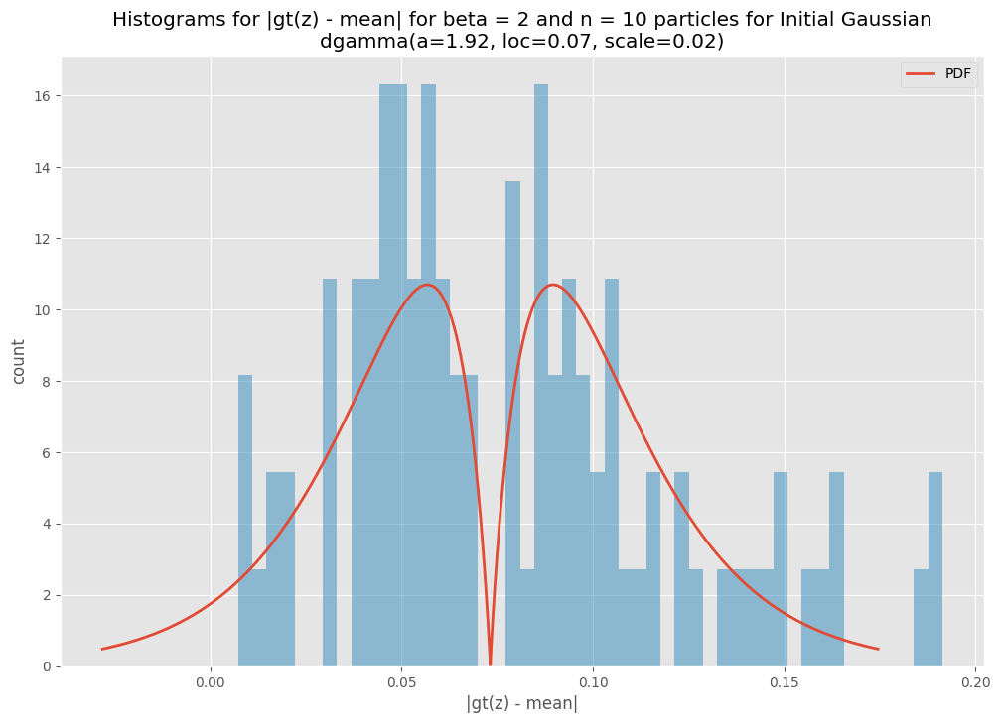

<Figure size 1200x800 with 0 Axes>

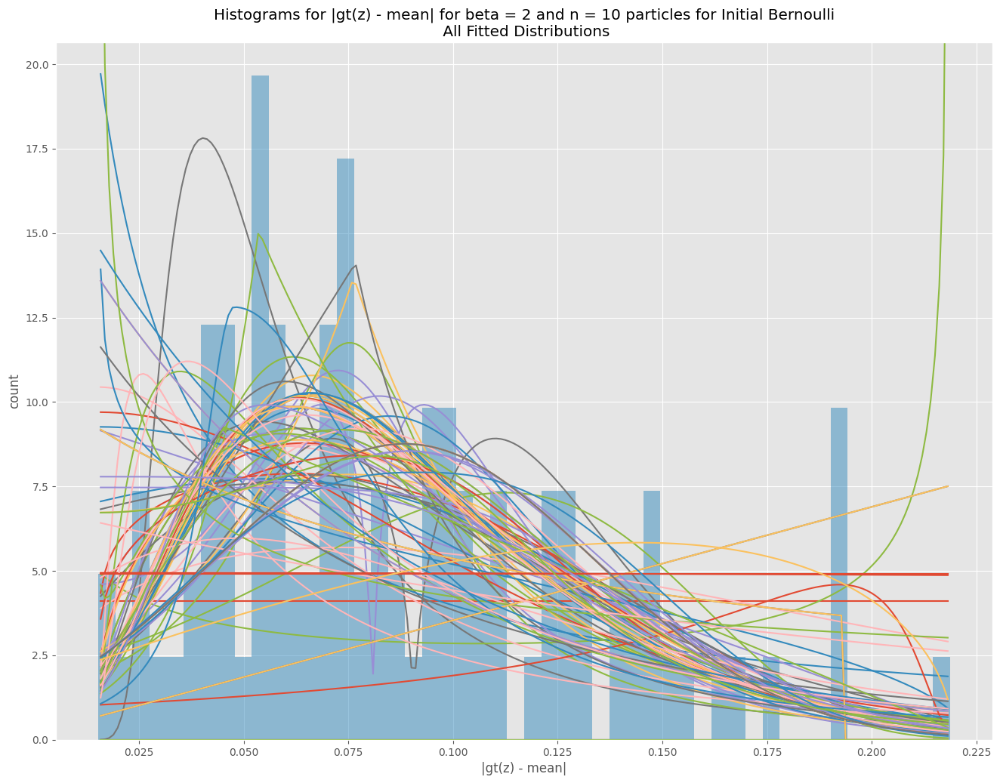

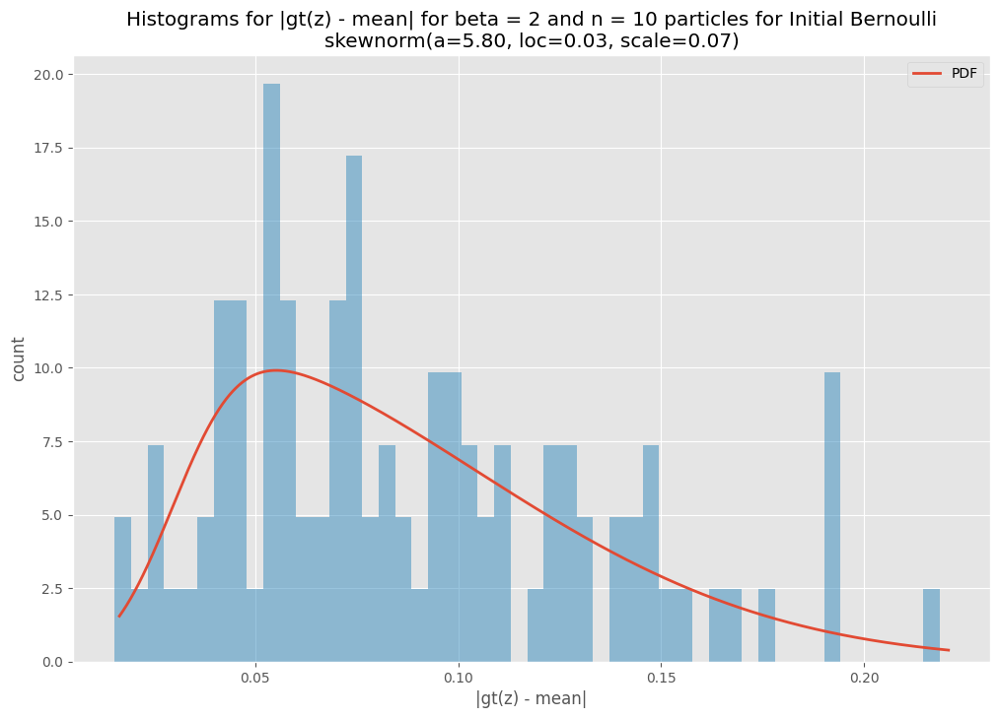

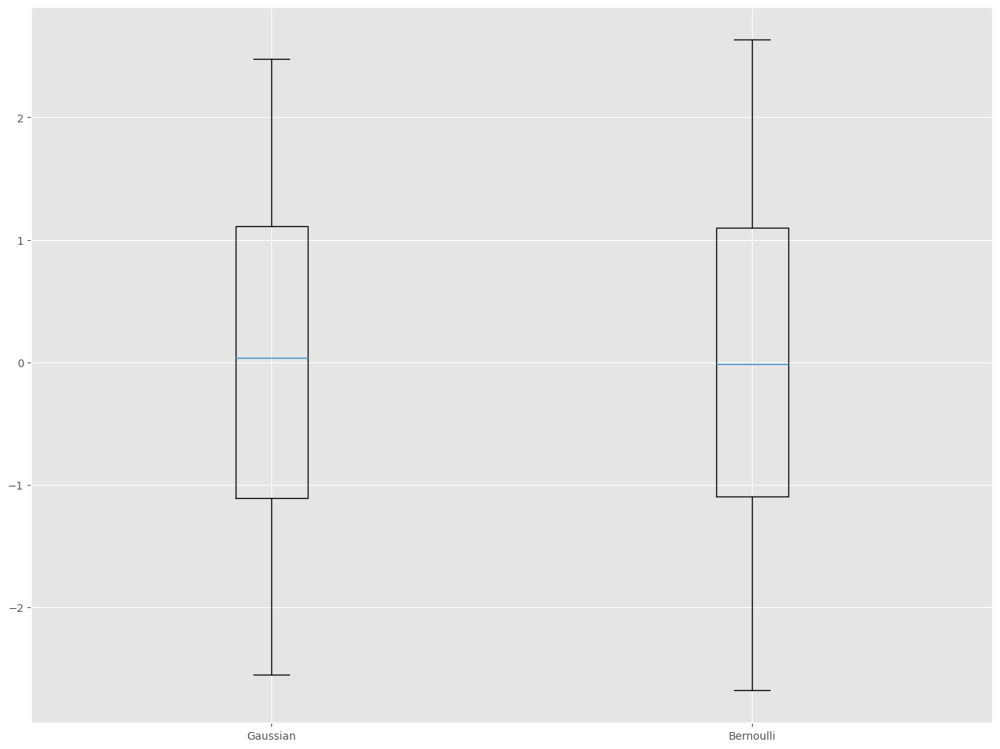

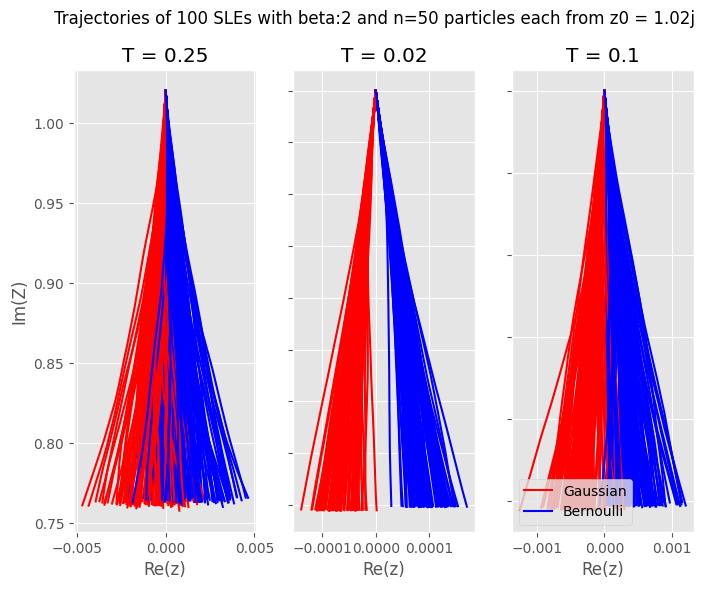

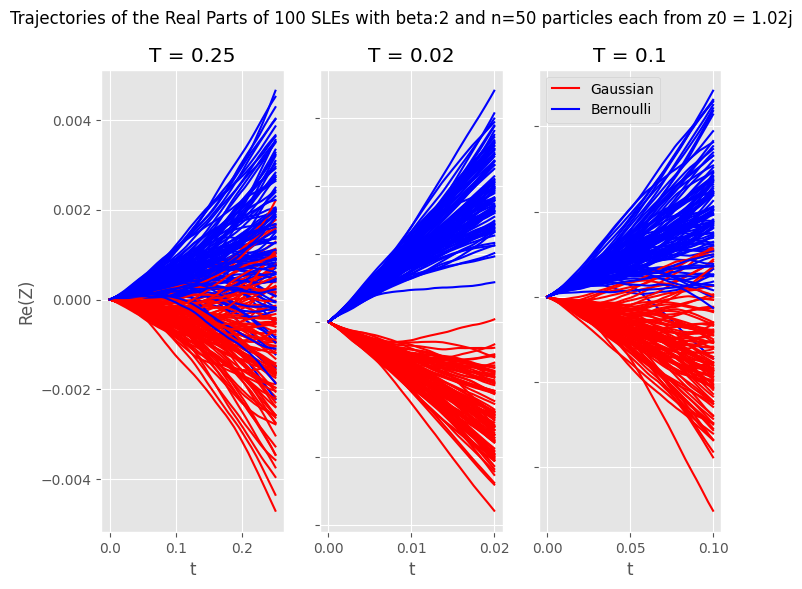

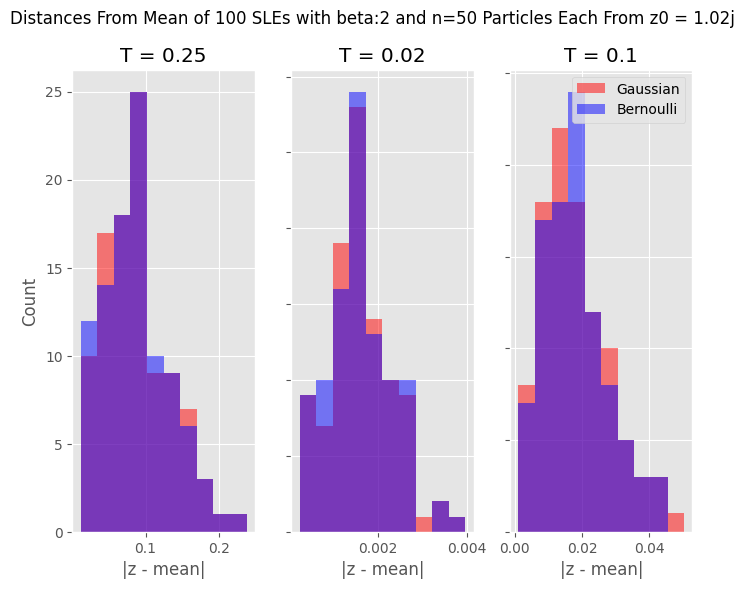

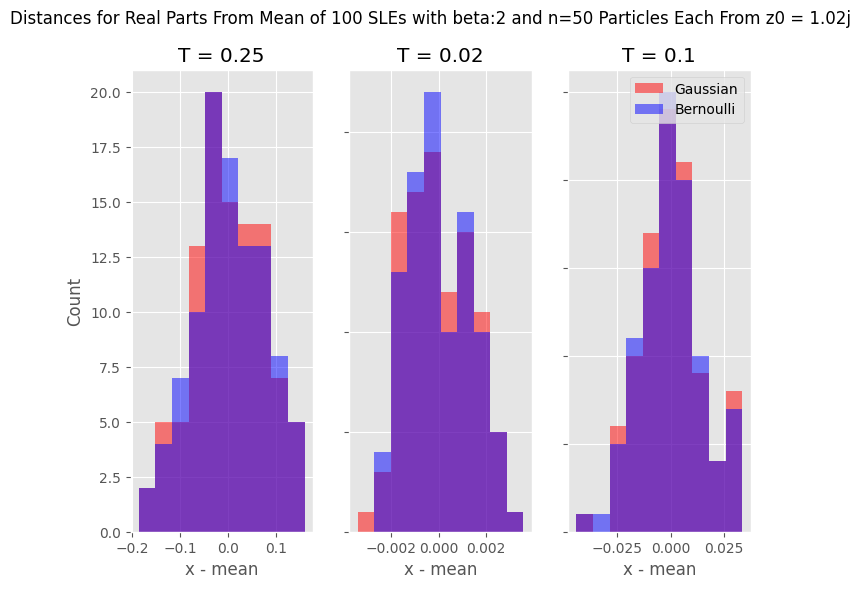

Are the two the same at T = 0.25?
KstestResult(statistic=0.03, pvalue=0.9999999999962054, statistic_location=(0.004477916409727743+0.10667130899810195j), statistic_sign=1)
Are the two the same at T = 0.02?
KstestResult(statistic=0.04, pvalue=0.999998821968263, statistic_location=(0.00019751659391891344+0.0018893934027097714j), statistic_sign=1)
Are the two the same at T = 0.1?
KstestResult(statistic=0.05, pvalue=0.9996892272702655, statistic_location=(0.0048706614668780806-0.013116064352397538j), statistic_sign=-1)
Best Distribution: dgamma(a=1.35, loc=0.08, scale=0.03)
SSE: 7287.386373437571
Best Distribution: burr(c=5.20, d=0.31, loc=0.01, scale=0.12)
SSE: 7291.414598073554


<Figure size 1200x800 with 0 Axes>

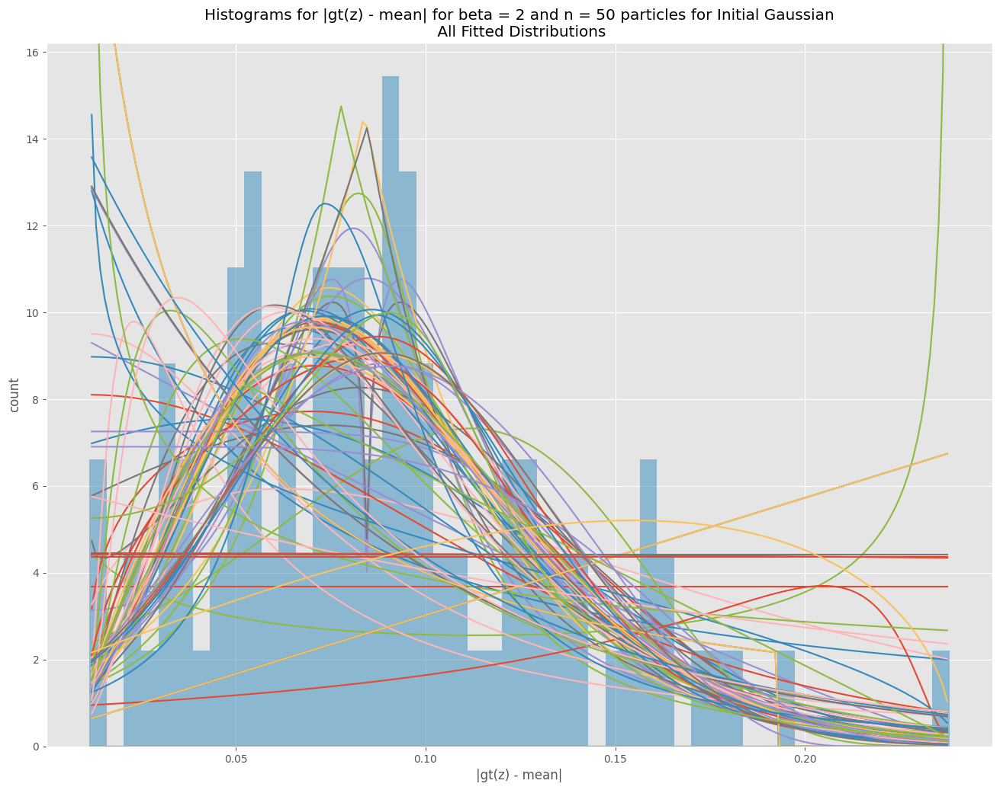

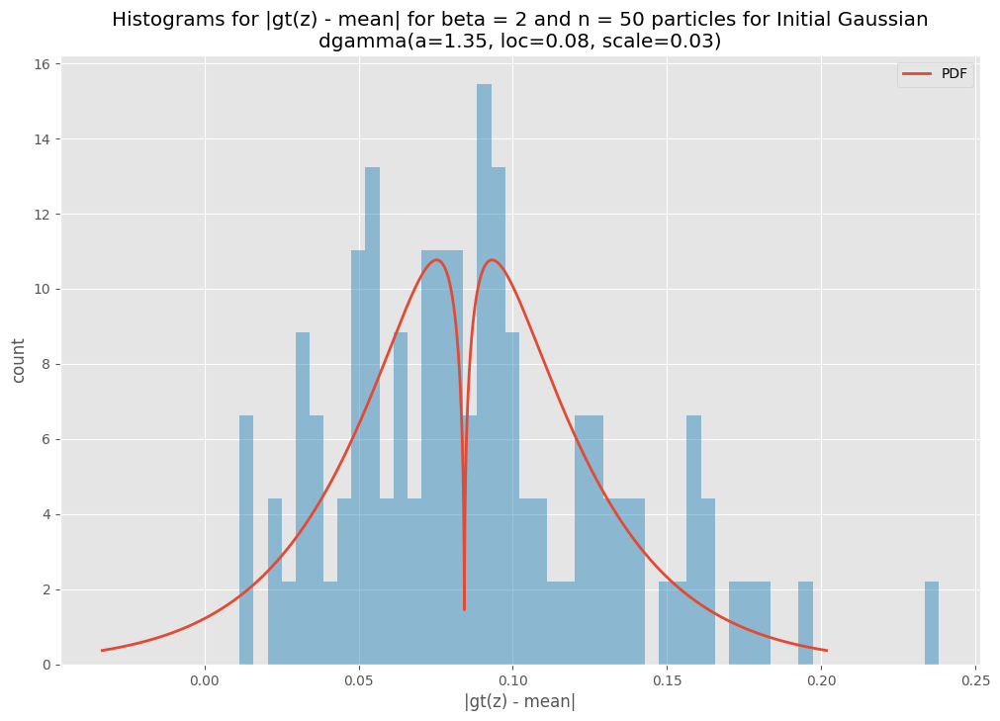

<Figure size 1200x800 with 0 Axes>

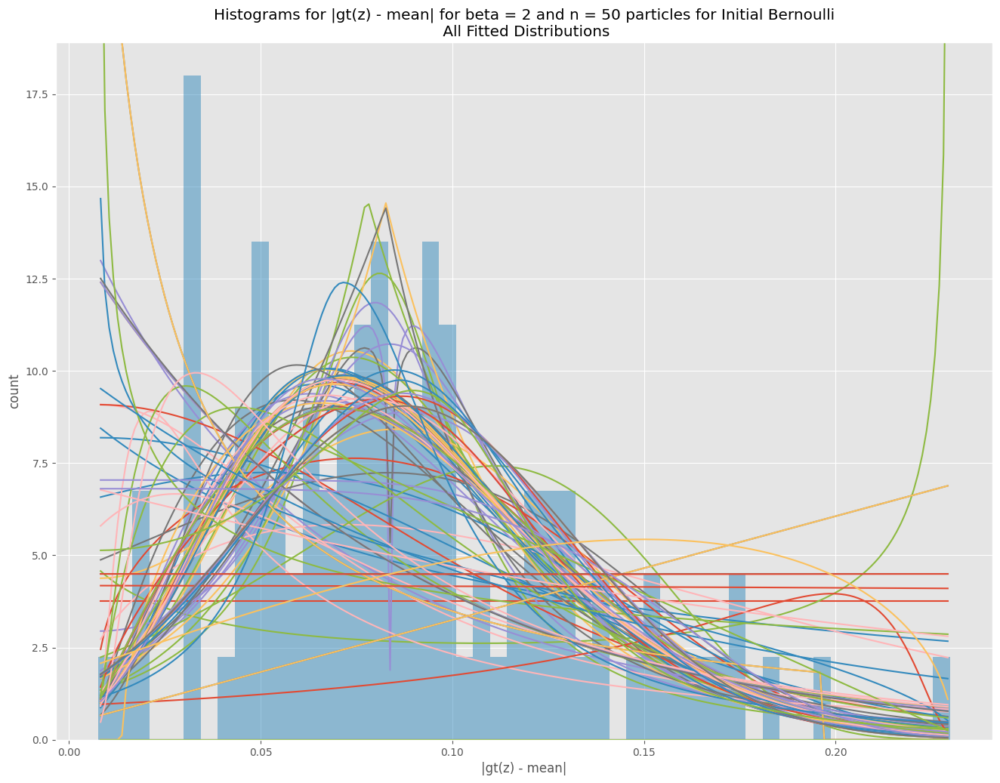

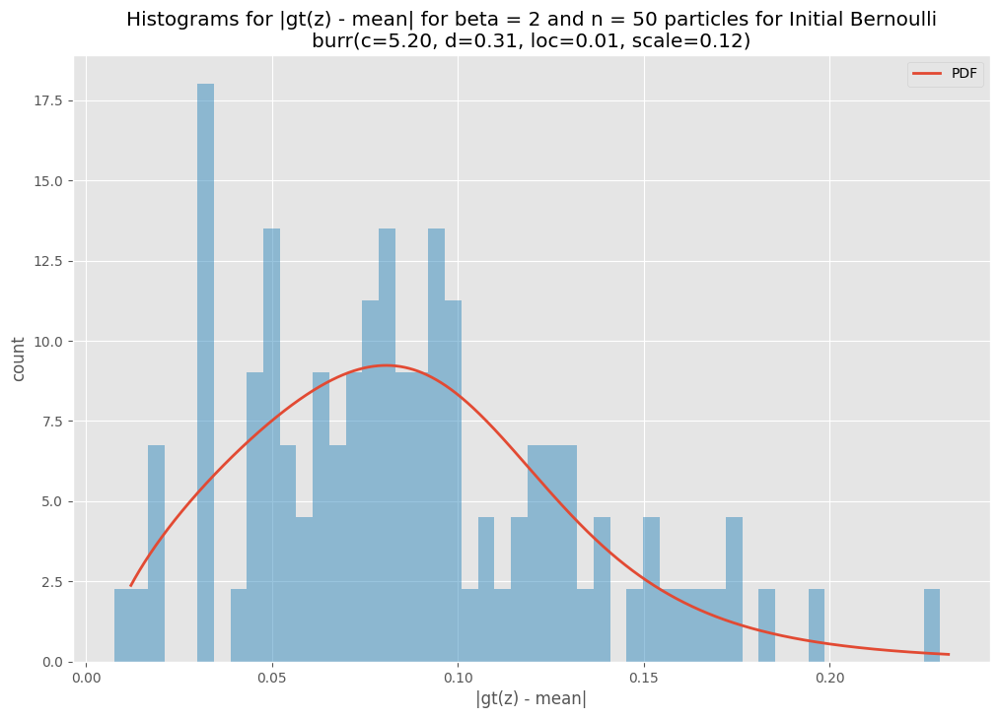

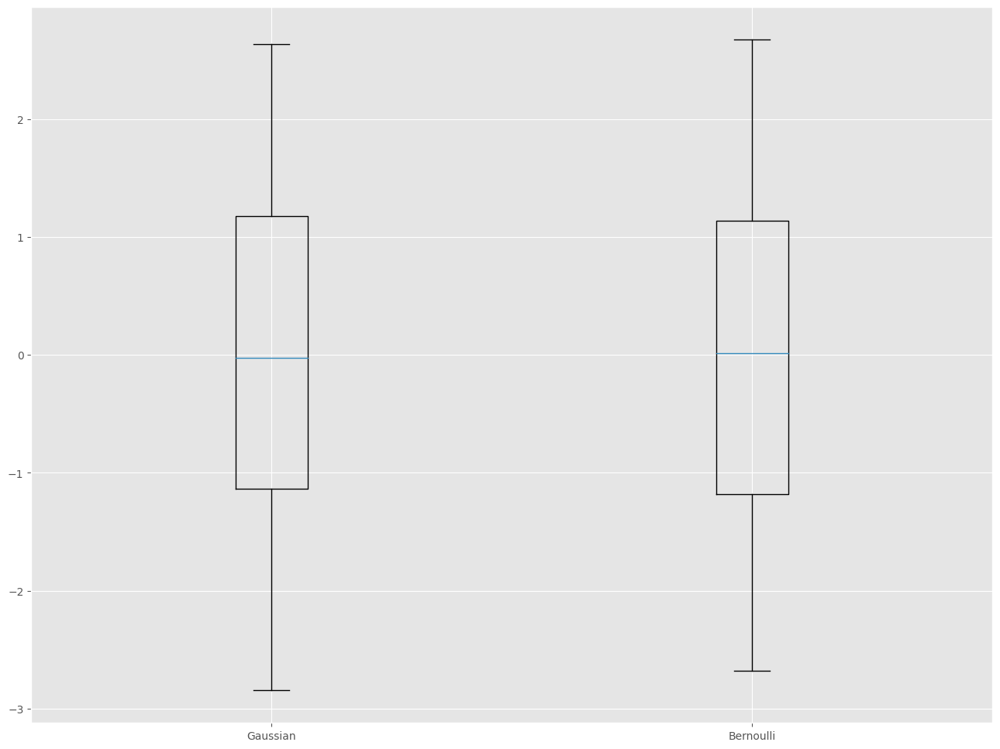

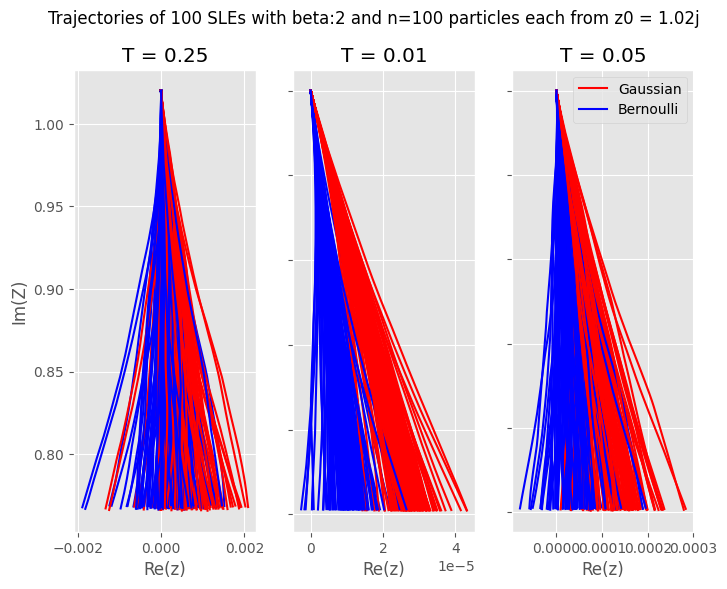

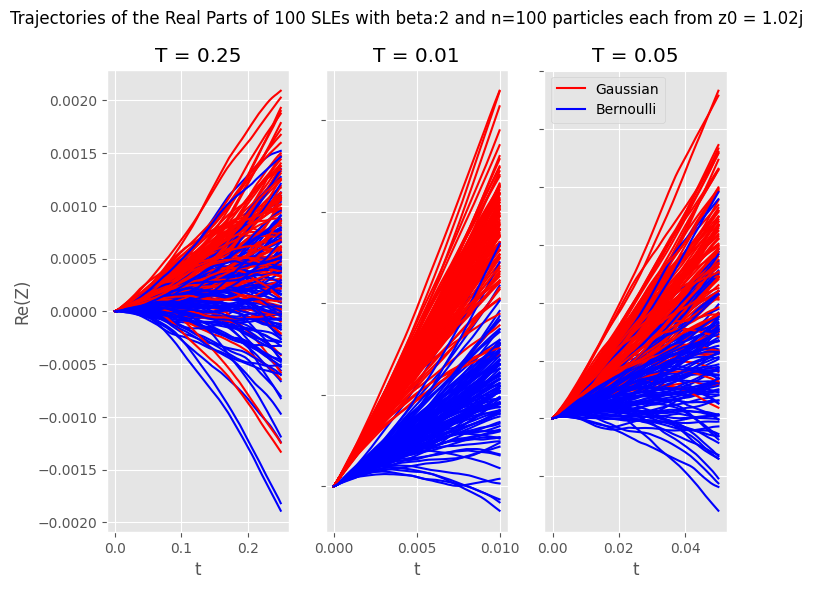

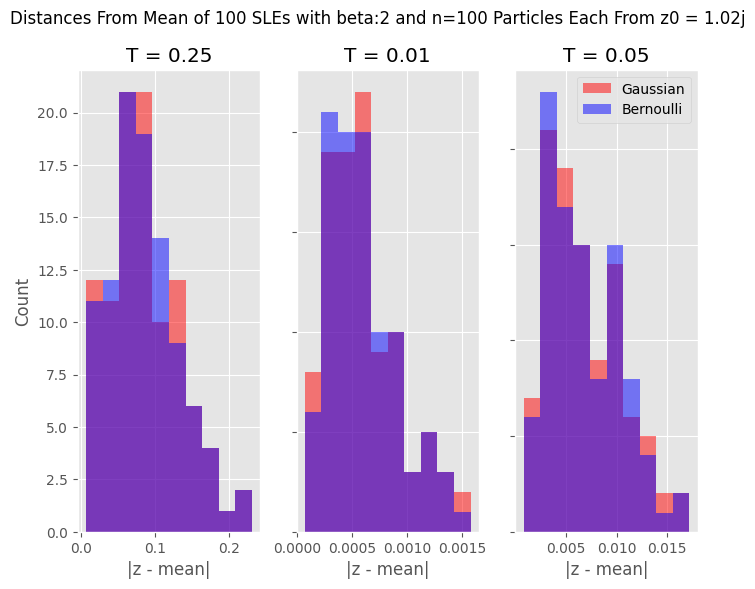

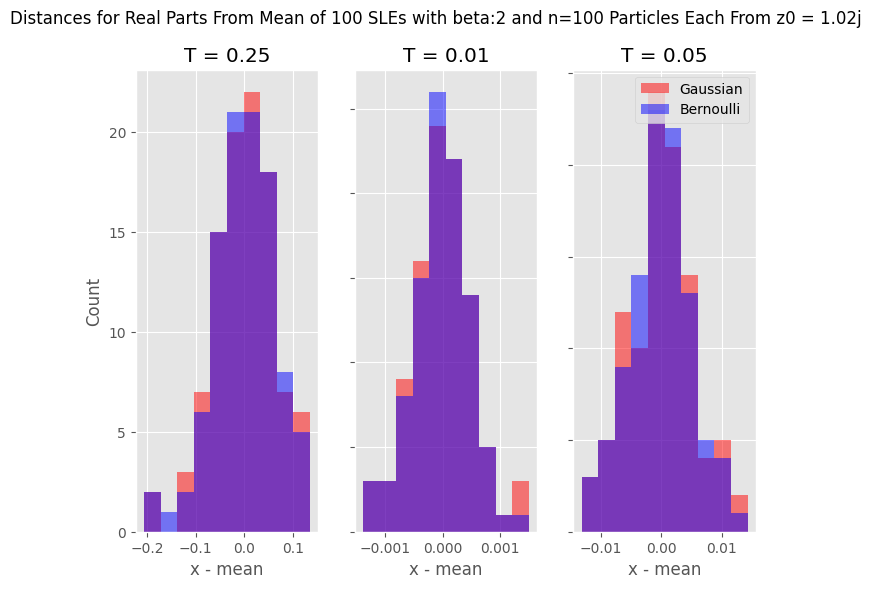

Are the two the same at T = 0.25?
KstestResult(statistic=0.03, pvalue=0.9999999999962054, statistic_location=(0.03462041866196962-0.031896770026296206j), statistic_sign=1)
Are the two the same at T = 0.01?
KstestResult(statistic=0.04, pvalue=0.999998821968263, statistic_location=(0.00022127595609411417+0.0003161239527926796j), statistic_sign=-1)
Are the two the same at T = 0.05?
KstestResult(statistic=0.04, pvalue=0.999998821968263, statistic_location=(-0.0019718036804572243-0.009922215366253706j), statistic_sign=-1)
Best Distribution: laplace_asymmetric(kappa=0.73, loc=0.07, scale=0.03)
SSE: 8696.471753825756
Best Distribution: laplace_asymmetric(kappa=0.73, loc=0.07, scale=0.03)
SSE: 9721.959049347608


<Figure size 1200x800 with 0 Axes>

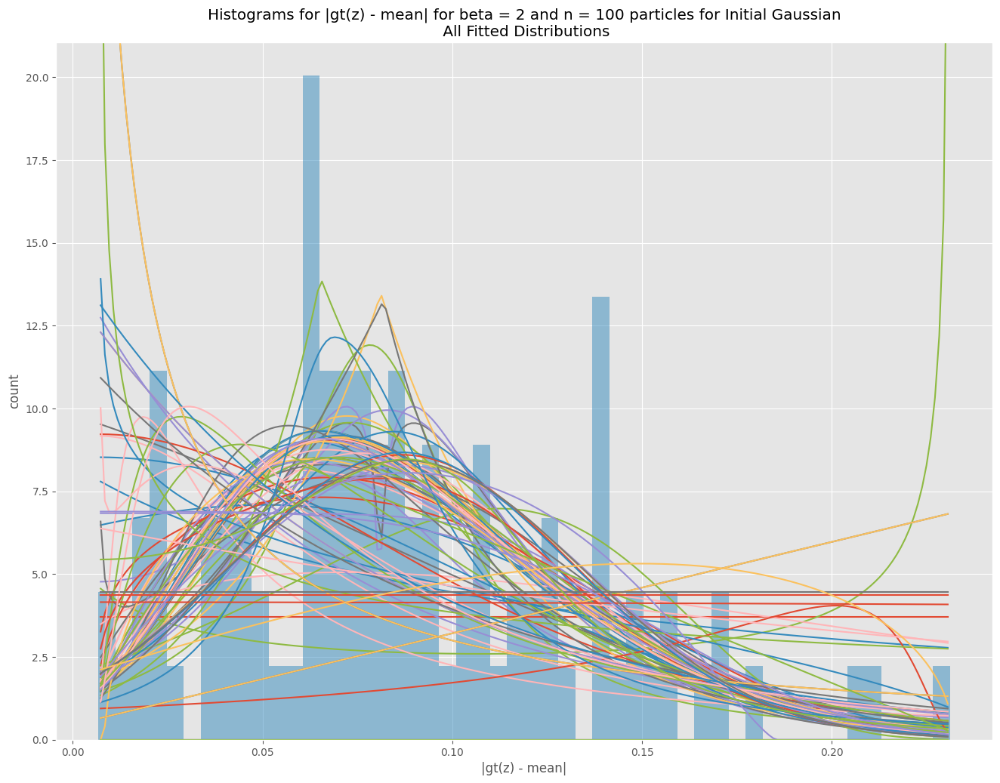

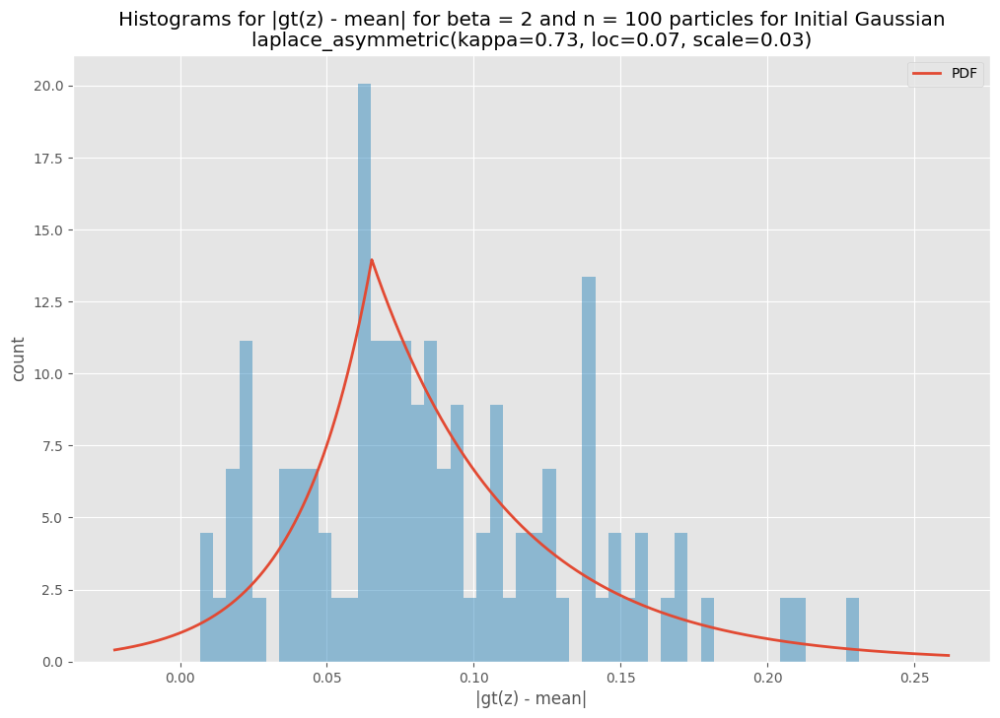

<Figure size 1200x800 with 0 Axes>

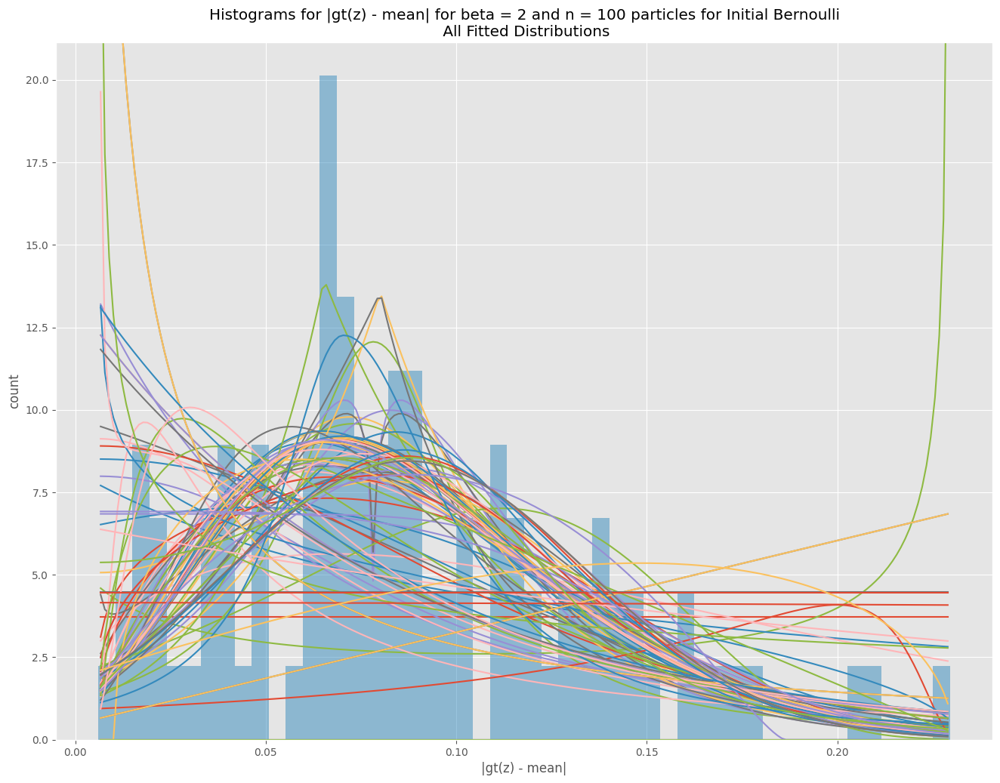

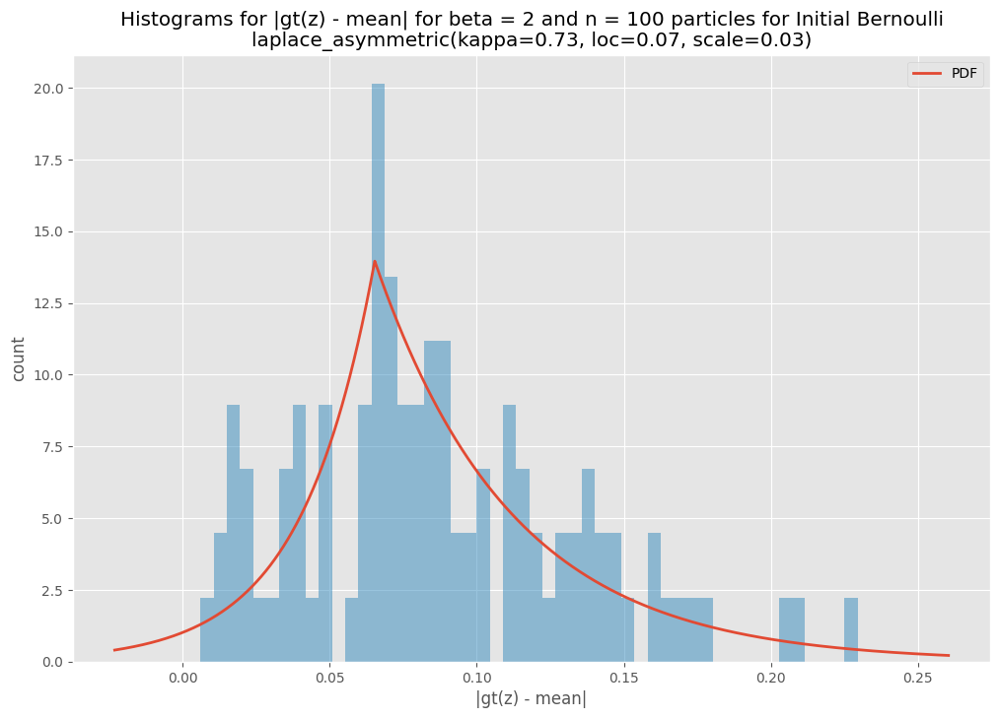

In [69]:
#Coupled SLE
beta = 2
num_experiments = 100
num_steps = 10000
T = 0.25
nscale = True
drift = False
E = 0
path = "experiments/FixedEnergyInspired/18/"
prevStart = 0
#parts = [10, 50, 100]
parts = [10, 50, 100]
#z0s = [0 + (0 + (2 * np.sqrt(T) + (0.02)))*1j, -1 + (0 + (2 * np.sqrt(T) + (0.02)))*1j, 1 + (0 + (2 * np.sqrt(T) + (0.02)))*1j]
z0 = 0 + (0 + (2 * np.sqrt(T) + (0.02)))*1j
for i in range(len(parts)):
    nParts = parts[i]
    if(1/nParts > 0.25 or 5/nParts > 0.25):
        times = [0.1, 0.2]
    else:
        times = [(1/nParts), (5/nParts)]
    x01 = WM(nParts, beta=beta)[0]
    x02 = WM(nParts, dist="bernoulli", beta=beta)[0]
    plt.boxplot([x01, x02], labels=["Gaussian", "Bernoulli"])
    plt.savefig(path + "BoxPlot_" + str(nParts))
    finals1, finals2, shorts1, shorts2 = doExperimentsTimes(beta, nParts, num_experiments, num_steps, T, x01, x02, z0, times, imgpath=path, figsize=(8, 6), plotReal=True, nscale=nscale, drift=drift) #+ str(prevStart + i)
    sample_mean1 = np.mean(finals1)
    sample_mean2 = np.mean(finals2)
    spreads1 = nParts * np.abs((finals1 - sample_mean1)) if nscale else np.abs((finals1 - sample_mean1))
    spreads2 = nParts * np.abs((finals2 - sample_mean2)) if nscale else np.abs((finals2 - sample_mean2))
    
    plotFit(spreads1, "Histograms for |gt(z) - mean| for beta = " + str(beta) + " and n = " + str(nParts) + " particles for Initial Gaussian", "|gt(z) - mean|", "count", path + str(beta) + "_" + str(nParts))
    plotFit(spreads2, "Histograms for |gt(z) - mean| for beta = " + str(beta) + " and n = " + str(nParts) + " particles for Initial Bernoulli", "|gt(z) - mean|", "count", path + str(beta) + "_" + str(nParts))
    plt.show()

    #z0 = -0.02 + (0 + (2 * nParts * np.sqrt(T) + (0.02)))*1j
    #finals1, final2, shorts1, shorts2 = doExperimentsTimesEnergy(beta, nParts, num_experiments, num_steps, T, x01, x02, z0, times, E, imgpath=path + str(prevStart + i) + "_", figsize=(8, 6), plotReal=True, nscale=nscale)

In [11]:
def makeX0(n, dist):
    if n % 2 == 0:
        x_0 = []
        a = dist/2
        x_0.append(a)
        x_0.append(-1 * a)
        for i in range(1, int((n / 2))):
            x_0.append(a + i*dist)
            x_0.append(-1 * (a + i*dist))
    else:
        x_0 = [0.0]
        for i in range(1, int(((n + 1) / 2))):
            x_0.append(i * dist)
            x_0.append(-1 * i * dist)
    return x_0

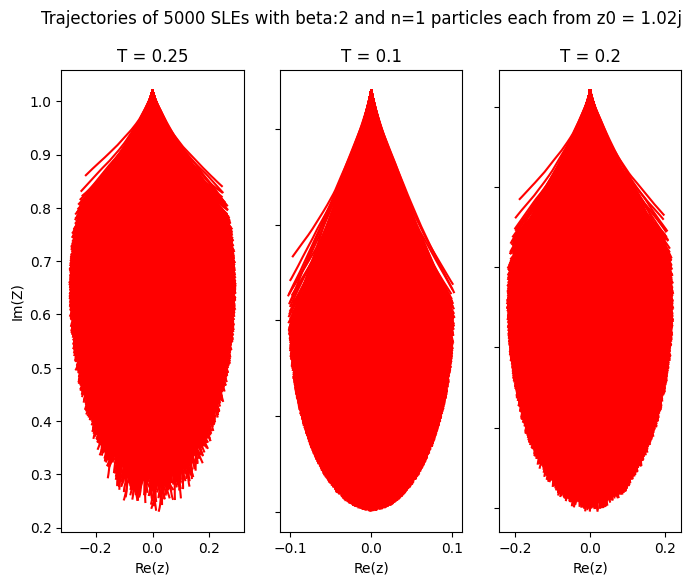

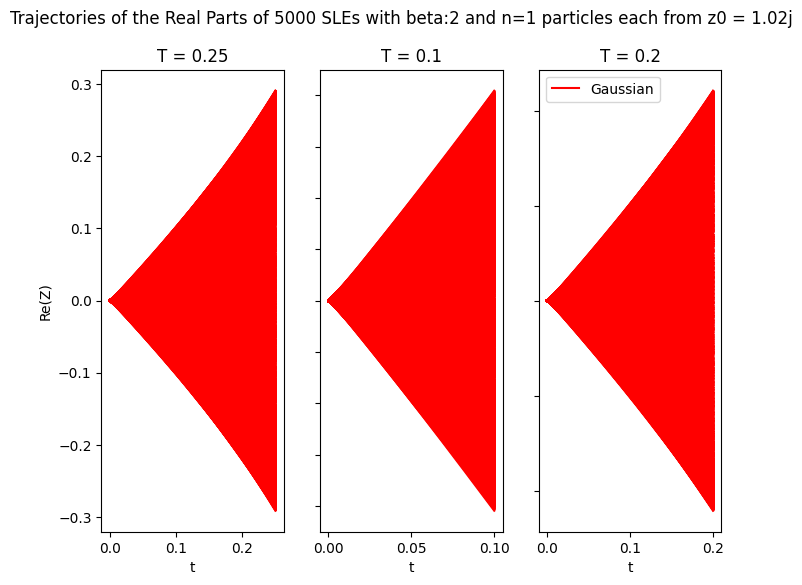

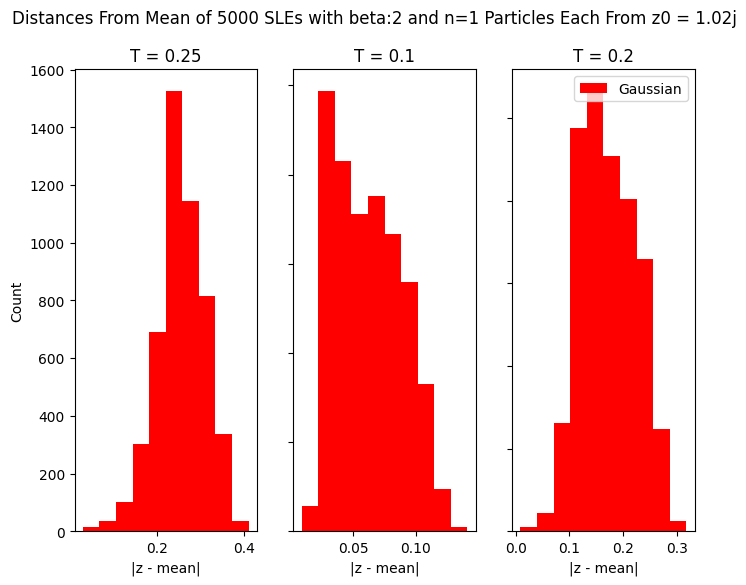

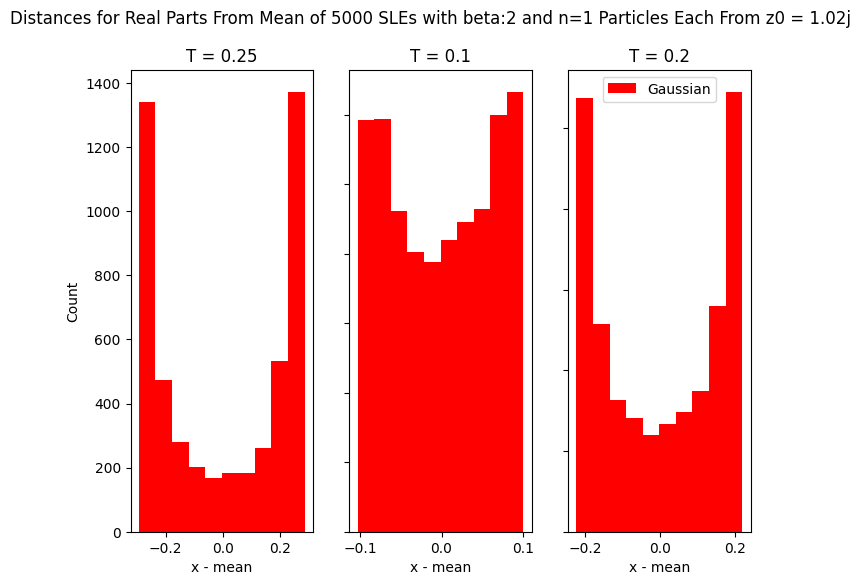

beta: 2 close
Best Distribution: wrapcauchy(c=0.55, loc=-0.29, scale=0.09)
MSE: 0.0018598864733944517


<Figure size 1200x800 with 0 Axes>

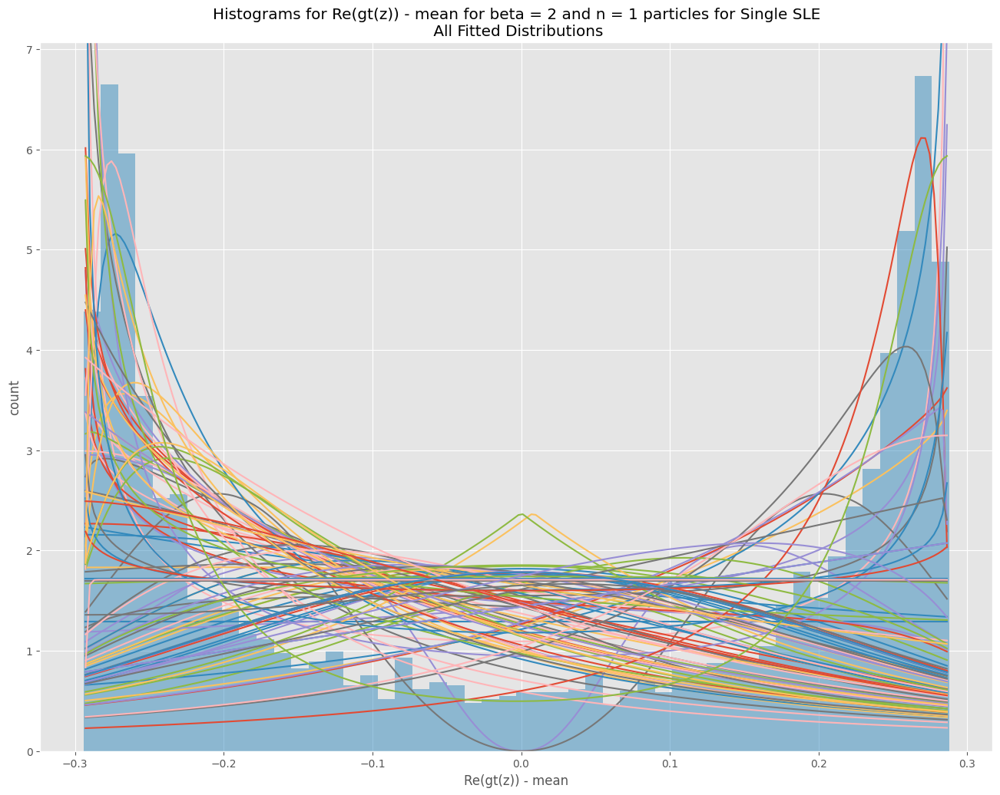

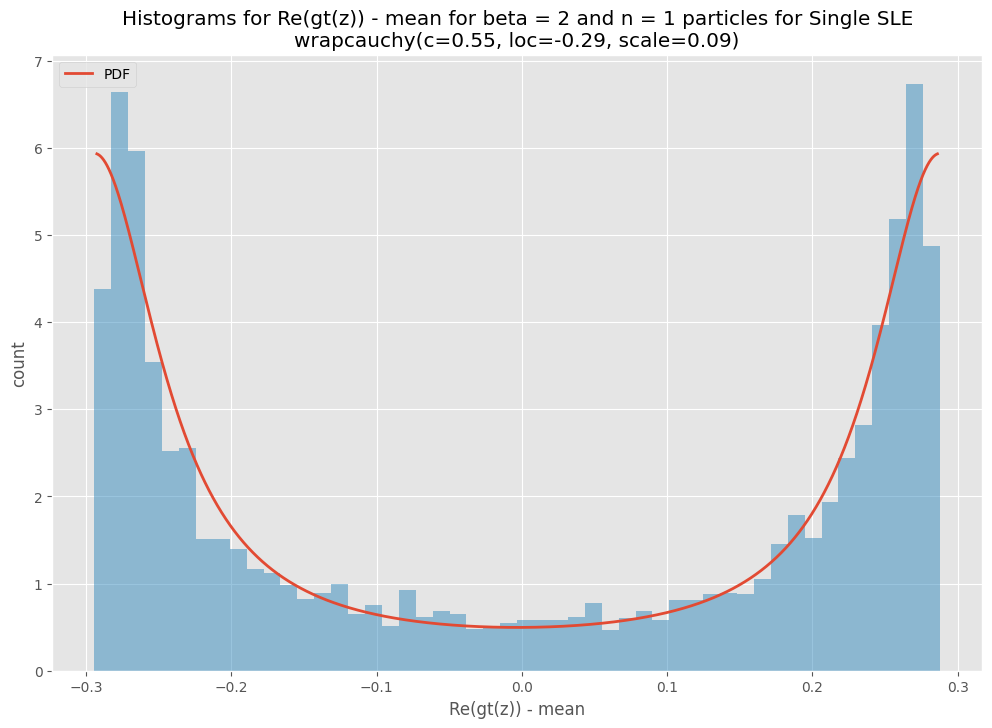

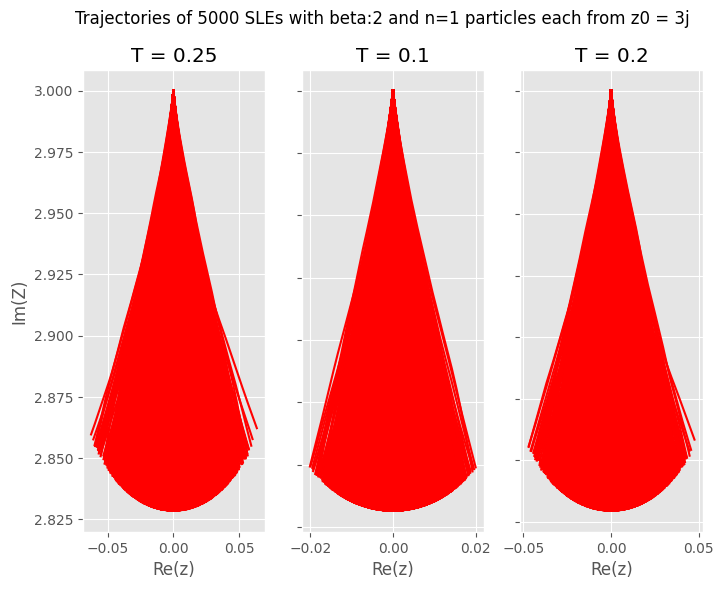

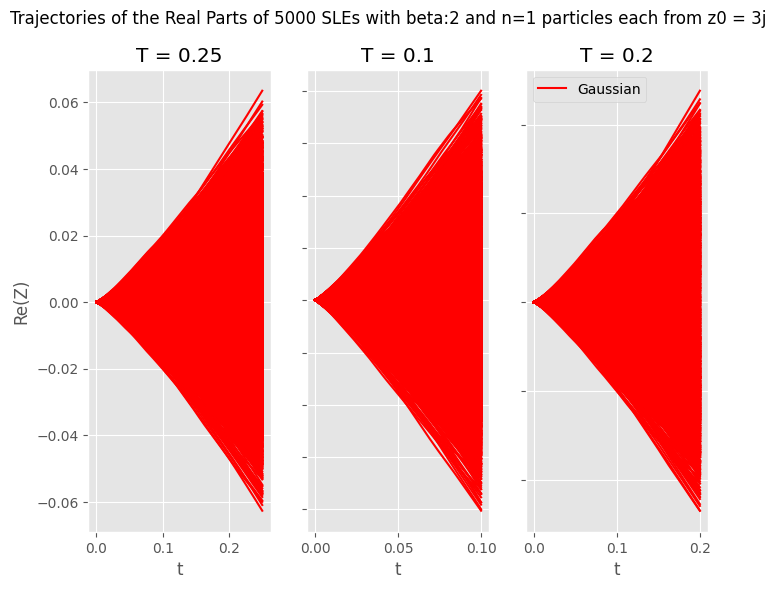

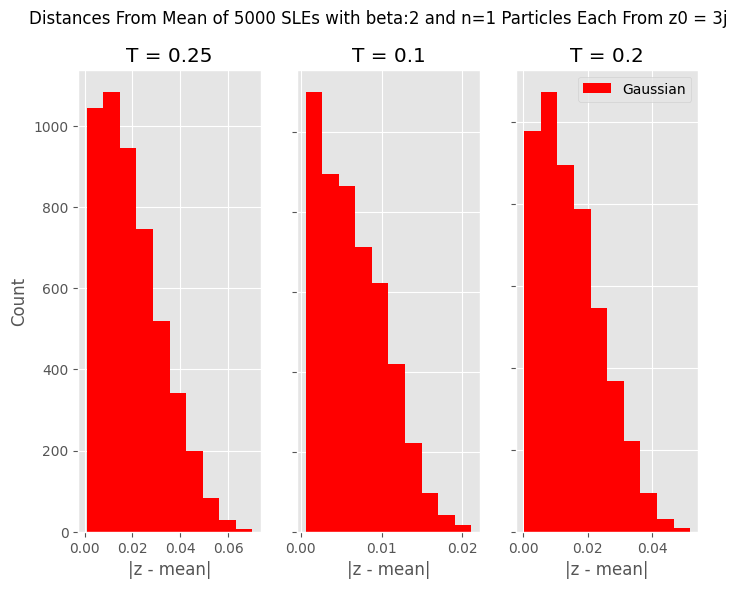

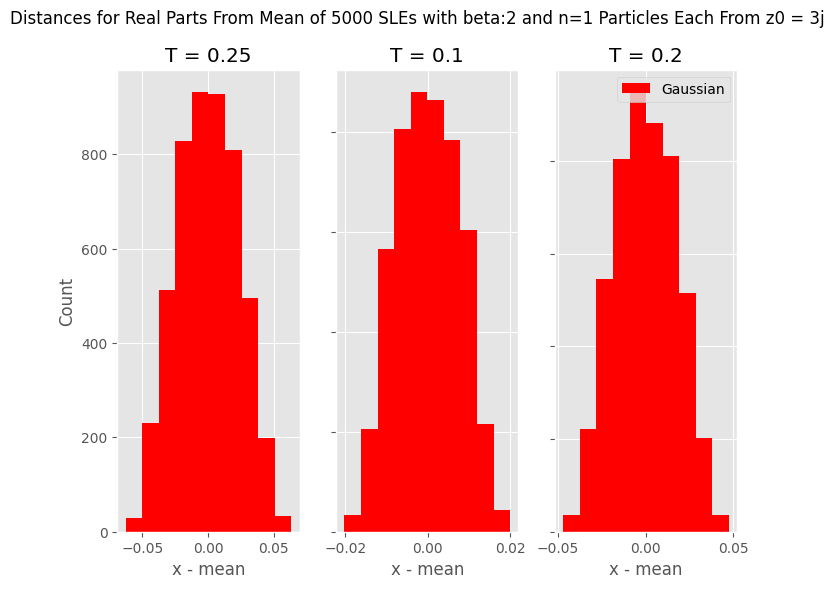

beta: 2 far
Best Distribution: gennorm(beta=3.13, loc=0.00, scale=0.04)
MSE: 0.004338604813120143


<Figure size 1200x800 with 0 Axes>

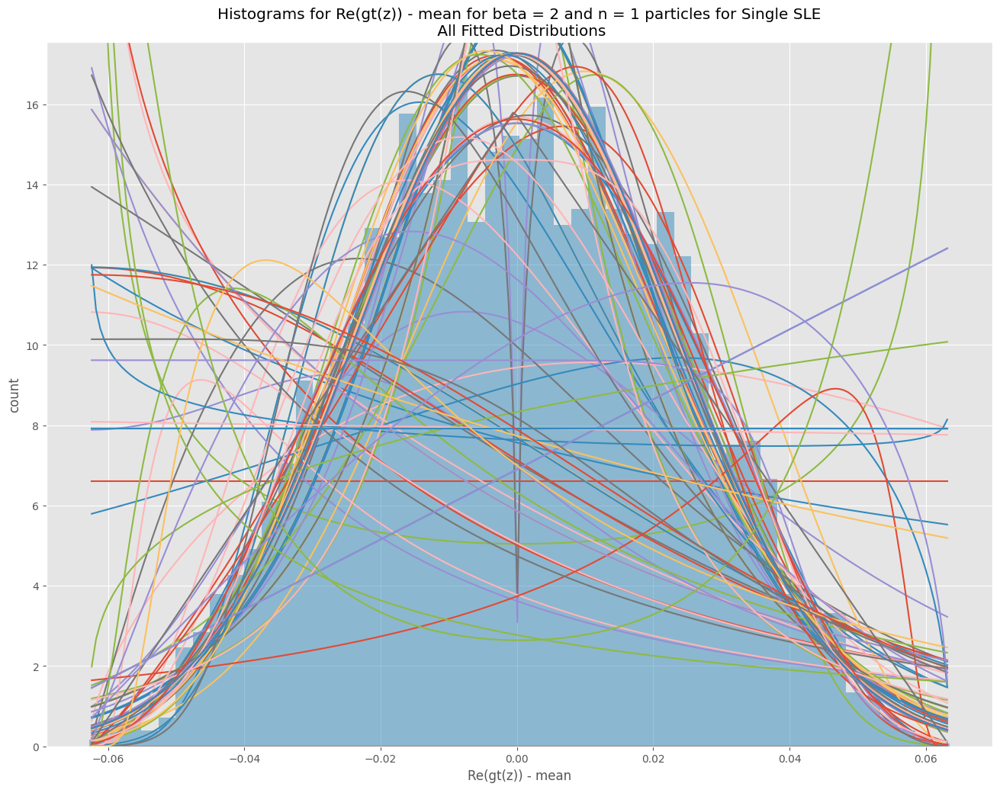

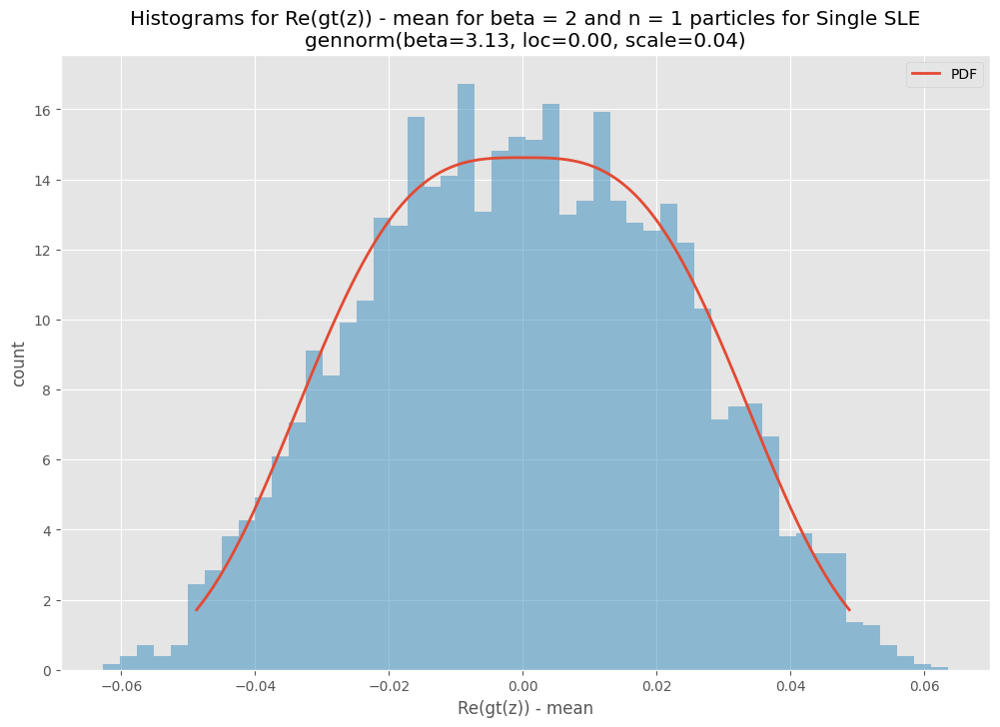

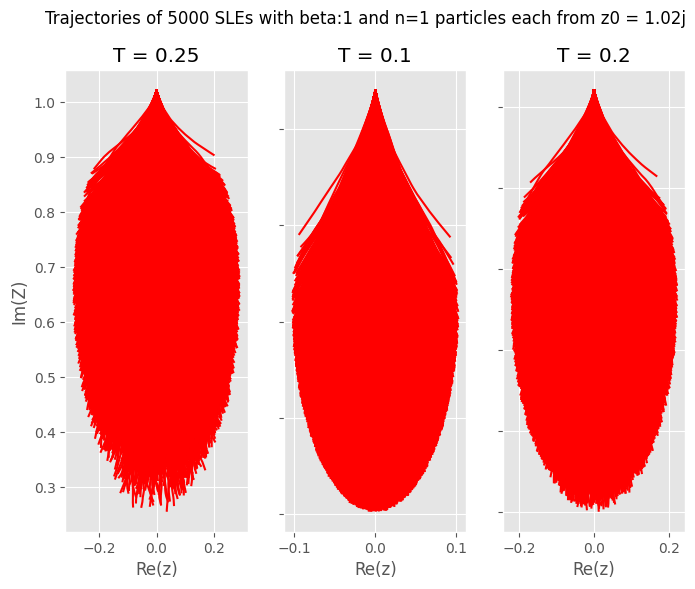

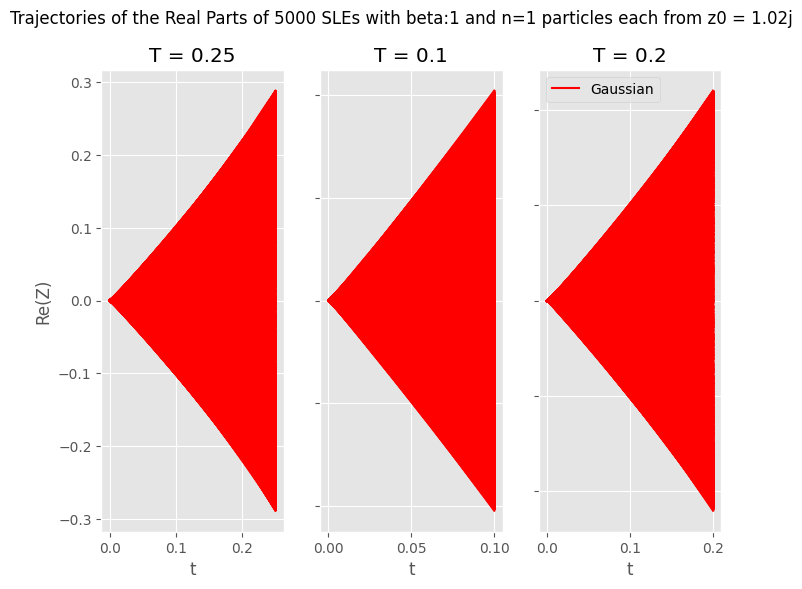

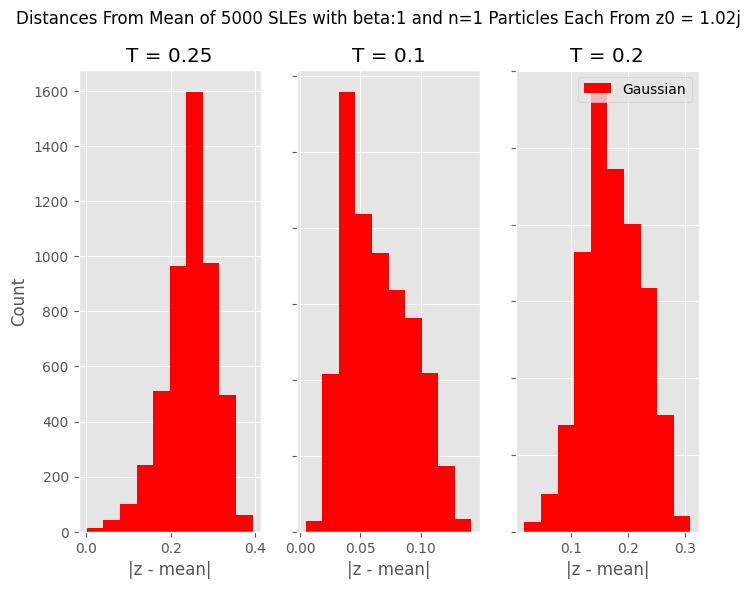

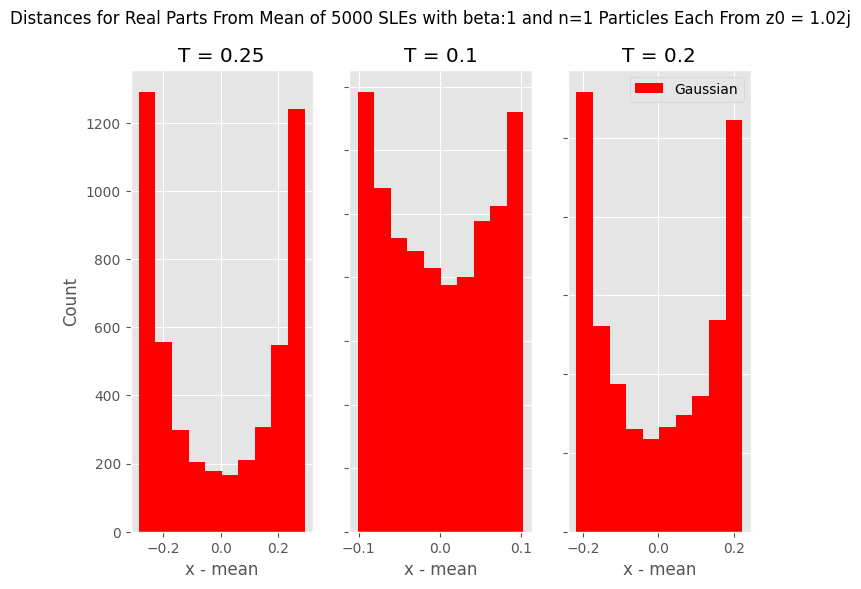

beta: 1 close
Best Distribution: wrapcauchy(c=0.49, loc=-0.29, scale=0.09)
MSE: 0.0018959354620451012


<Figure size 1200x800 with 0 Axes>

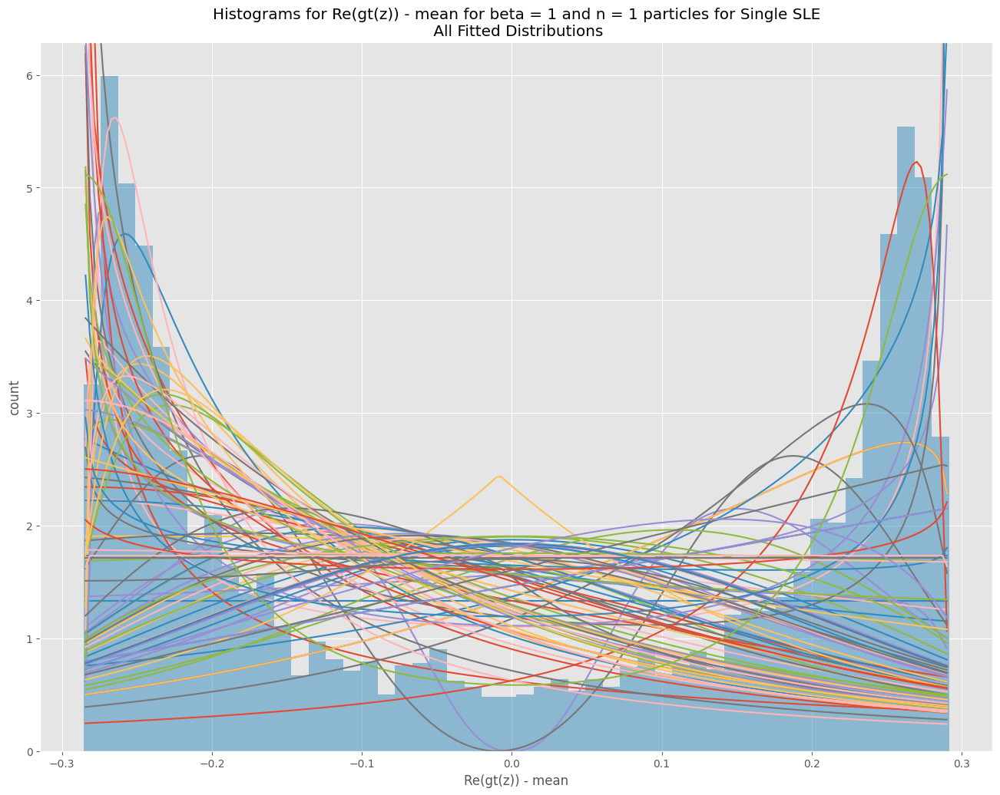

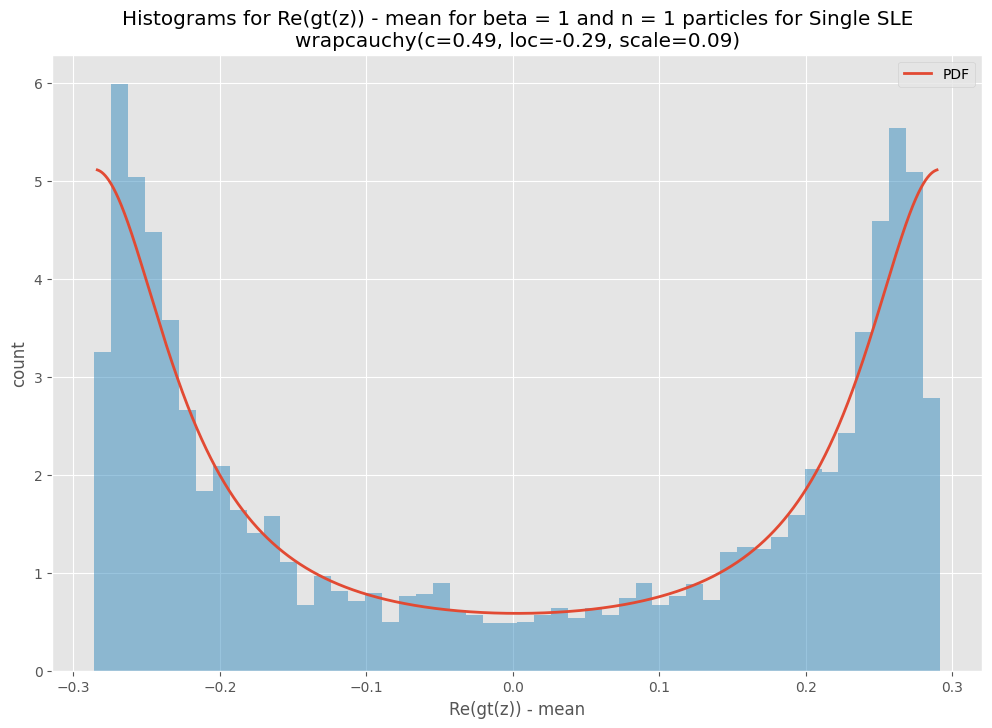

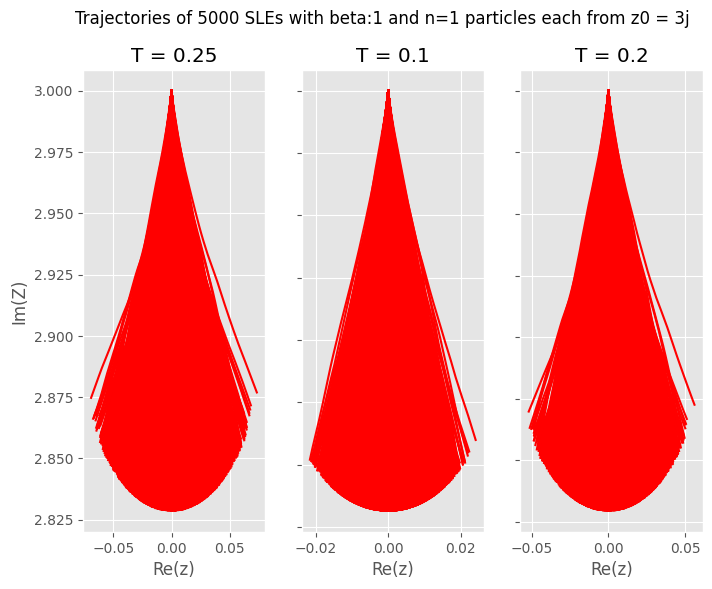

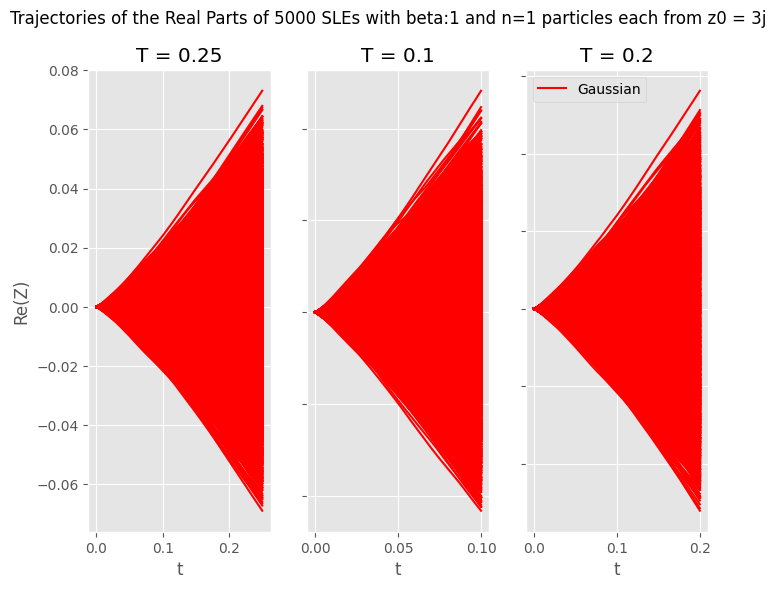

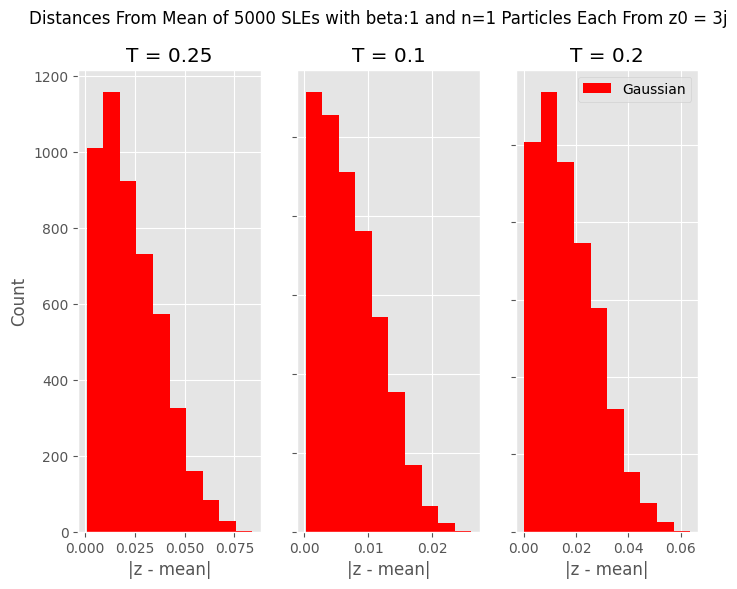

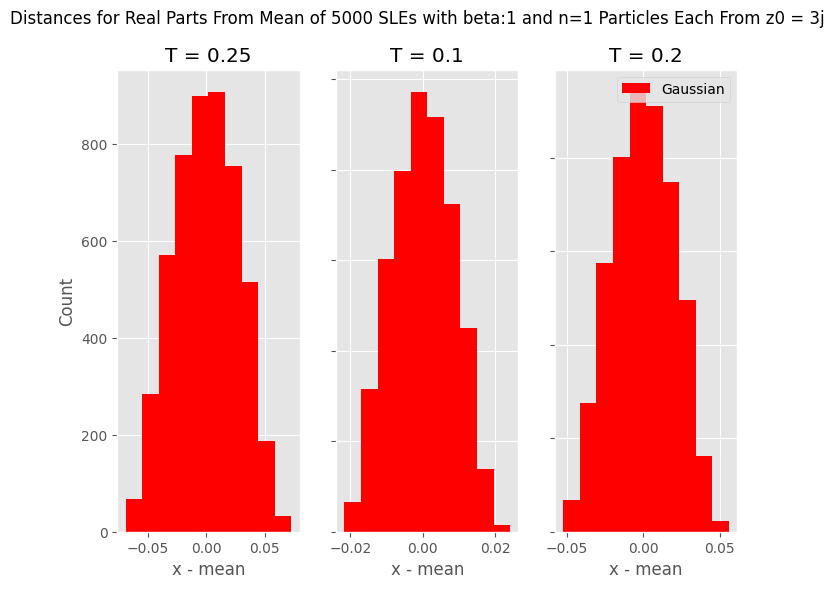

beta: 1 far
Best Distribution: johnsonsb(a=-0.00, b=1.30, loc=-0.08, scale=0.16)
MSE: 0.004073016937128694


<Figure size 1200x800 with 0 Axes>

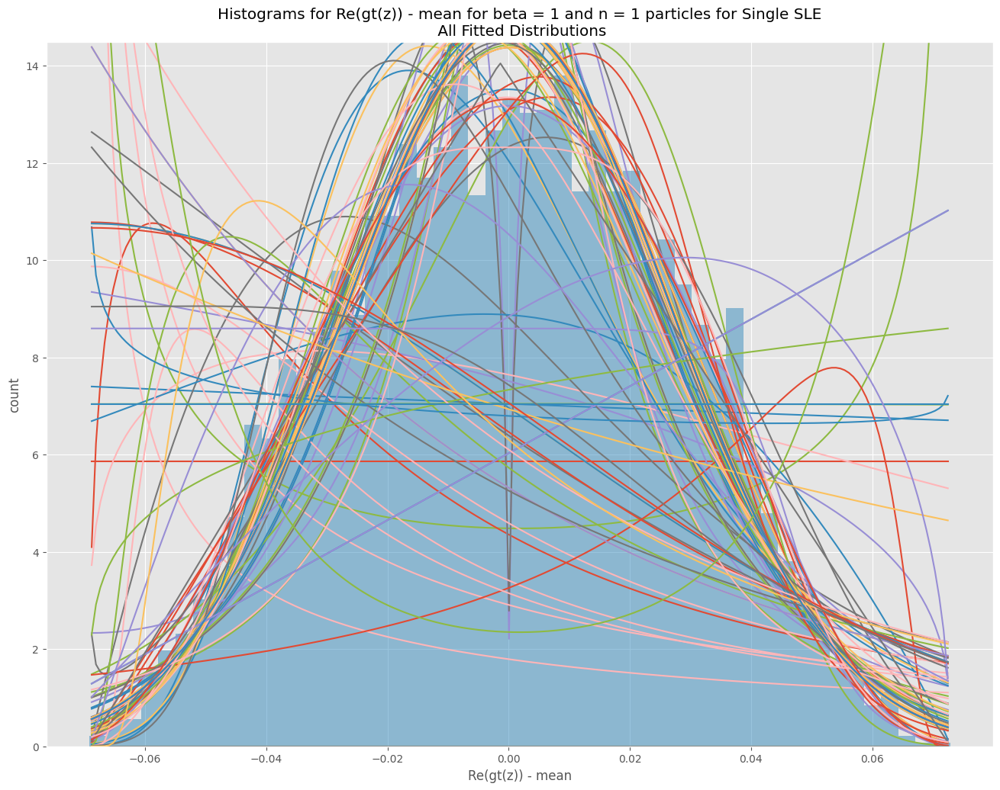

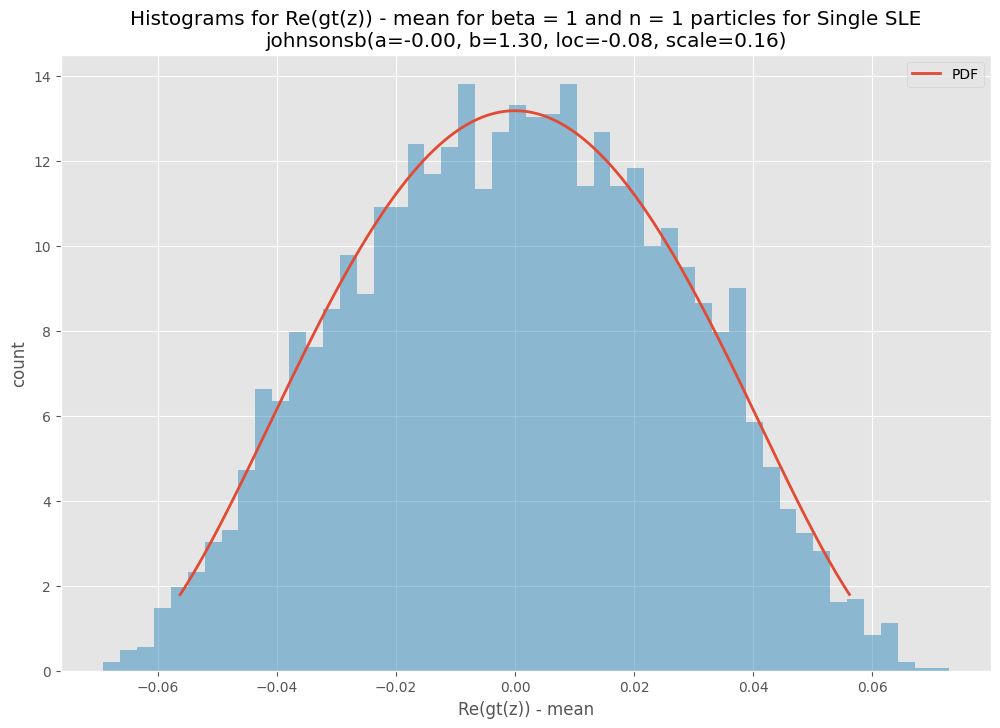

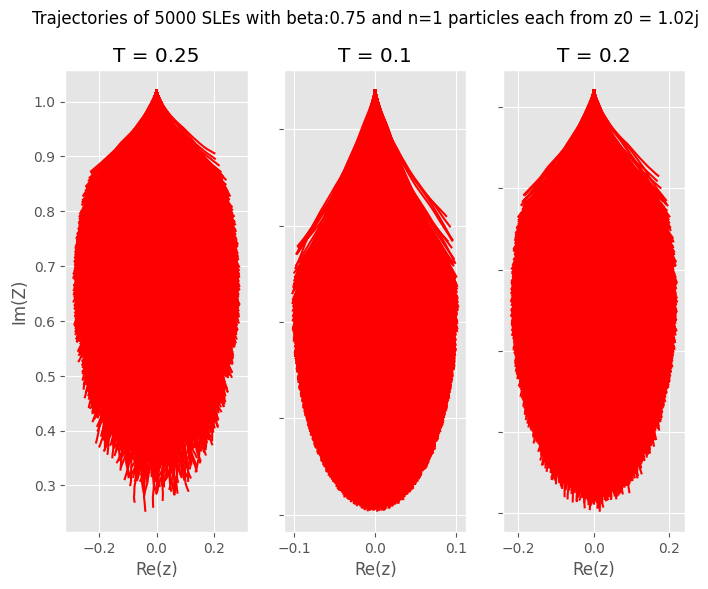

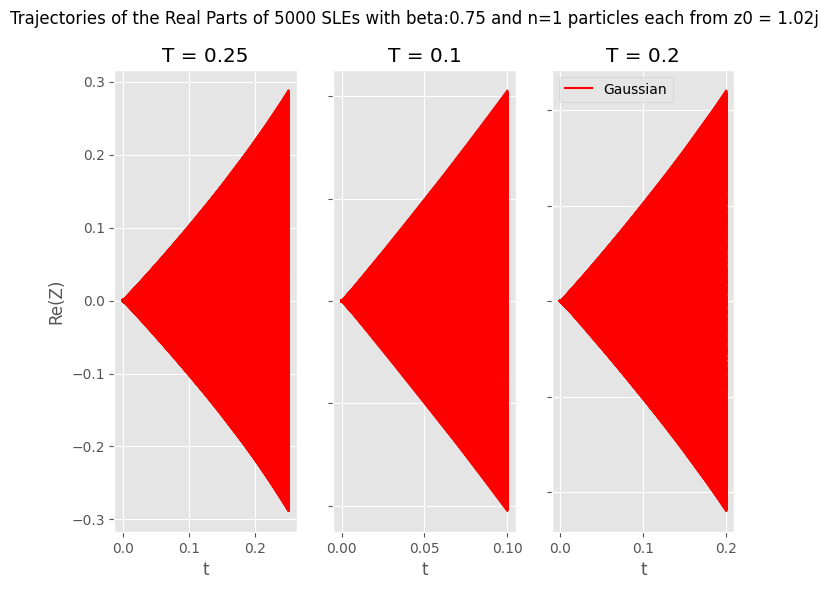

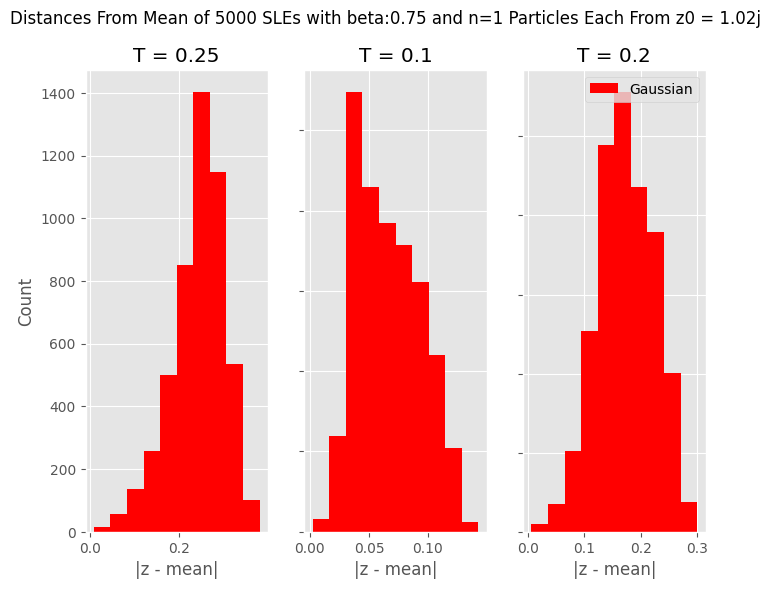

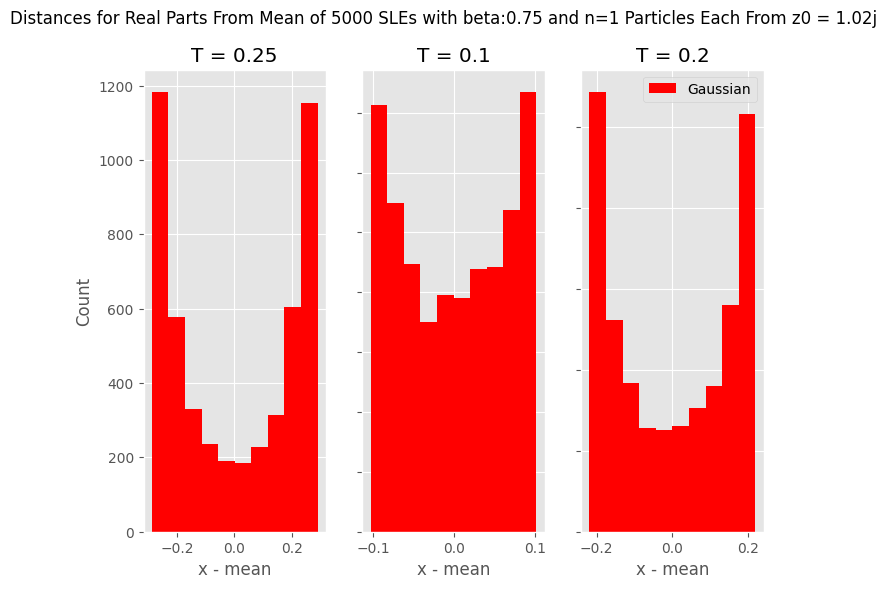

beta: 0.75 close
Best Distribution: wrapcauchy(c=0.45, loc=-0.29, scale=0.09)
MSE: 0.0019264334747445796


<Figure size 1200x800 with 0 Axes>

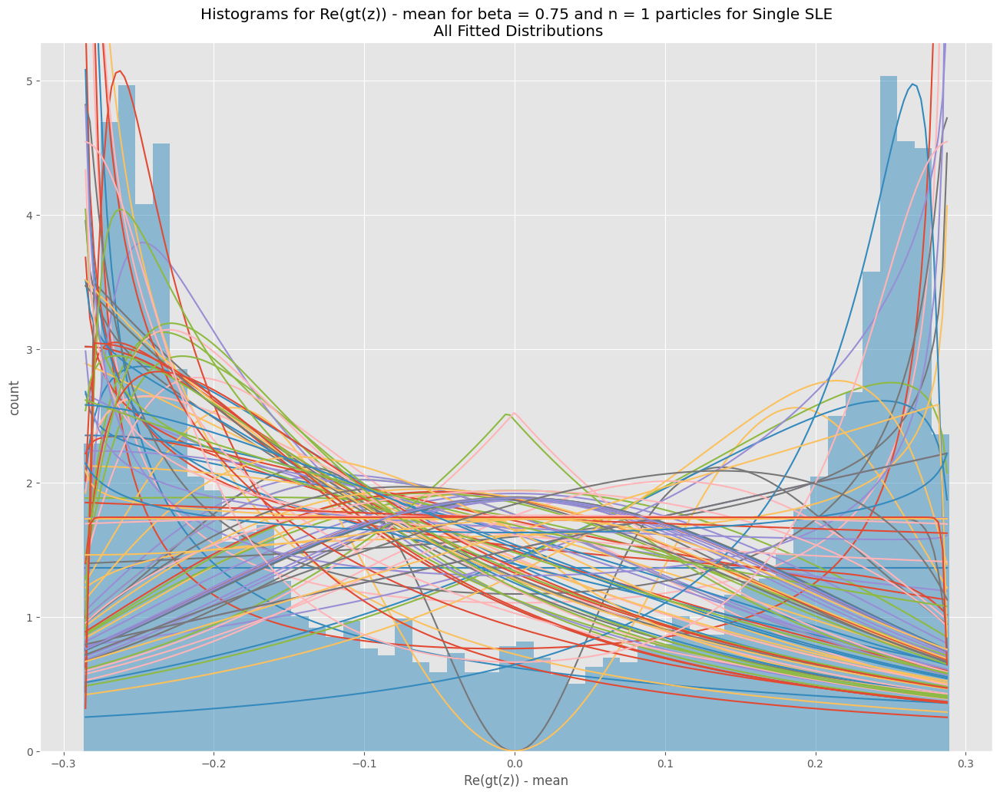

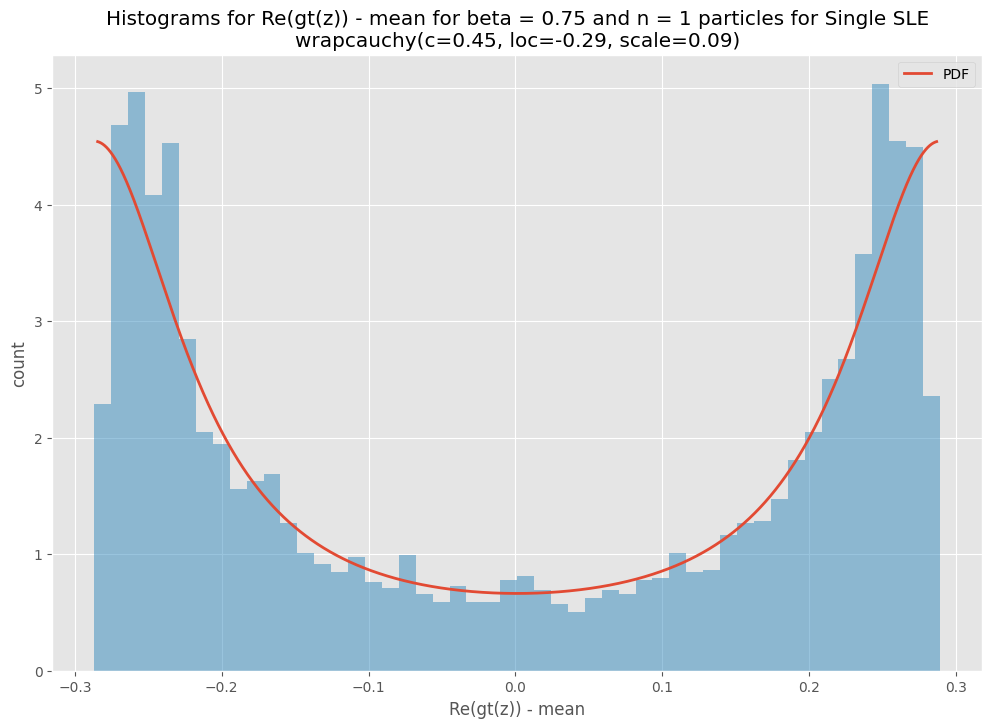

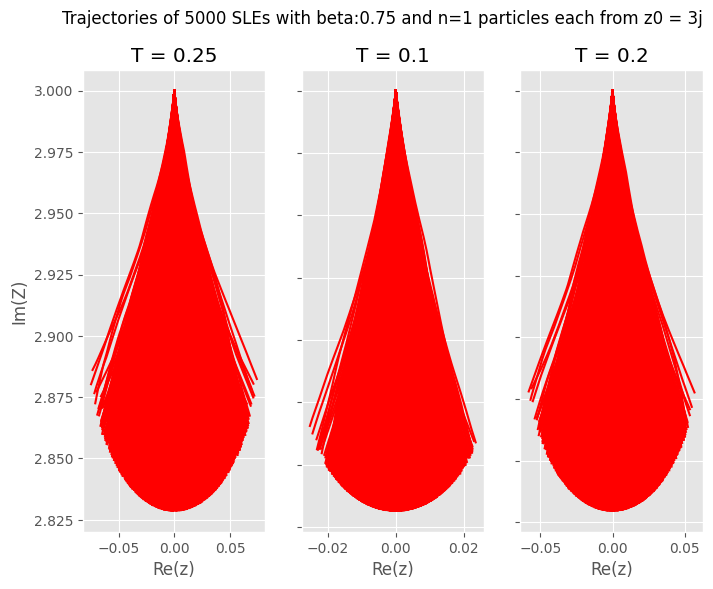

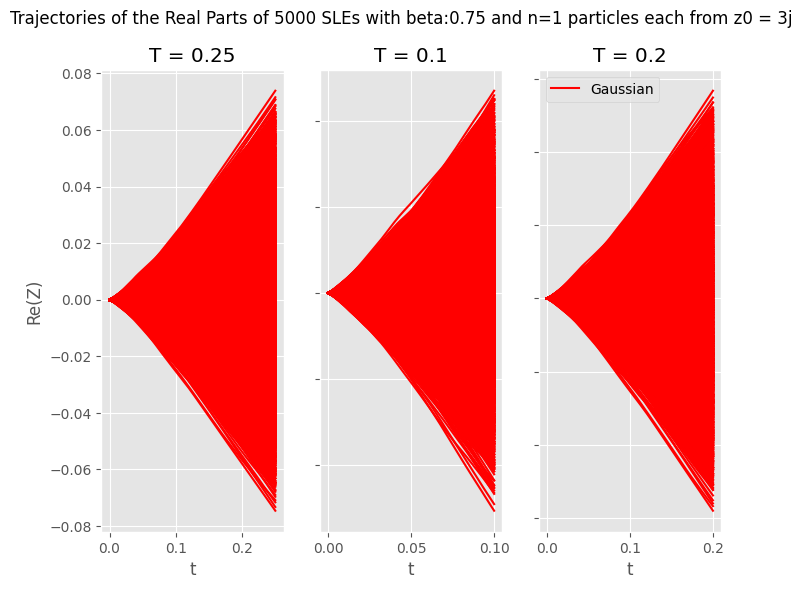

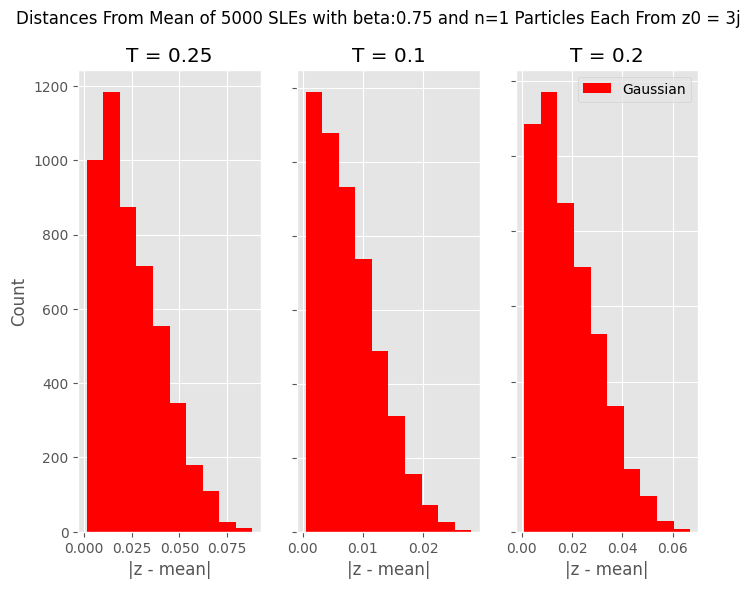

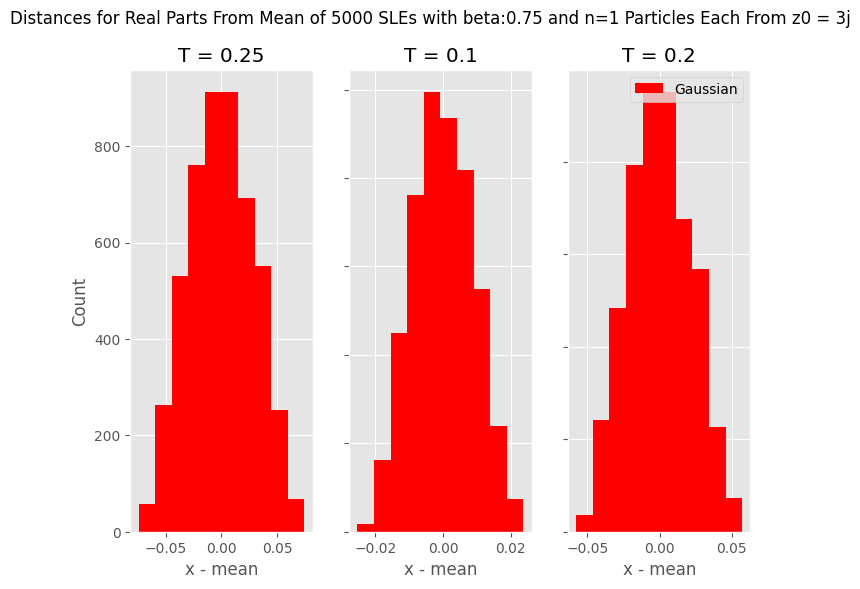

beta: 0.75 far
Best Distribution: beta(a=3.01, b=3.08, loc=-0.08, scale=0.15)
MSE: 0.004022937475350097


<Figure size 1200x800 with 0 Axes>

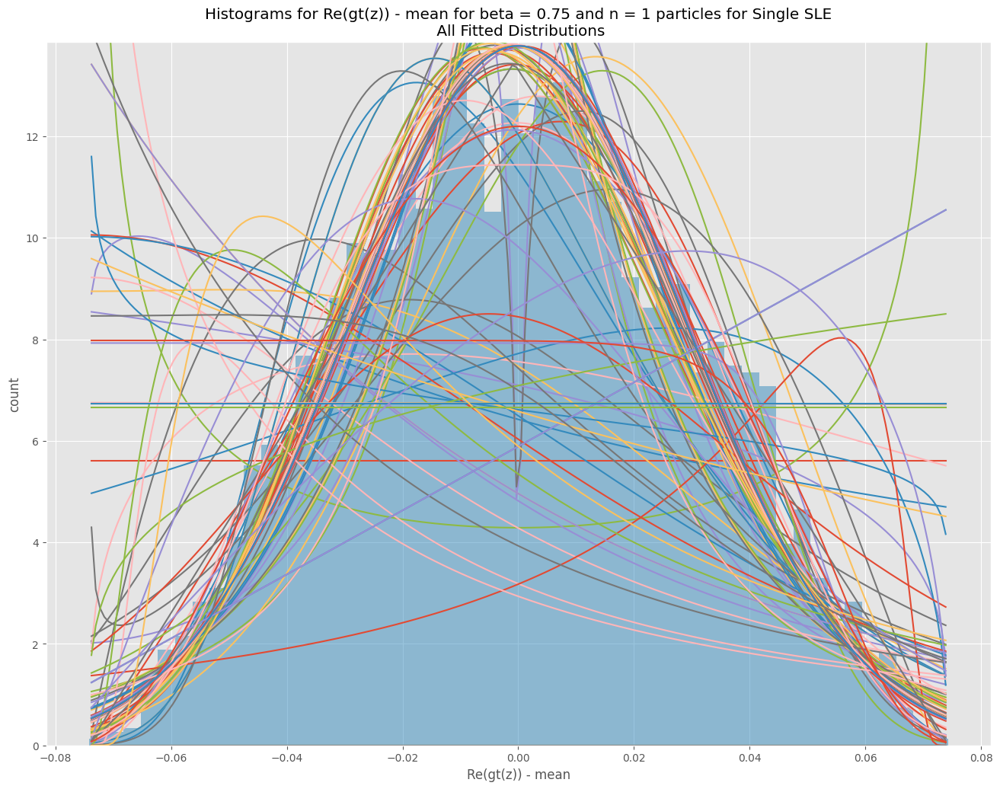

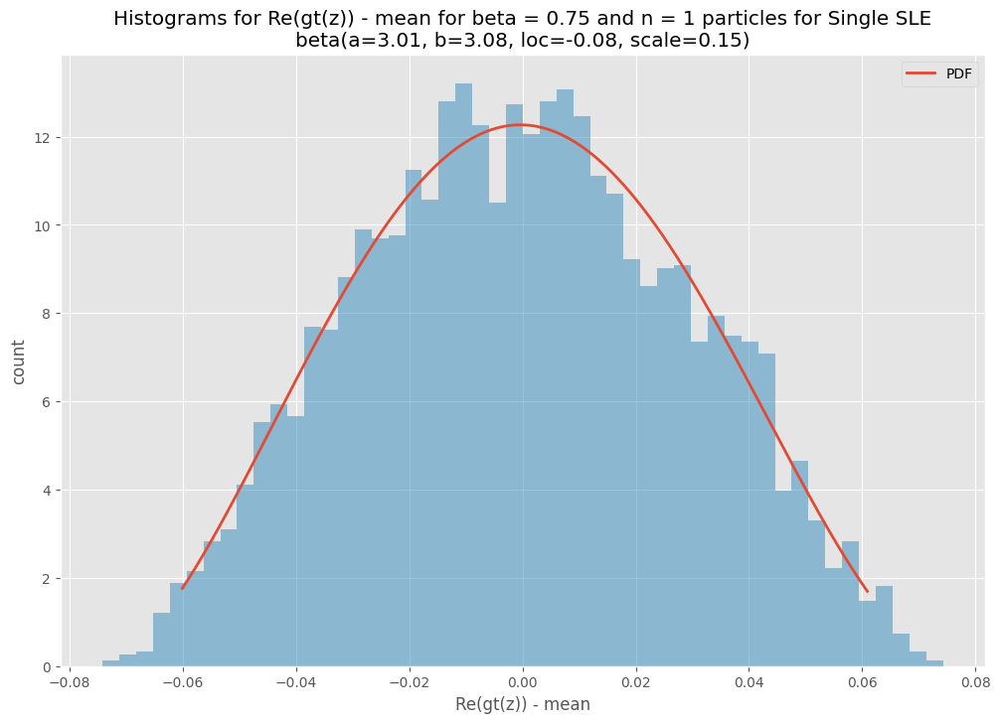

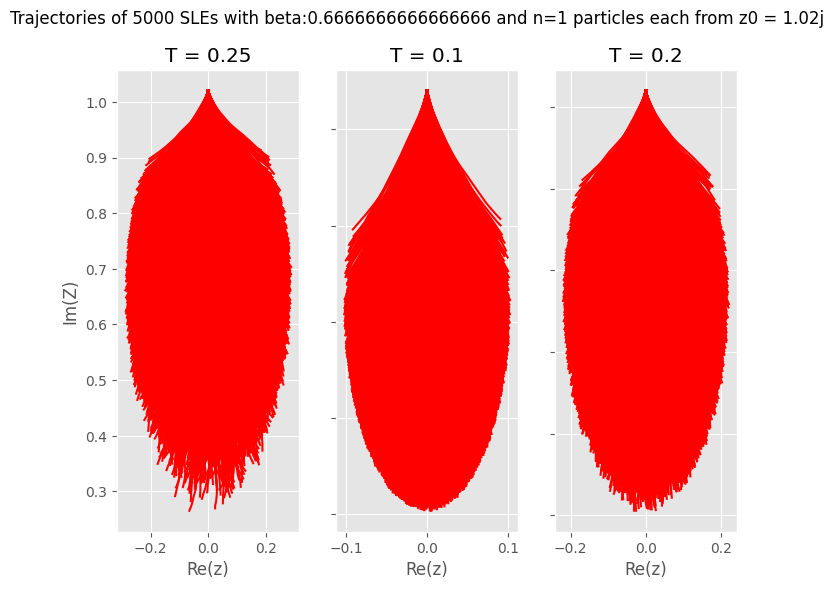

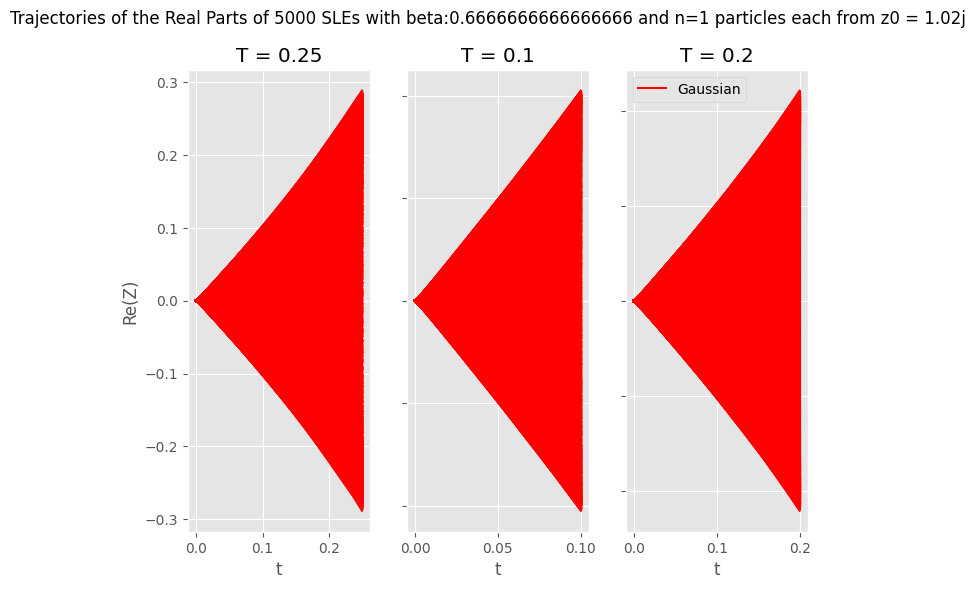

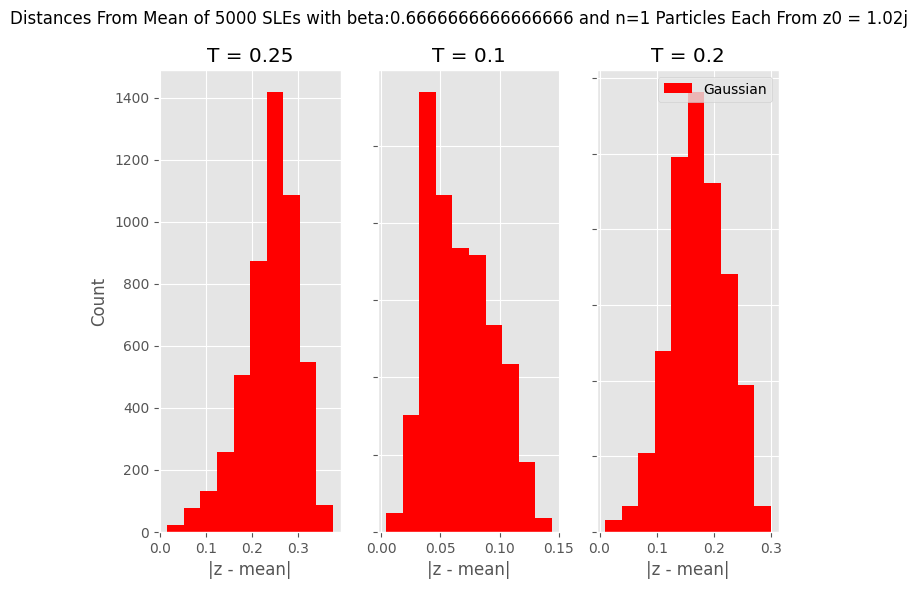

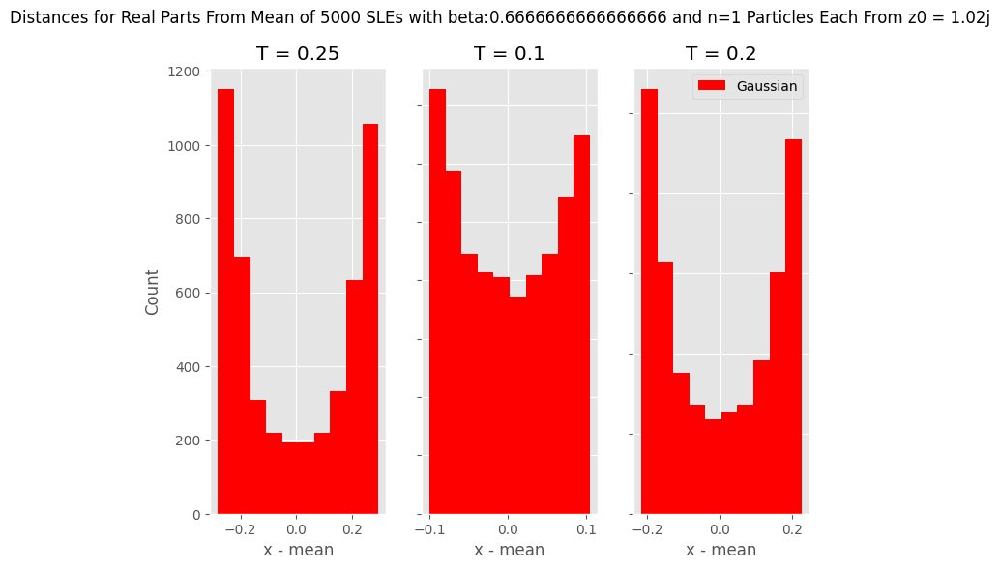

beta: 0.6666666666666666 close
Best Distribution: wrapcauchy(c=0.43, loc=-0.28, scale=0.09)
MSE: 0.0021881029149193685


<Figure size 1200x800 with 0 Axes>

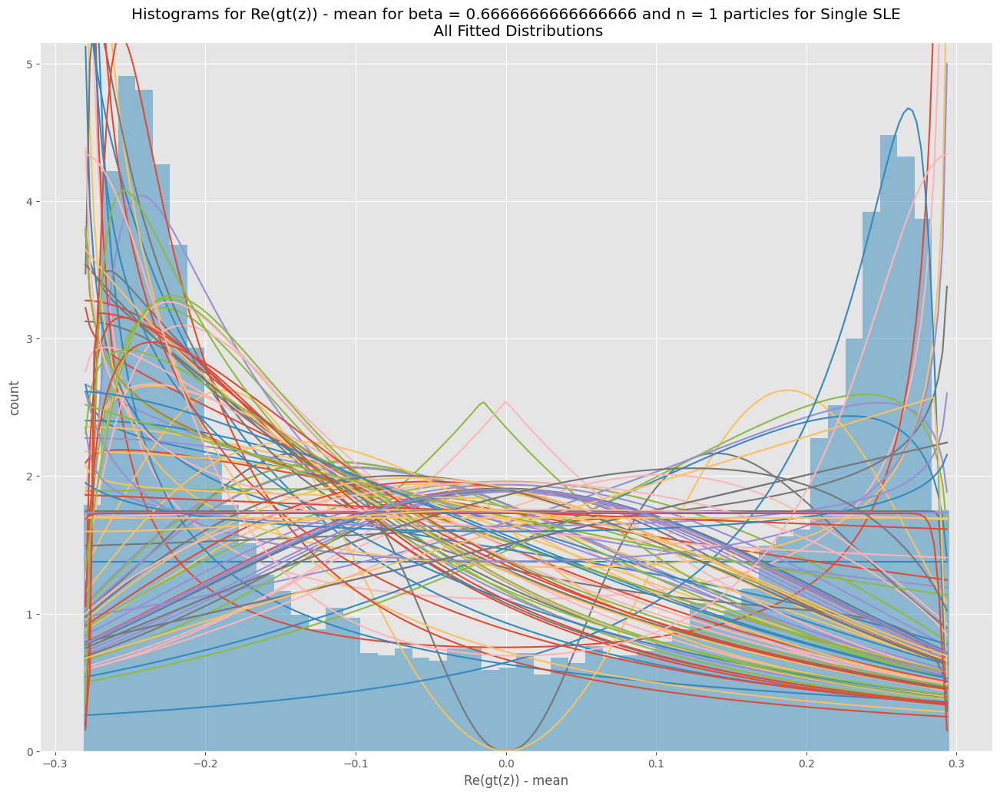

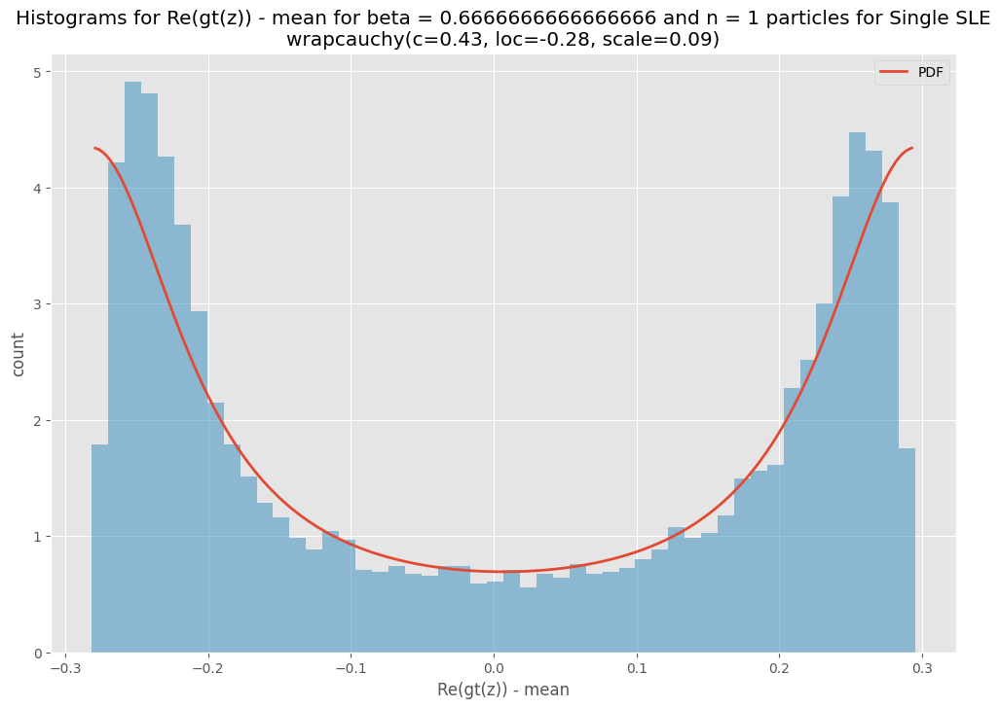

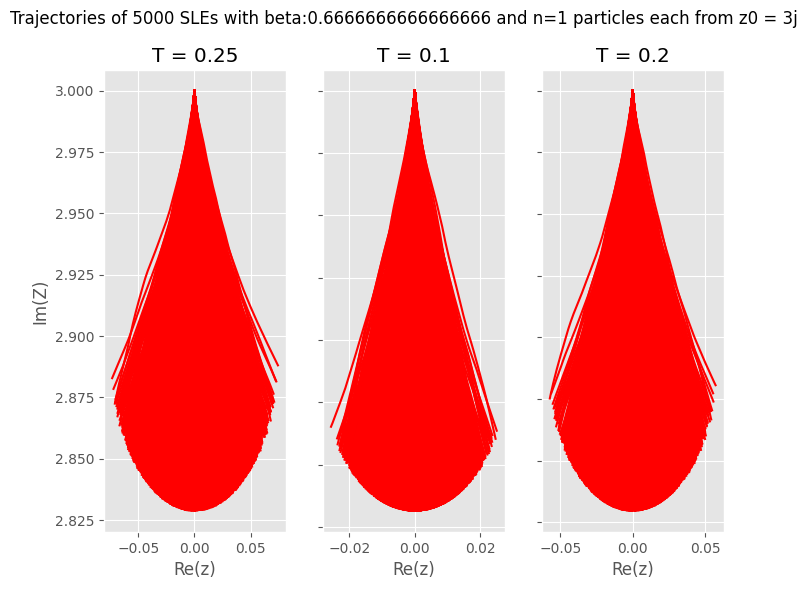

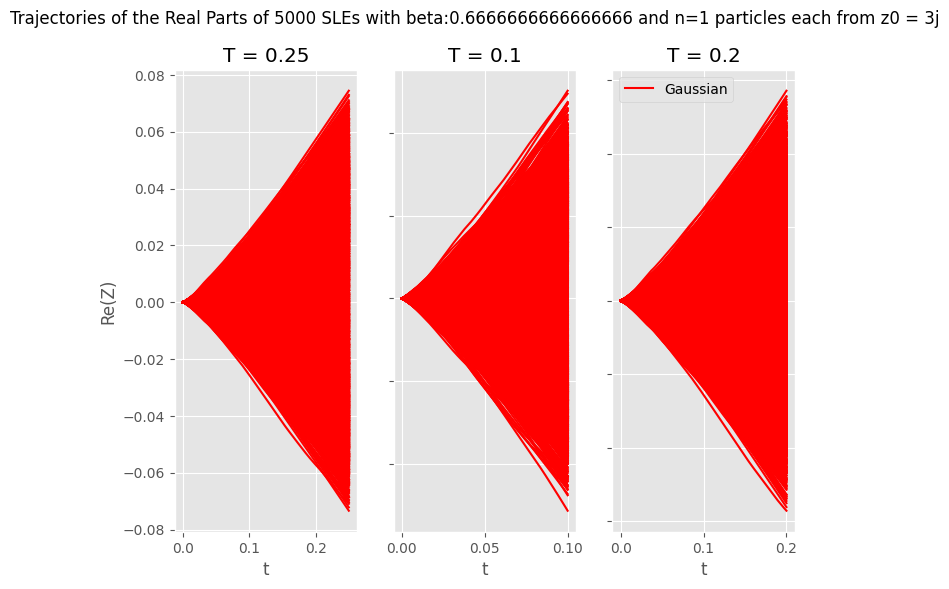

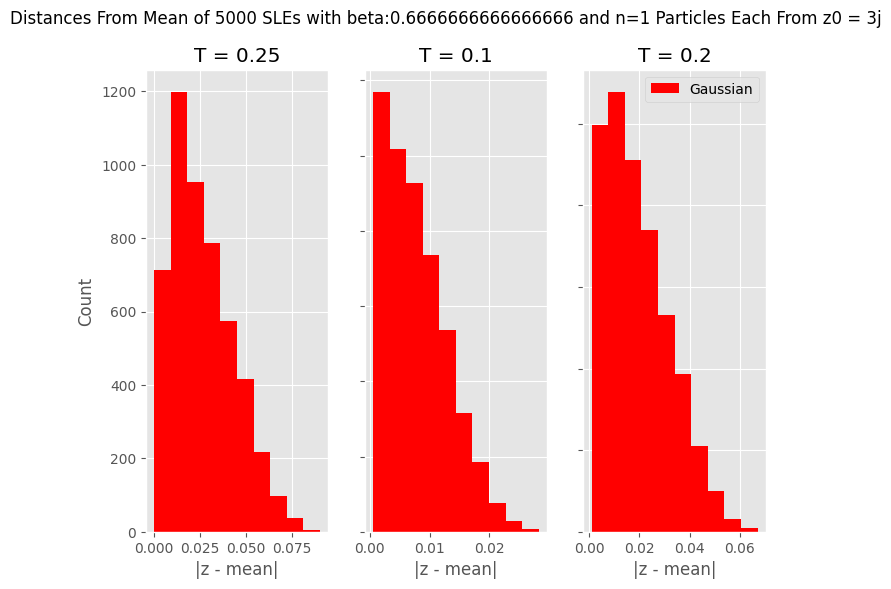

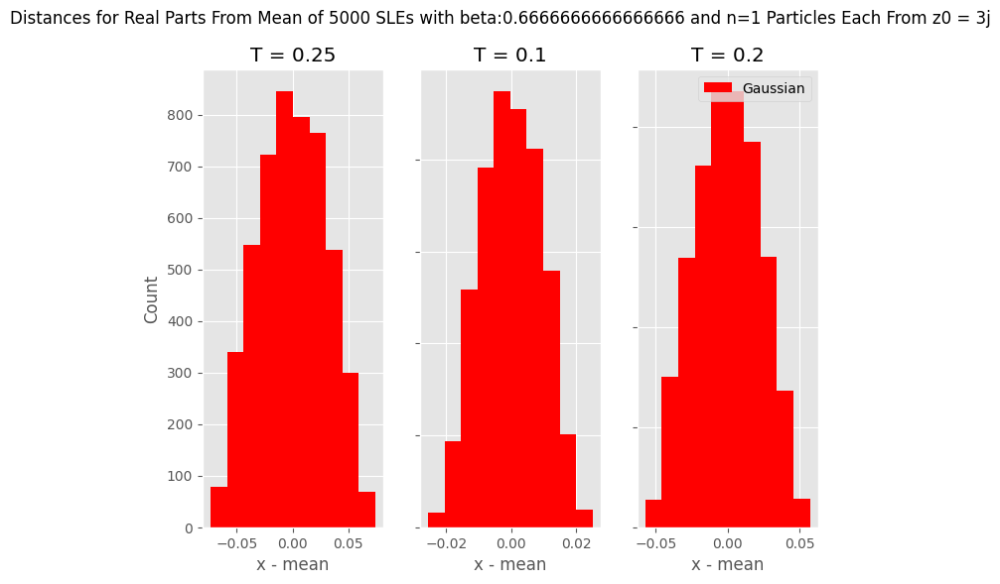

beta: 0.6666666666666666 far
Best Distribution: johnsonsb(a=0.01, b=1.13, loc=-0.08, scale=0.16)
MSE: 0.003859077477809229


<Figure size 1200x800 with 0 Axes>

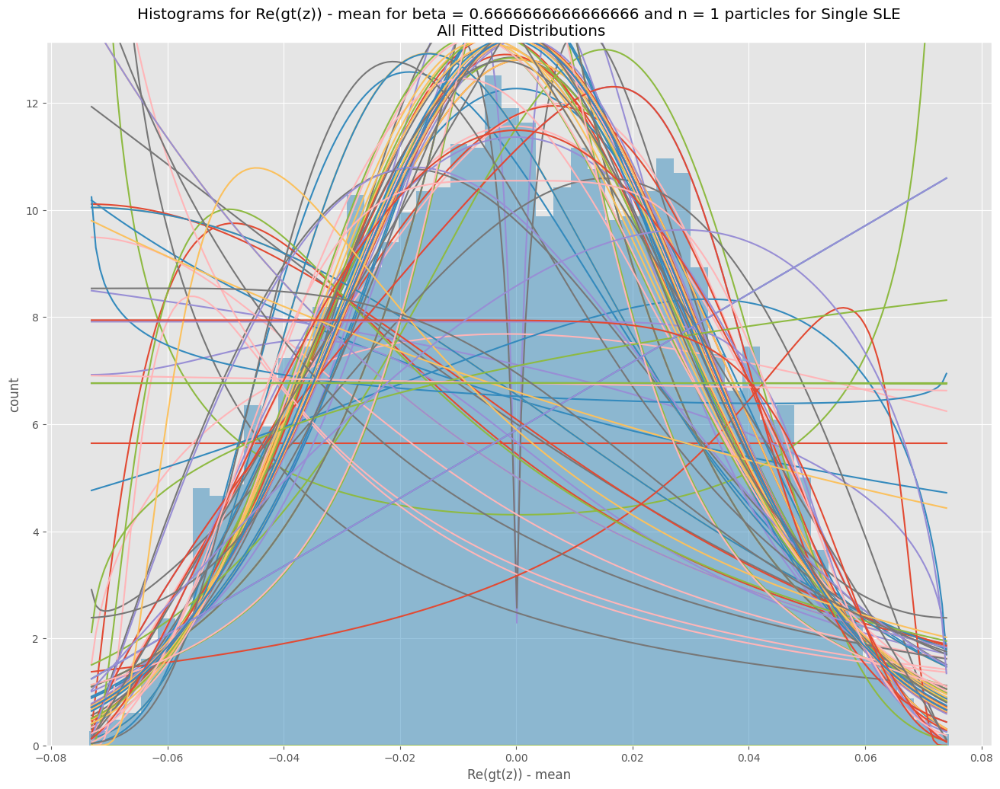

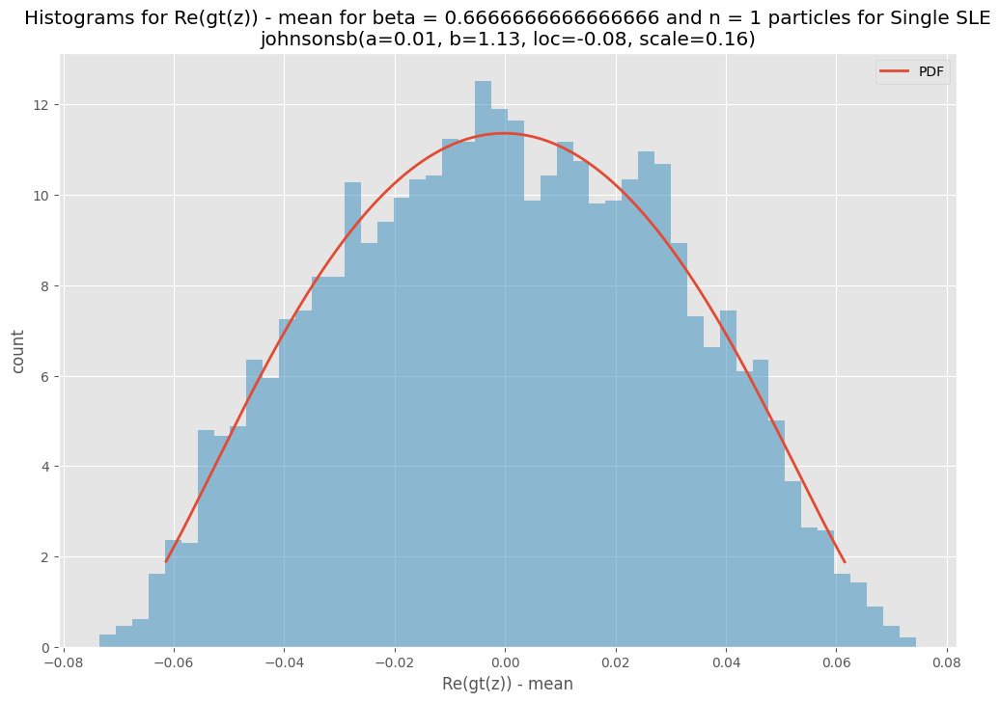

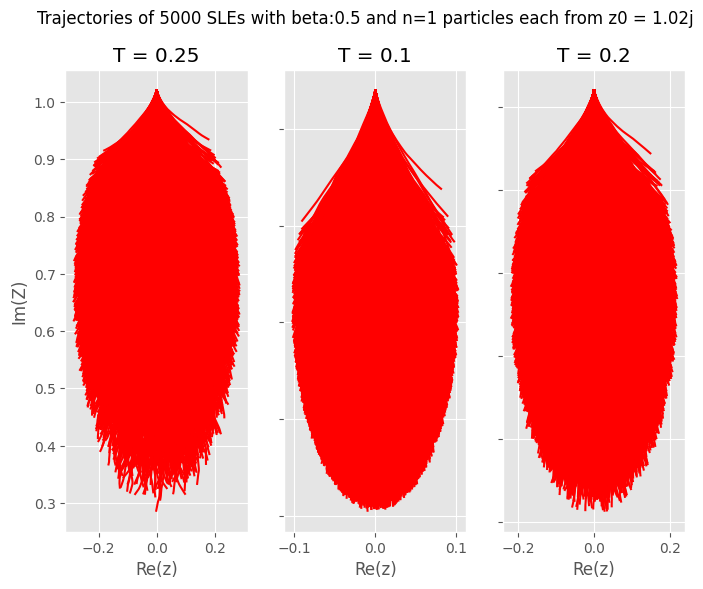

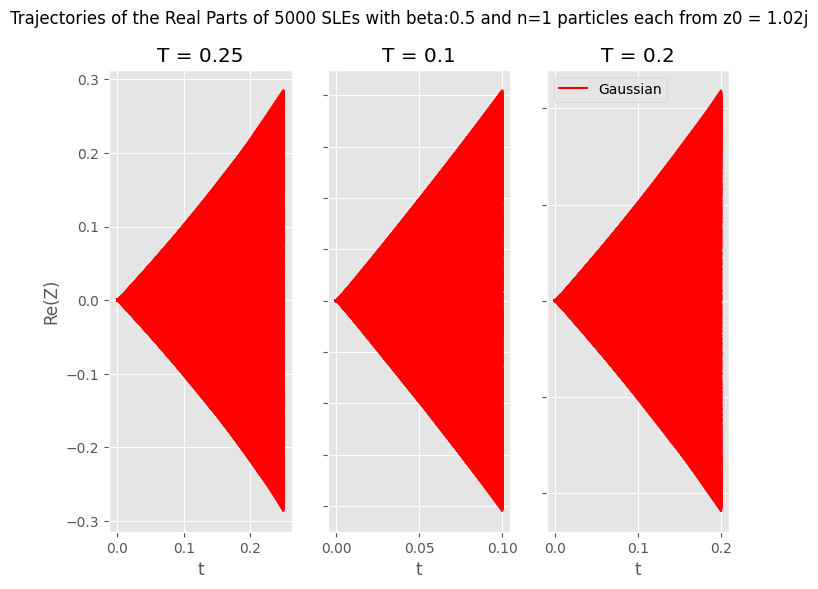

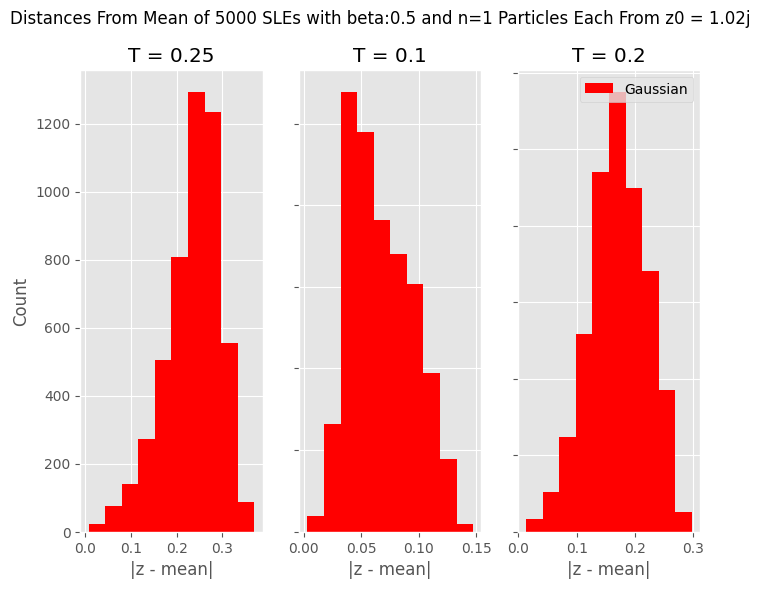

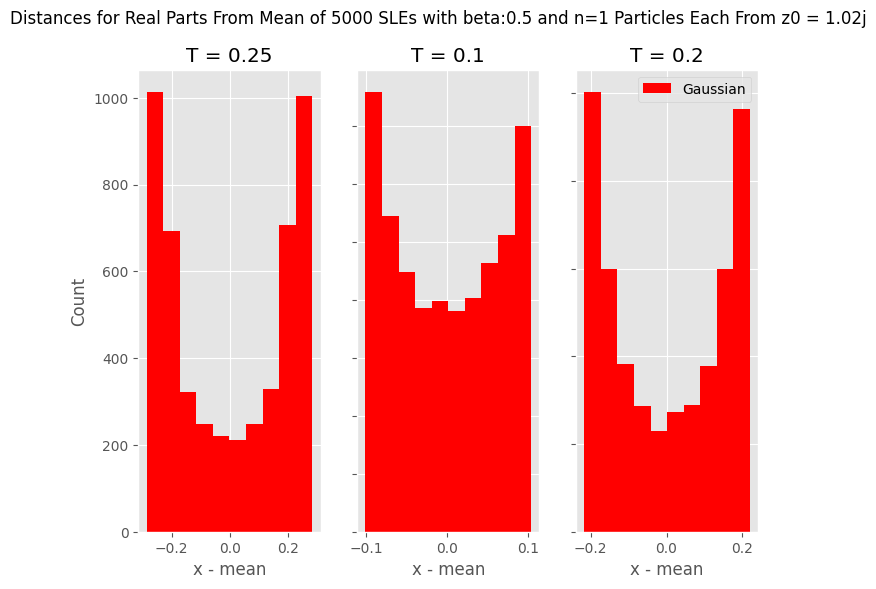

beta: 0.5 close
Best Distribution: wrapcauchy(c=0.39, loc=-0.29, scale=0.09)
MSE: 0.002137789484232149


<Figure size 1200x800 with 0 Axes>

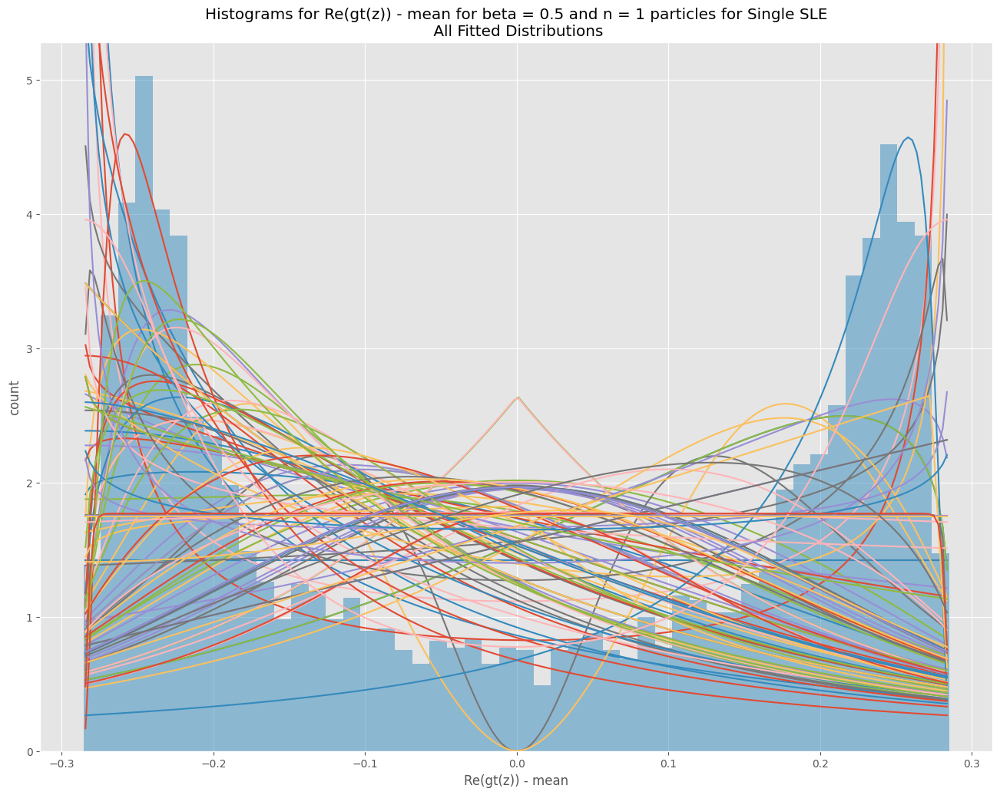

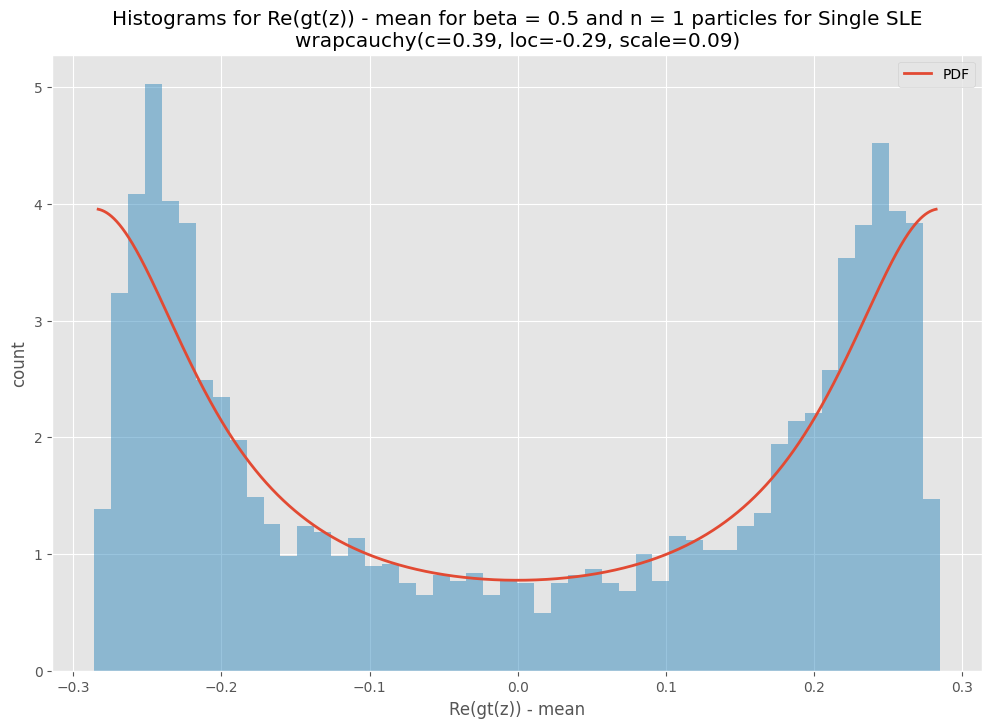

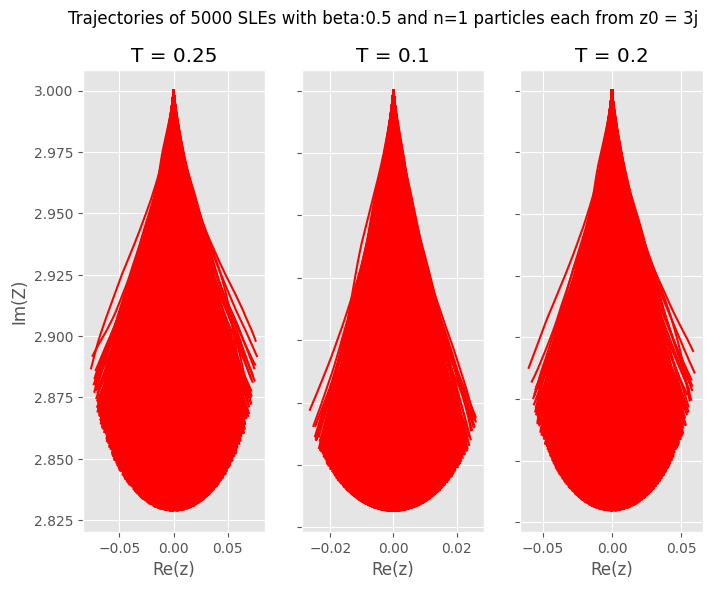

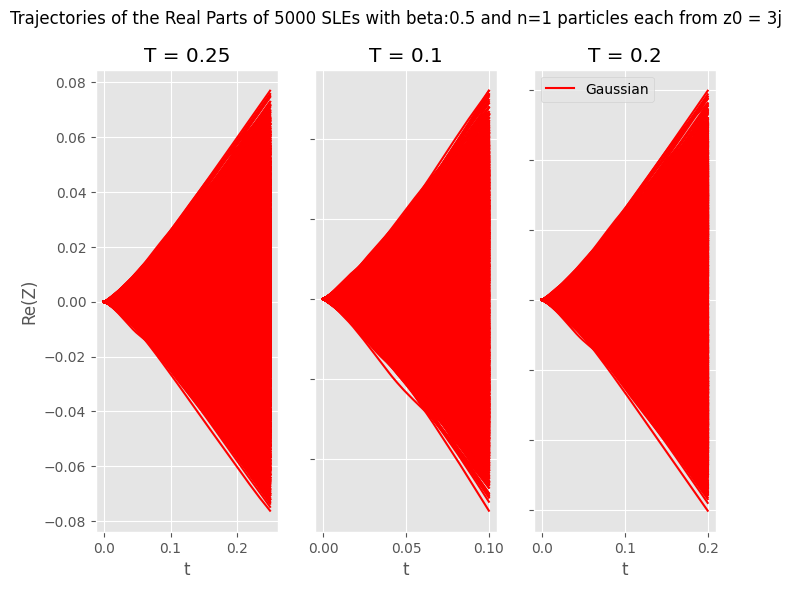

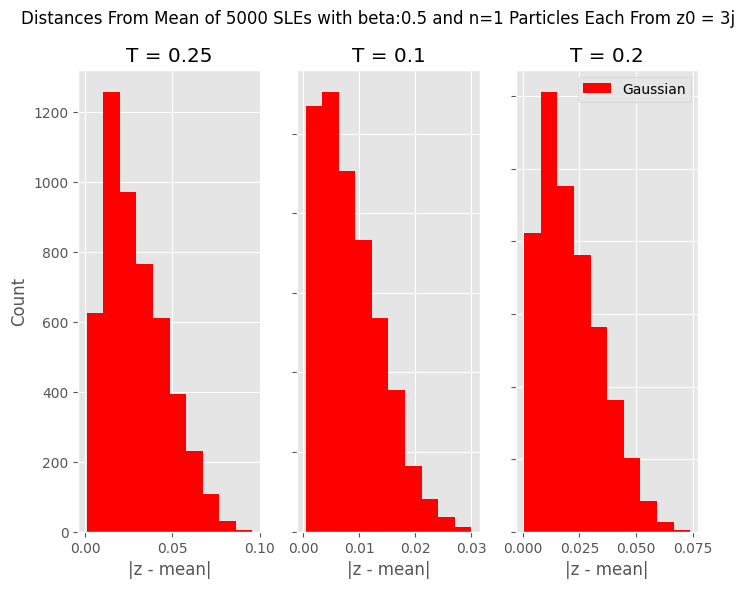

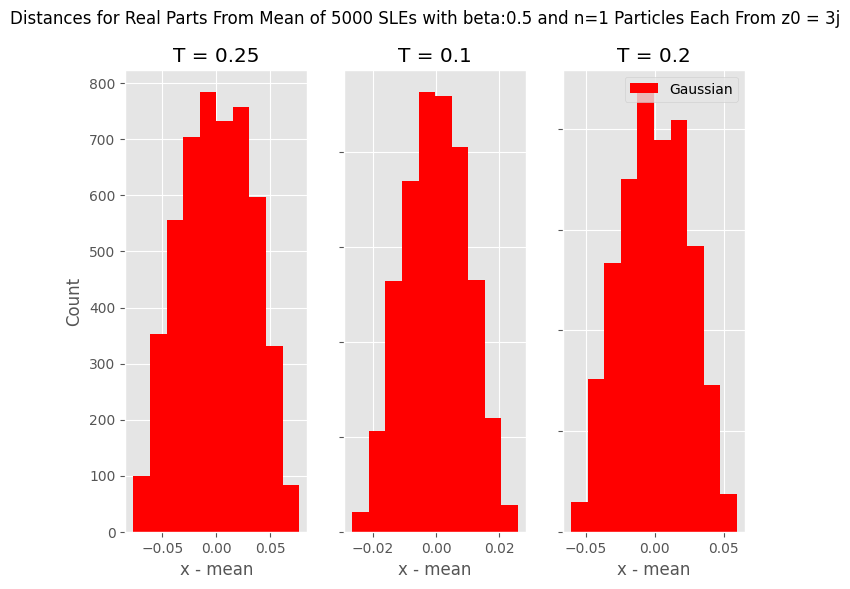

beta: 0.5 far
Best Distribution: johnsonsb(a=-0.02, b=1.05, loc=-0.08, scale=0.16)
MSE: 0.0034189090873664235


<Figure size 1200x800 with 0 Axes>

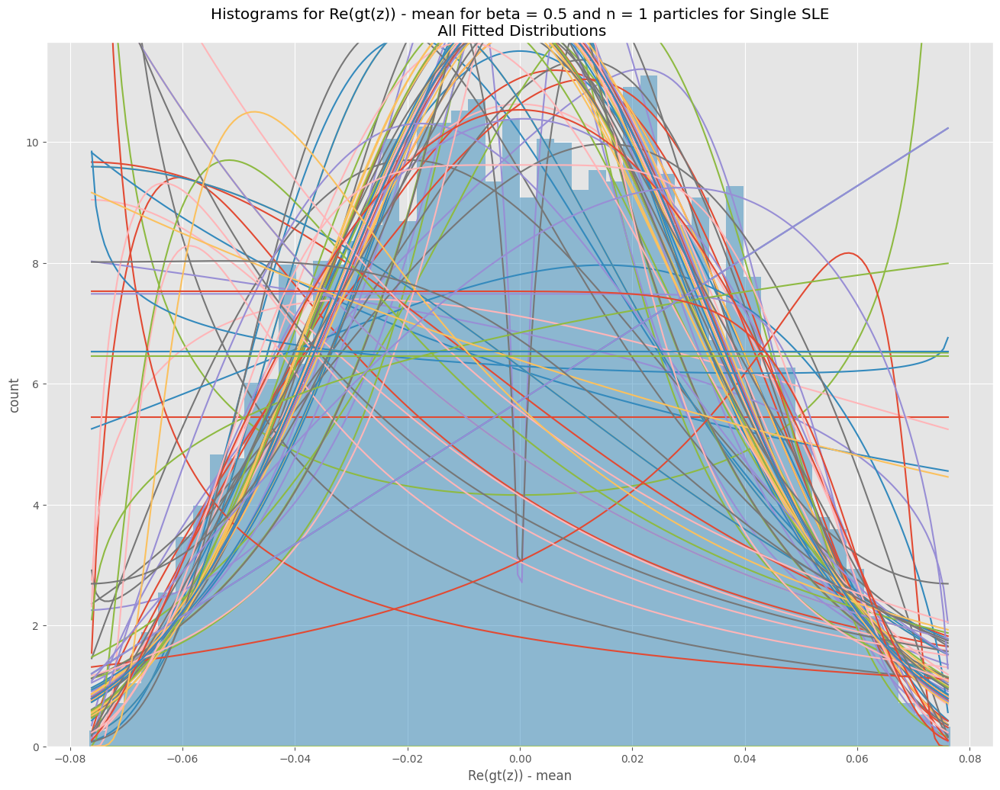

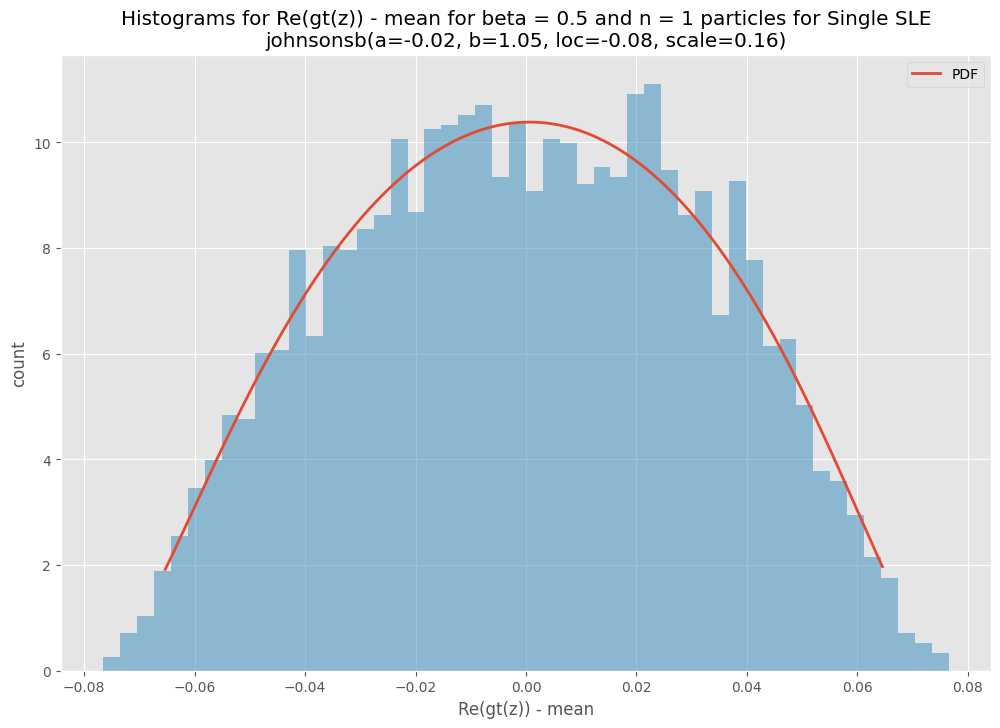

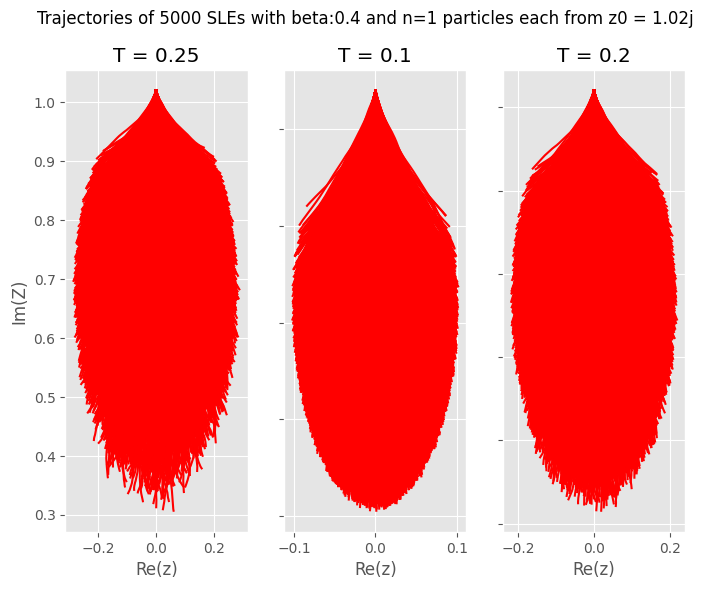

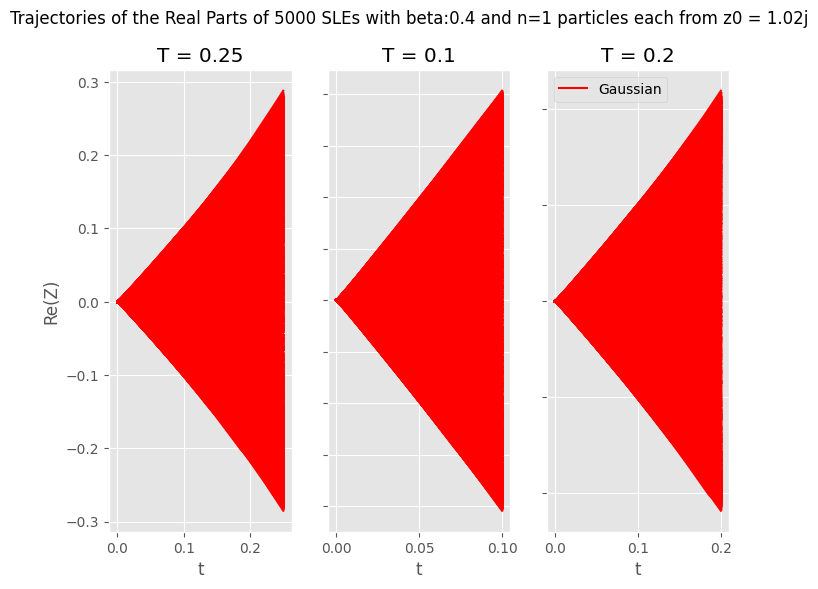

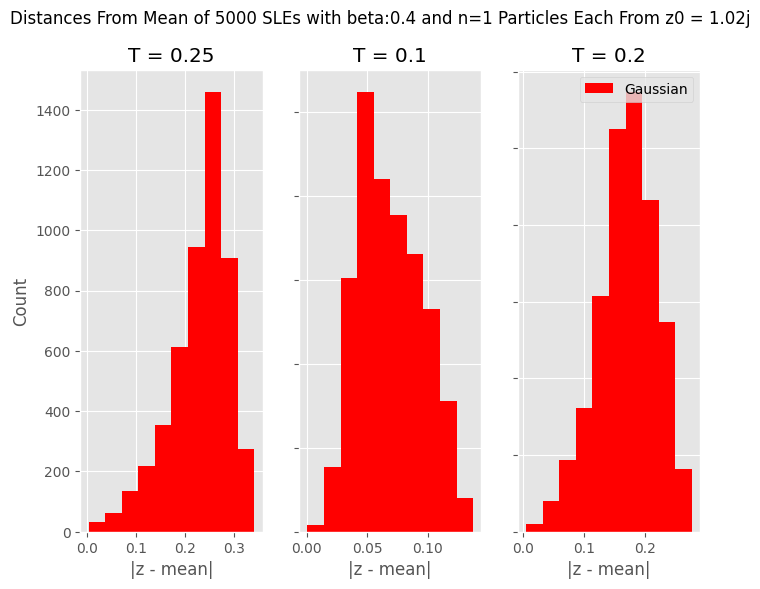

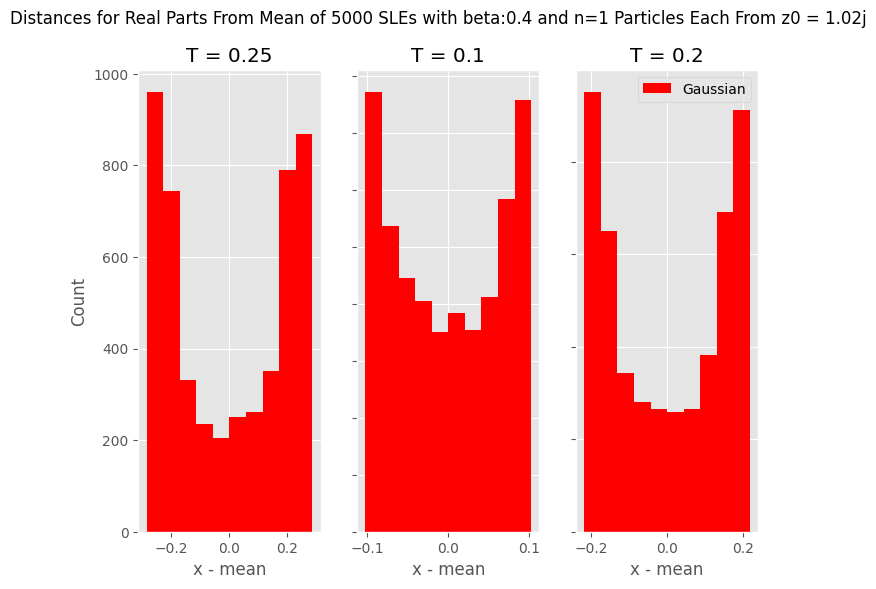

beta: 0.4 close
Best Distribution: wrapcauchy(c=0.35, loc=-0.29, scale=0.09)
MSE: 0.0024088287539244324


<Figure size 1200x800 with 0 Axes>

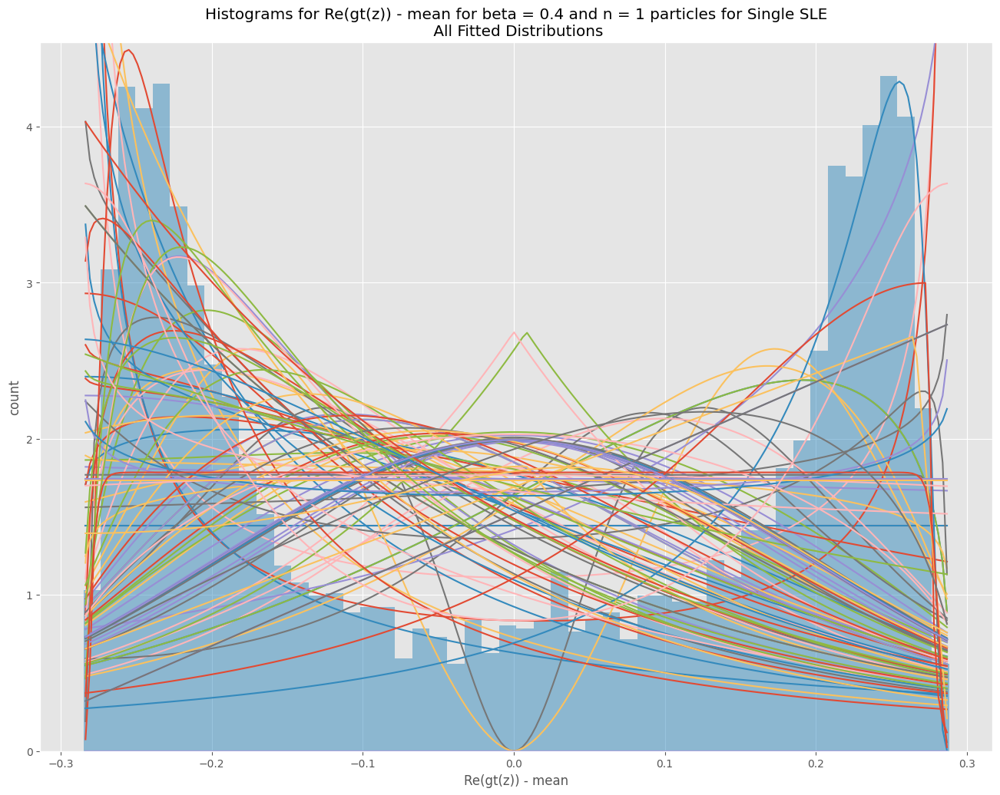

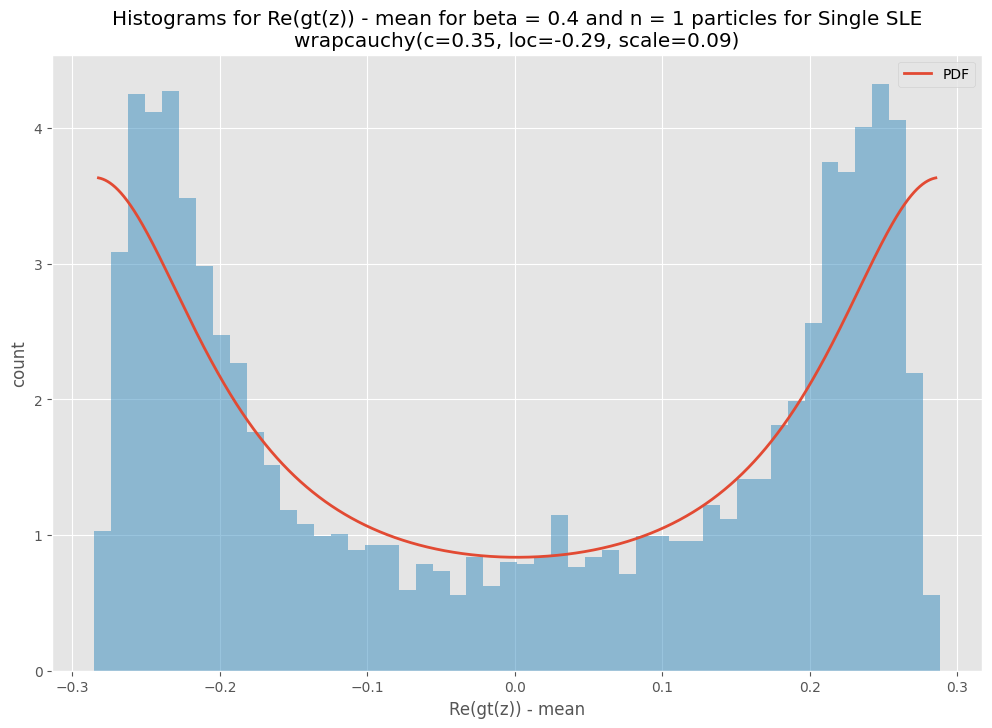

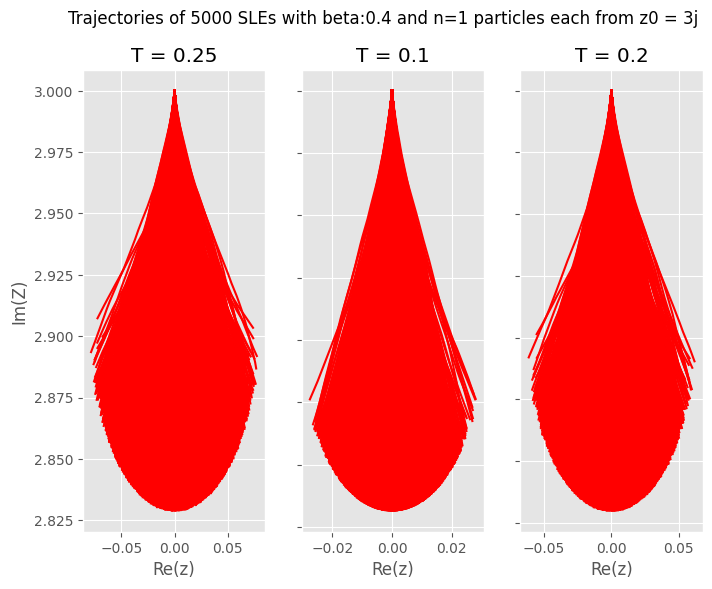

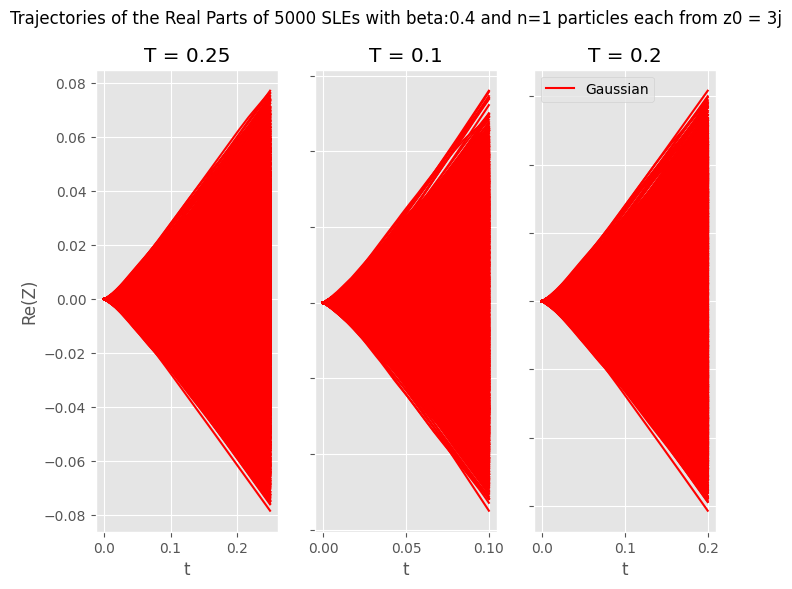

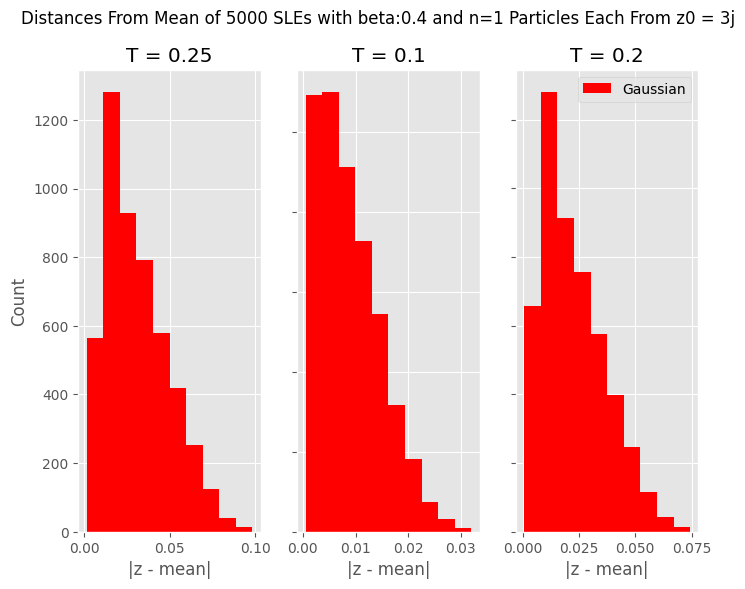

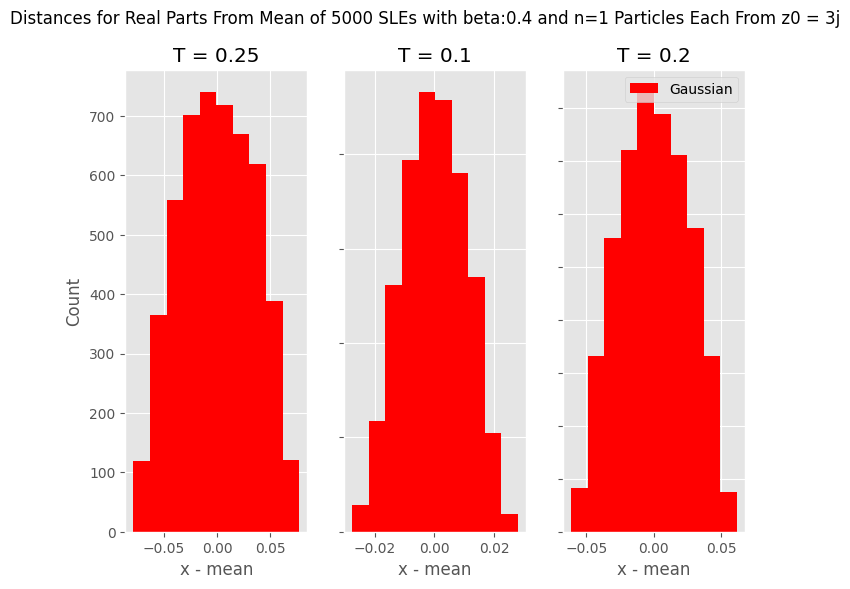

beta: 0.4 far
Best Distribution: johnsonsb(a=-0.01, b=0.98, loc=-0.08, scale=0.16)
MSE: 0.003106940282770371


<Figure size 1200x800 with 0 Axes>

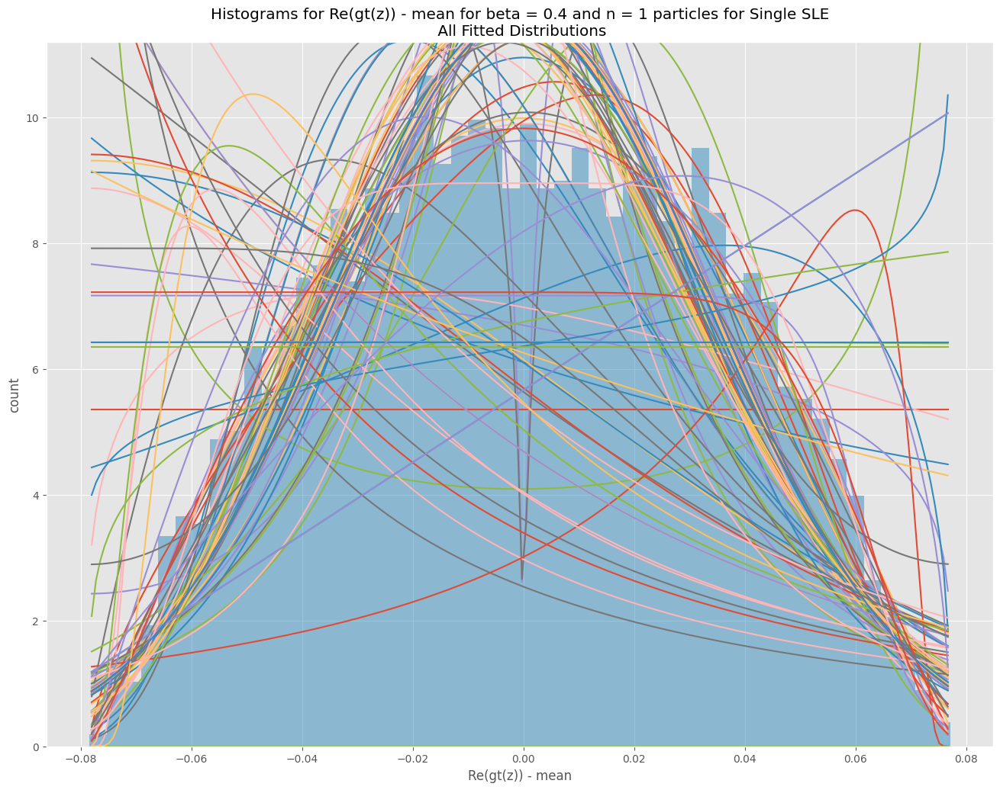

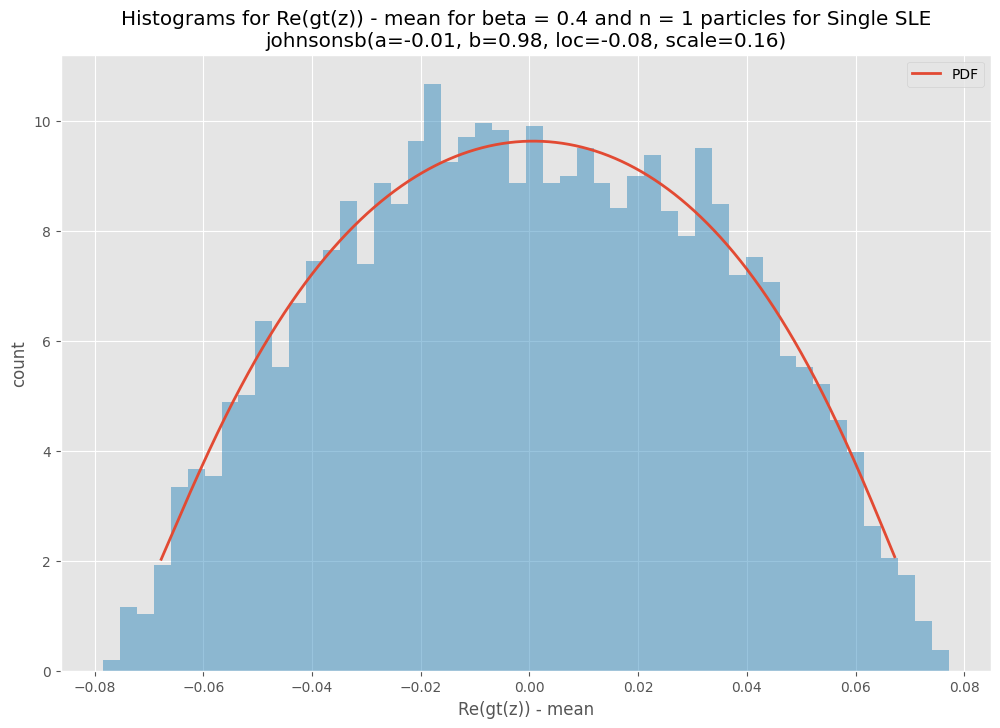

In [12]:
#single SLE
#beta, num_particles, num_experiments, num_steps, T = 1, 100, 50, 10000, 0.25
#beta = 1 #2, 1, 3/4, 2/3, 1/2, 2/5
betas = [2, 1, 3/4, 2/3, 1/2, 2/5]
num_experiments = 5000 #10000 #100000
num_steps = 10000
T = 0.25
nscale = True
drift = False
E = 0
ipath = "experiments/FixedEnergyInspired/SingleRealLarge3/"
prevStart = 0
#parts = [10, 50, 100]
#parts = [10, 50, 100]
#z0s = [0 + (0 + (2 * np.sqrt(T) + (0.02)))*1j, -1 + (0 + (2 * np.sqrt(T) + (0.02)))*1j, 1 + (0 + (2 * np.sqrt(T) + (0.02)))*1j]
#z0 = 0 + (0 + (2 * np.sqrt(T) + (0.02)))*1j

z0close = 2j + 0.5
z0far = 3j + 3
z0high = 4j
nParts = 1
if(1/nParts > 0.25 or 5/nParts > 0.25):
    times = [0.1, 0.2]
else:
    times = [(1/nParts), (5/nParts)]
x01 = 0.0
for j in range(len(betas)):
    beta = betas[j]
    path = ipath + str(j + 1) + "/"
    finals1, shorts1 = doExperimentsSingleTimes(beta, nParts, num_experiments, num_steps, T, x01, z0close, times, imgpath=path, figsize=(8, 6), plotReal=True, nscale=nscale, drift=drift) #+ str(prevStart + i)
    sample_mean1 = np.mean(finals1.real)
    spreads1 = nParts * finals1.real - sample_mean1 if nscale else finals1.real - sample_mean1
    print("beta: " + str(beta) + " close")
    res = stats.shapiro(spreads1)
    print("Shapiro: " + str(res))
    plotFit(spreads1, "Histograms for Re(gt(z)) - mean for beta = " + str(beta) + " and n = " + str(nParts) + " particles for Single SLE", "Re(gt(z)) - mean", "count", path + "R_" + str(nParts))
    plt.show()

    path = ipath + str(j + 1) + "_2/"
    finals1, shorts1 = doExperimentsSingleTimes(beta, nParts, num_experiments, num_steps, T, x01, z0far, times, imgpath=path, figsize=(8, 6), plotReal=True, nscale=nscale, drift=drift) #+ str(prevStart + i)
    sample_mean1 = np.mean(finals1.real)
    spreads1 = nParts * finals1.real - sample_mean1 if nscale else finals1.real - sample_mean1
    print("beta: " + str(beta) + " far")
    res = stats.shapiro(spreads1)
    print("Shapiro: " + str(res))
    plotFit(spreads1, "Histograms for Re(gt(z)) - mean for beta = " + str(beta) + " and n = " + str(nParts) + " particles for Single SLE", "Re(gt(z)) - mean", "count", path + "R_" + str(nParts))
    plt.show()

    path = ipath + str(j + 1) + "_3/"
    finals1, shorts1 = doExperimentsSingleTimes(beta, nParts, num_experiments, num_steps, T, x01, z0high, times, imgpath=path, figsize=(8, 6), plotReal=True, nscale=nscale, drift=drift) #+ str(prevStart + i)
    sample_mean1 = np.mean(finals1.real)
    spreads1 = nParts * finals1.real - sample_mean1 if nscale else finals1.real - sample_mean1
    print("beta: " + str(beta) + " high")
    res = stats.shapiro(spreads1)
    print("Shapiro: " + str(res))
    plotFit(spreads1, "Histograms for Re(gt(z)) - mean for beta = " + str(beta) + " and n = " + str(nParts) + " particles for Single SLE", "Re(gt(z)) - mean", "count", path + "R_" + str(nParts))
    plt.show()
    #sample_mean1 = np.mean(finals1)
    #spreads1 = nParts * np.abs(finals1 - sample_mean1) if nscale else np.abs(finals1 - sample_mean1)
    #plotFit(spreads1, "Histograms for |gt(z) - mean| for beta = " + str(beta) + " and n = " + str(nParts) + " particles for Single SLE", "|gt(z)) - mean|", "count", path + "A_" + str(nParts))
    #plt.show()


#z0 = -0.02 + (0 + (2 * nParts * np.sqrt(T) + (0.02)))*1j
#finals1, final2, shorts1, shorts2 = doExperimentsTimesEnergy(beta, nParts, num_experiments, num_steps, T, x01, x02, z0, times, E, imgpath=path + str(prevStart + i) + "_", figsize=(8, 6), plotReal=True, nscale=nscale)

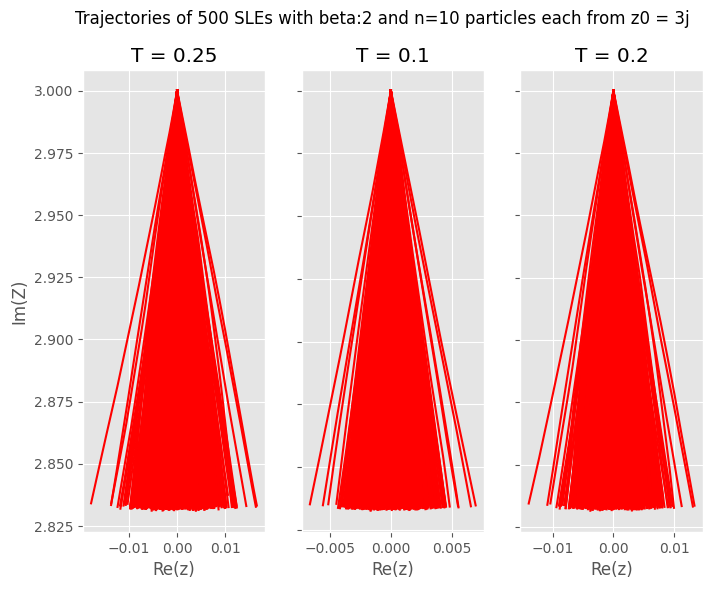

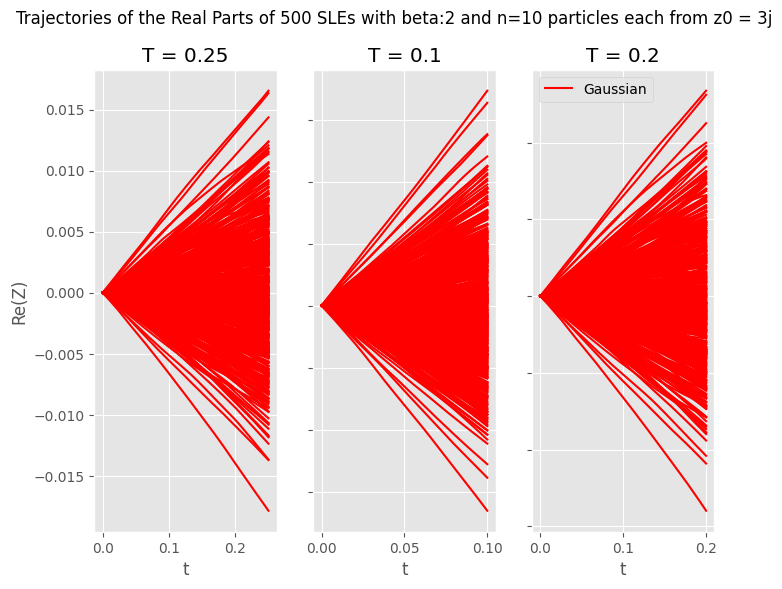

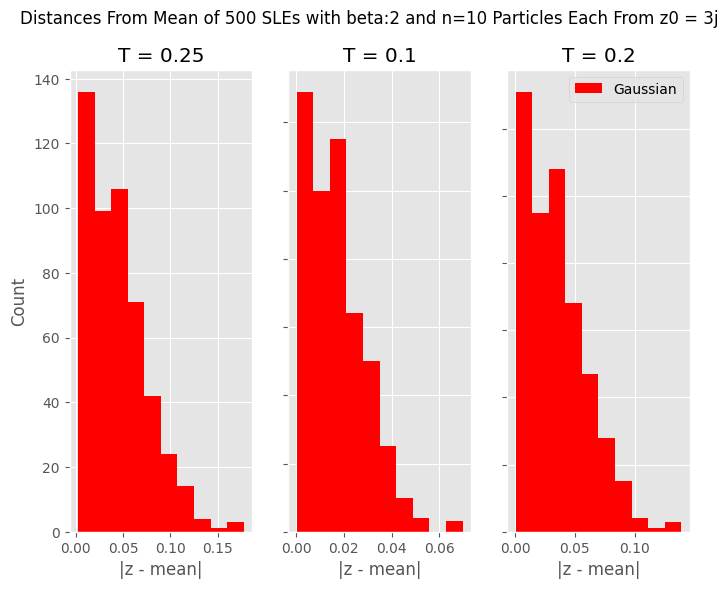

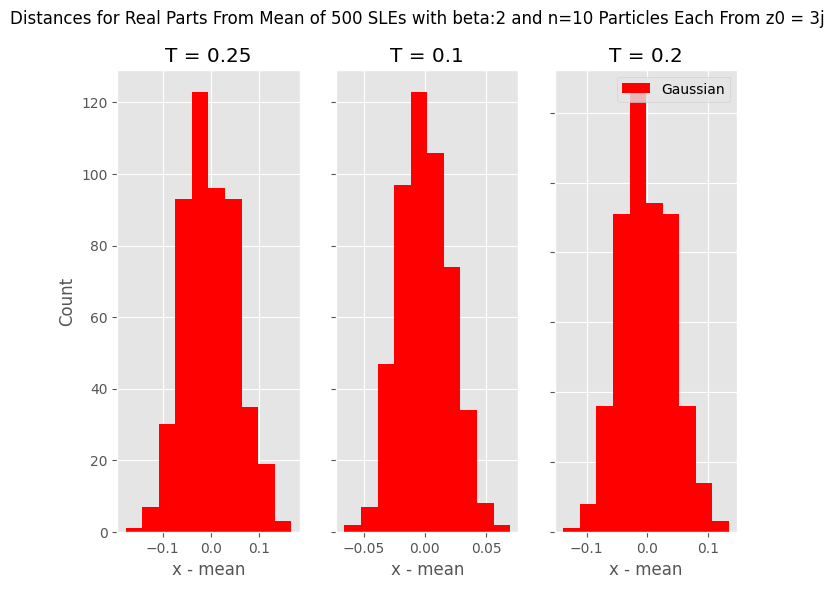

N: 10
Best Distribution: weibull_max(c=4.41, loc=0.21, scale=0.23)
MSE: 0.060955171775868865


<Figure size 1200x800 with 0 Axes>

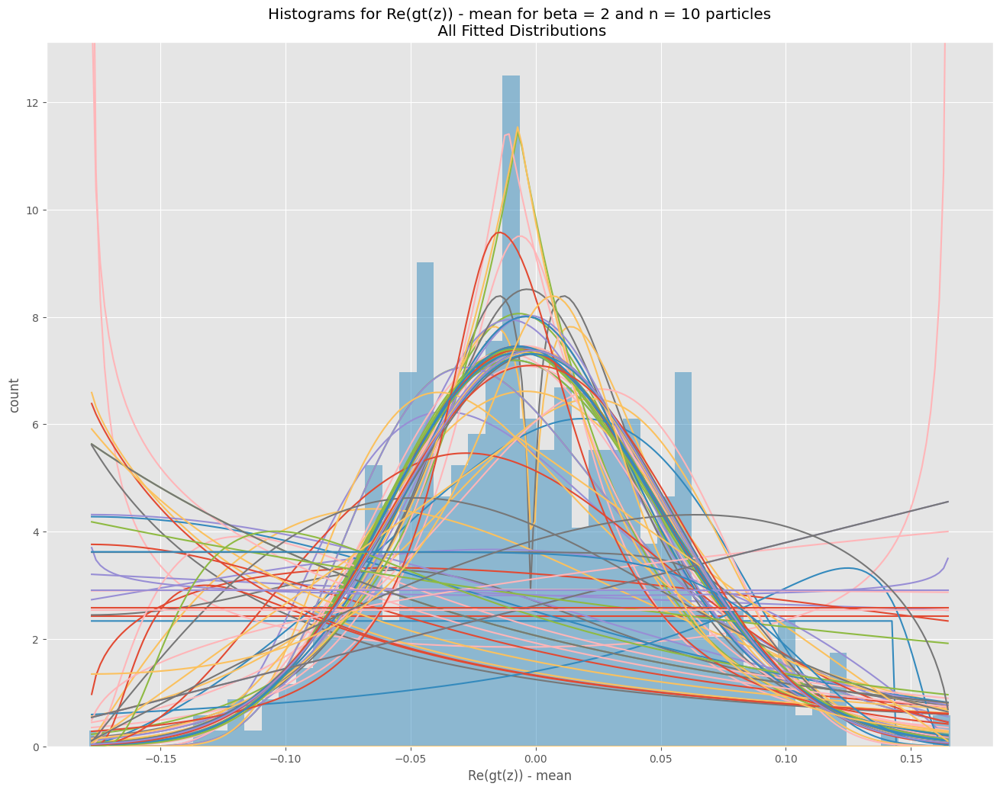

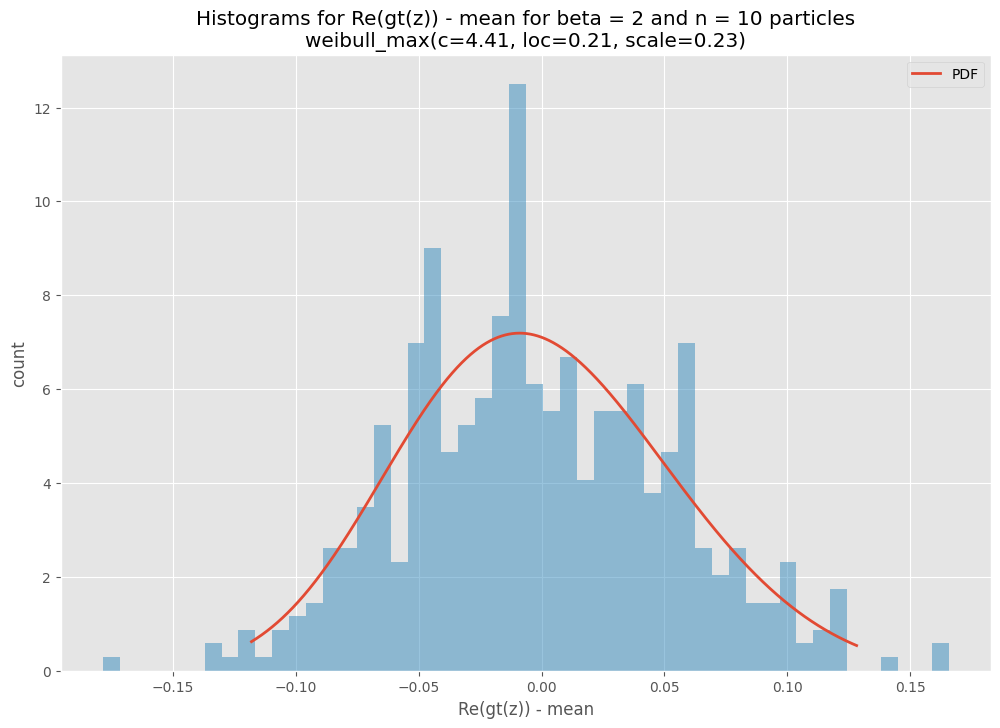

Best Distribution: nakagami(nu=0.47, loc=0.00, scale=0.05)
MSE: 0.09874964367089496


<Figure size 1200x800 with 0 Axes>

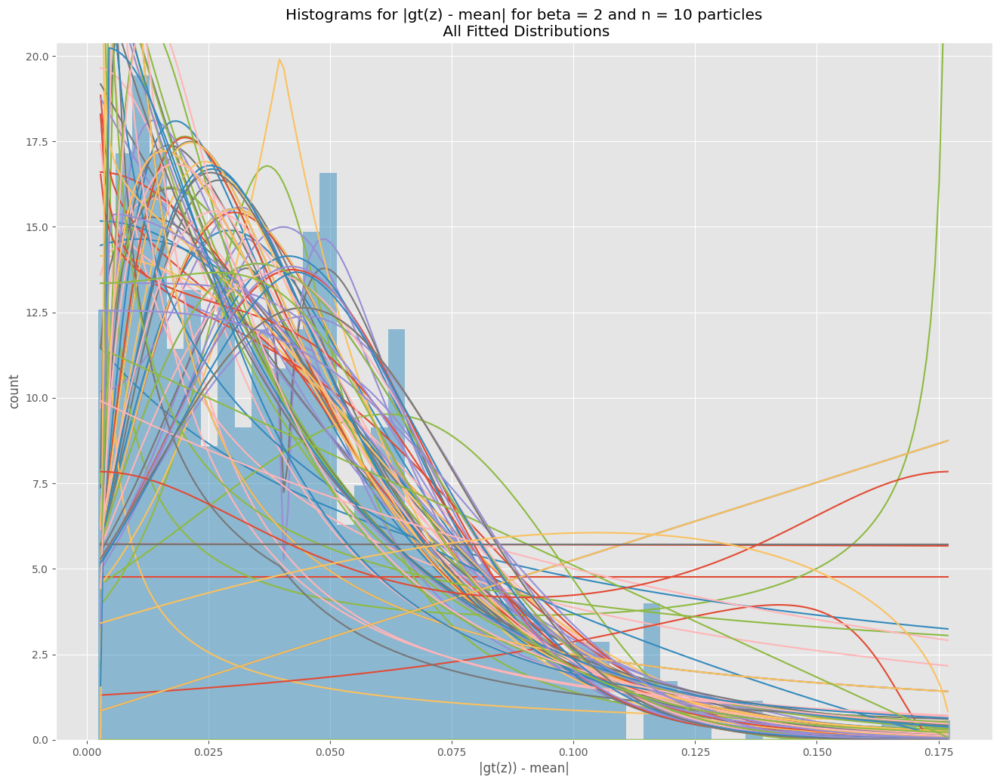

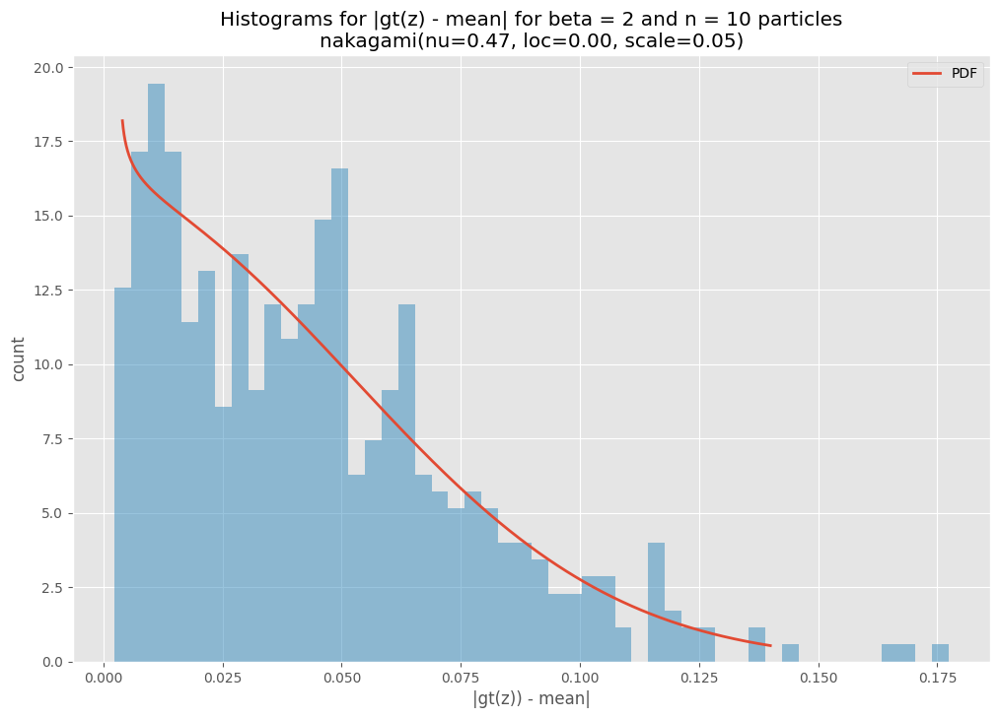

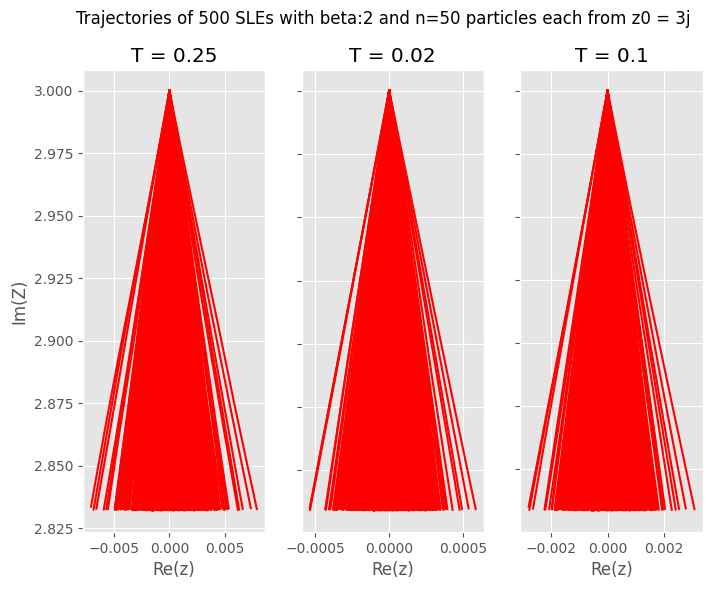

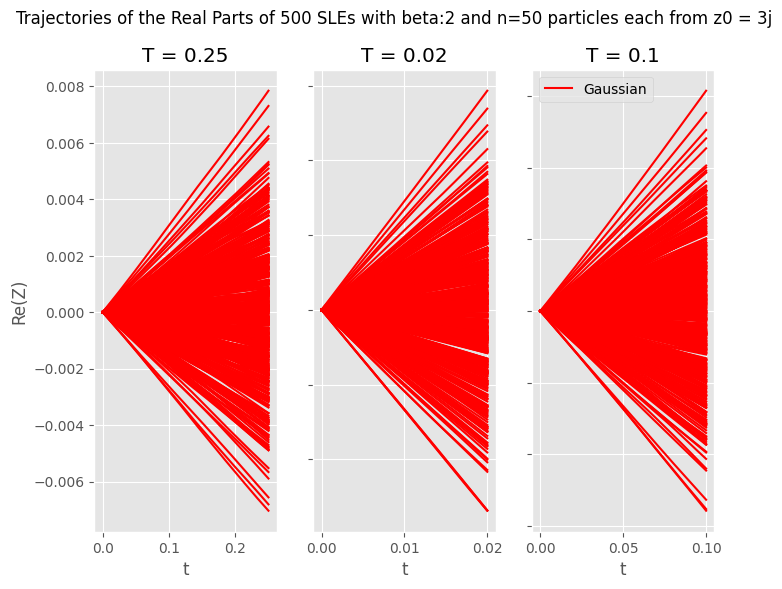

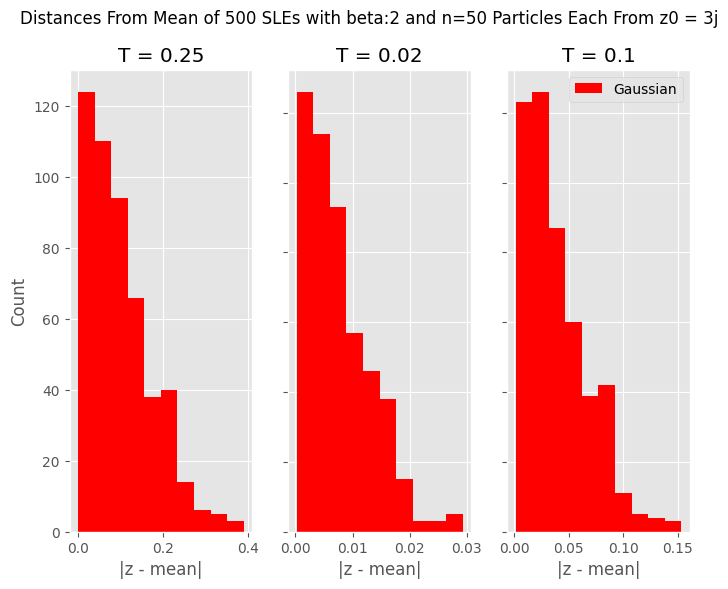

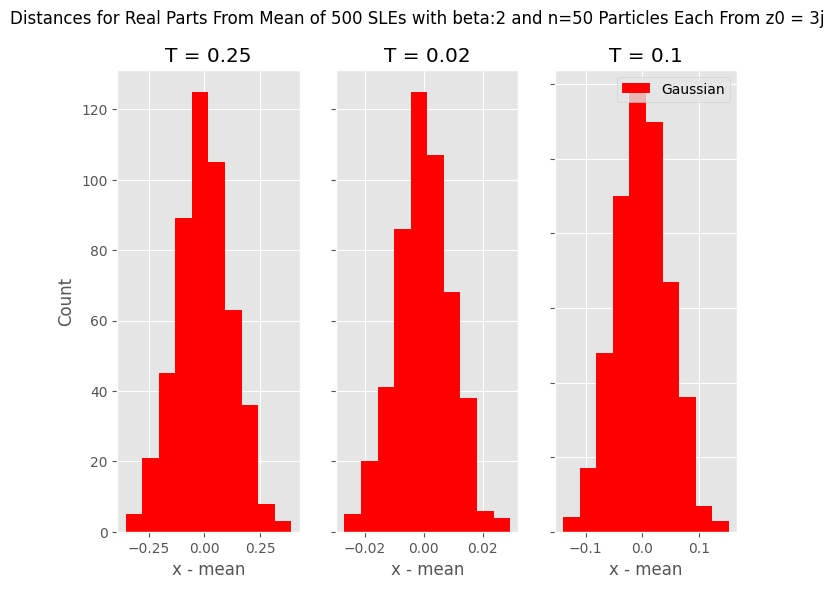

N: 50
Best Distribution: foldnorm(c=2.87, loc=-0.35, scale=0.12)
MSE: 0.02439159017529424


<Figure size 1200x800 with 0 Axes>

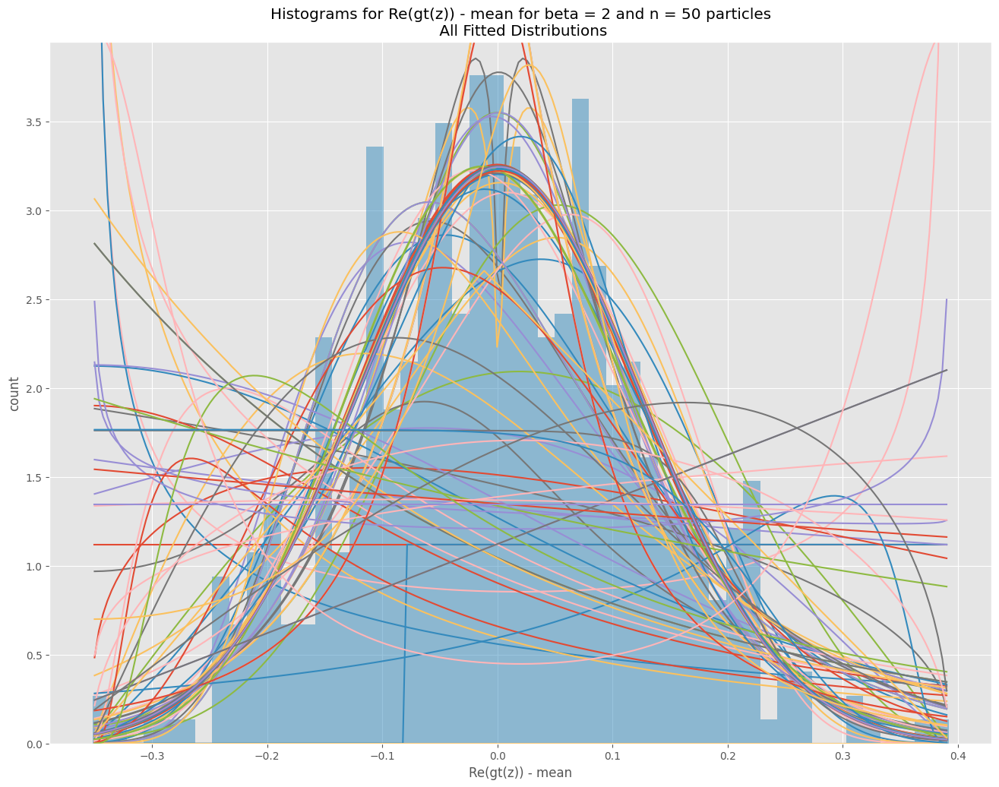

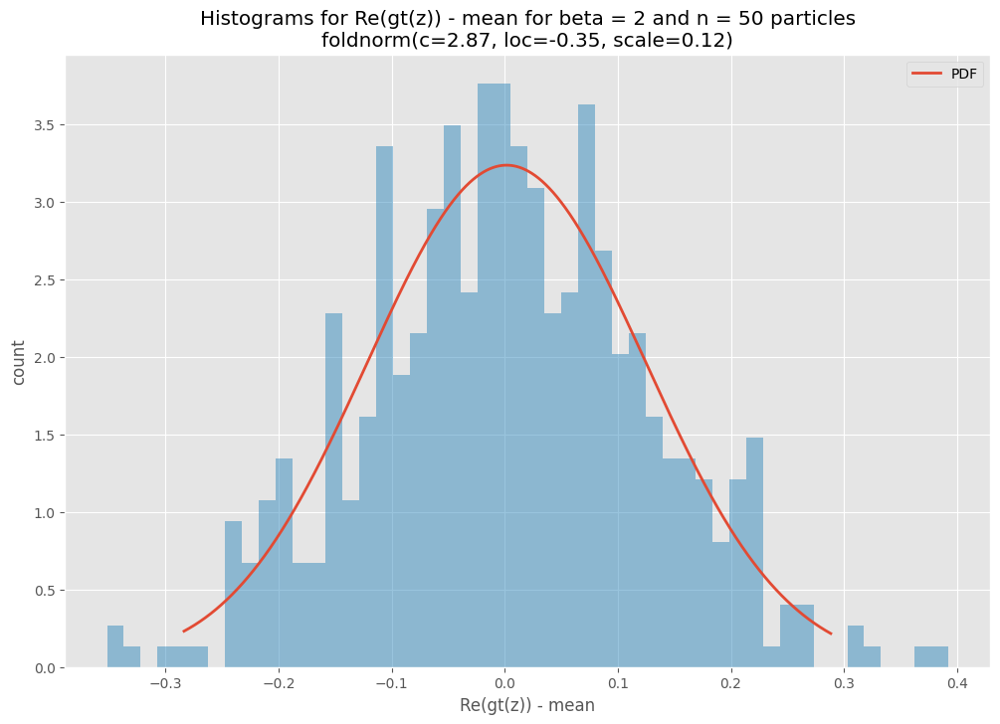

Best Distribution: gausshyper(a=1.38, b=2.60, c=4.07, z=0.93, loc=0.00, scale=0.43)
MSE: 0.041192423807299025


<Figure size 1200x800 with 0 Axes>

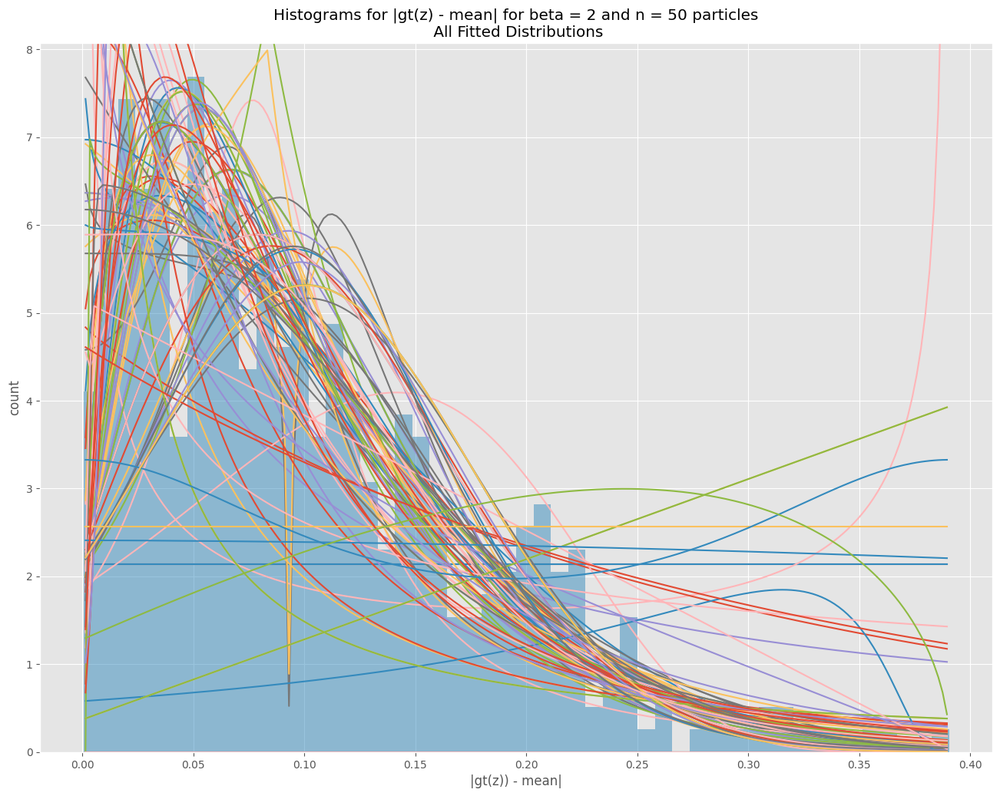

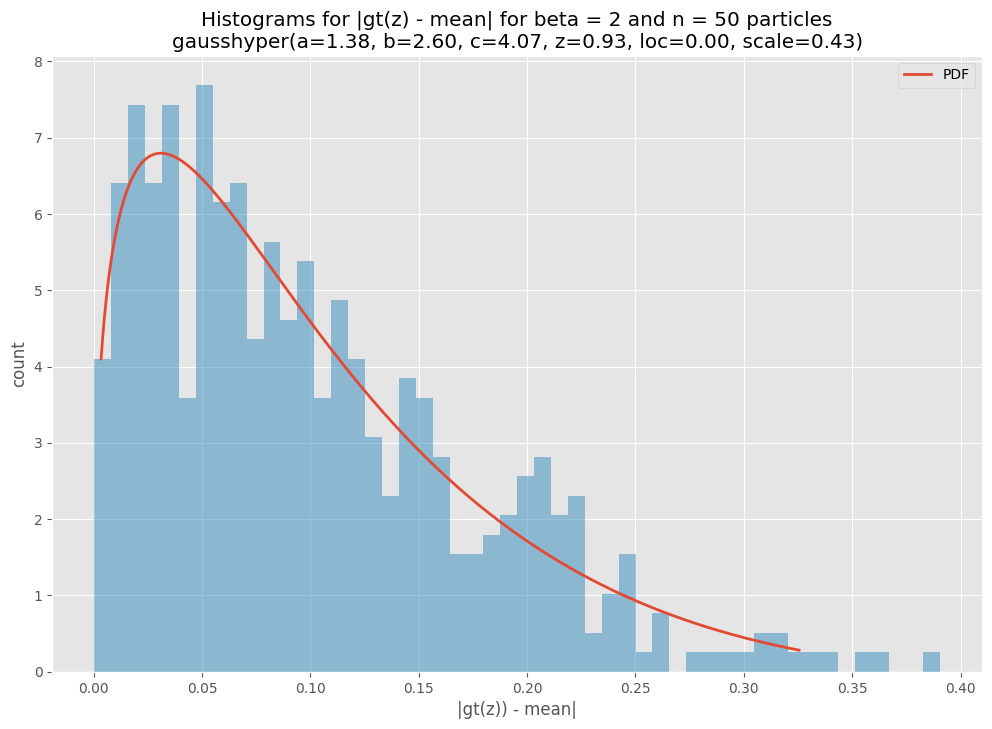

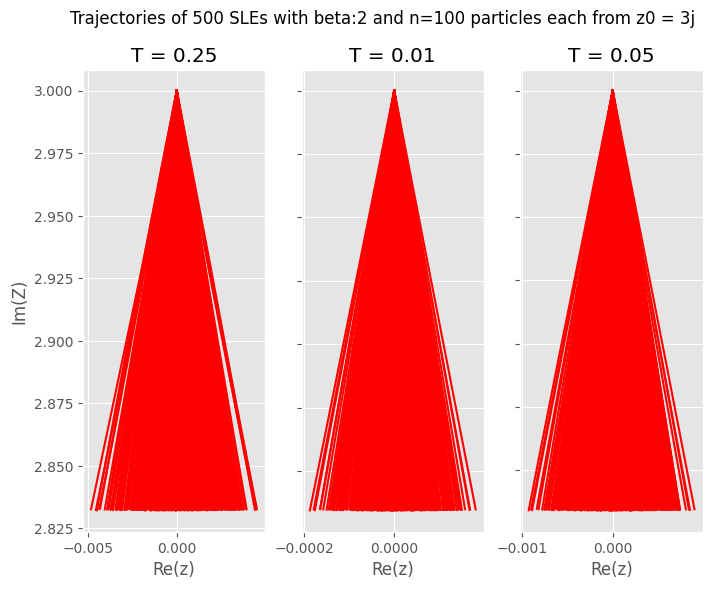

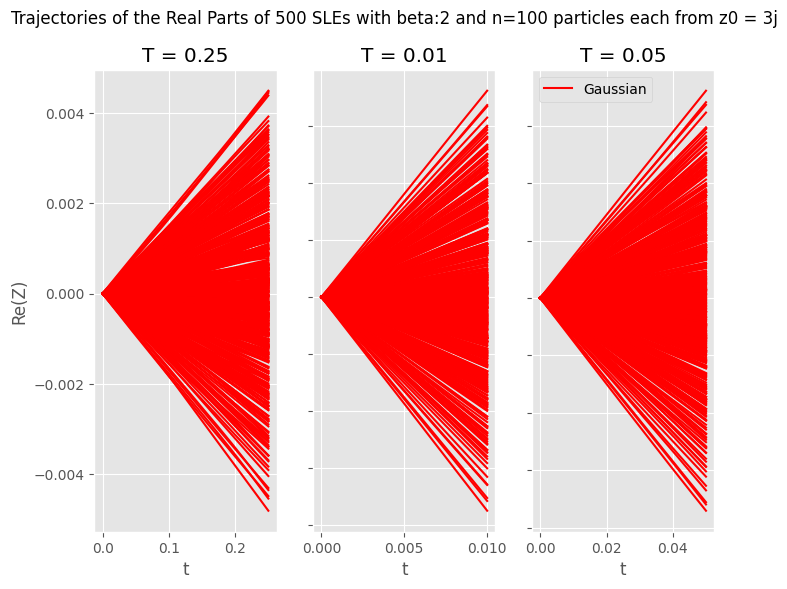

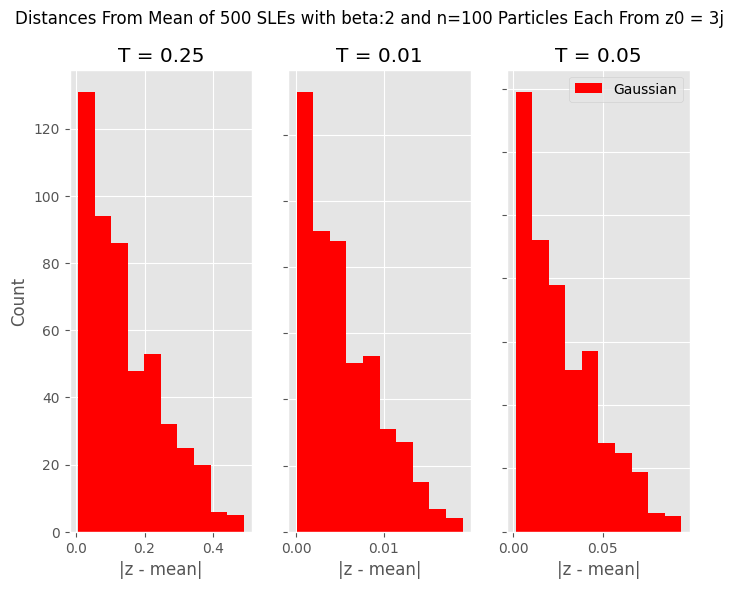

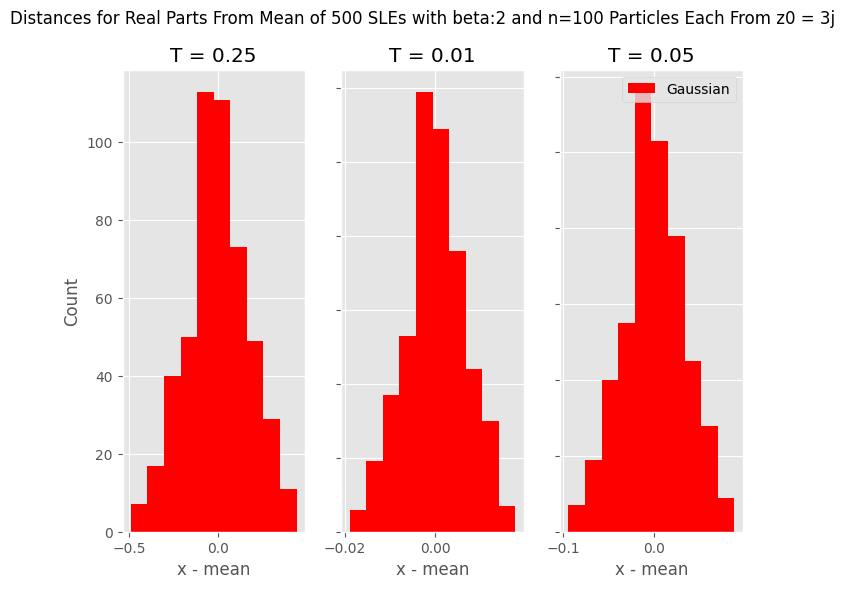

N: 100
Best Distribution: hypsecant(loc=0.01, scale=0.12)
MSE: 0.021382786482634718


<Figure size 1200x800 with 0 Axes>

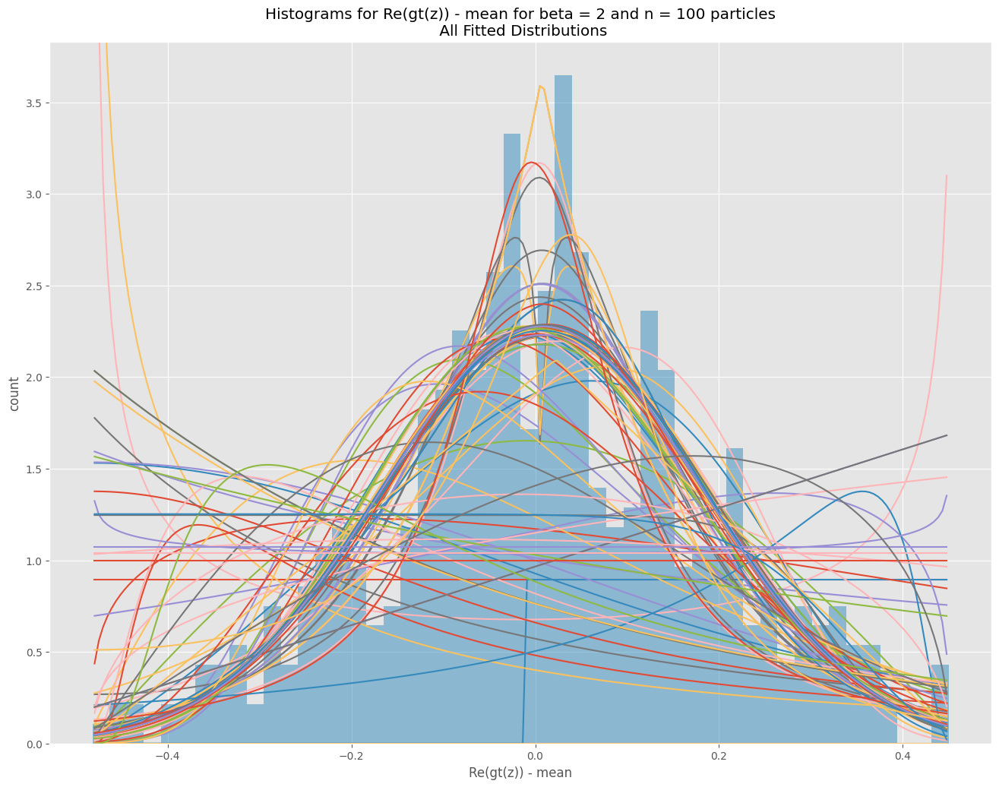

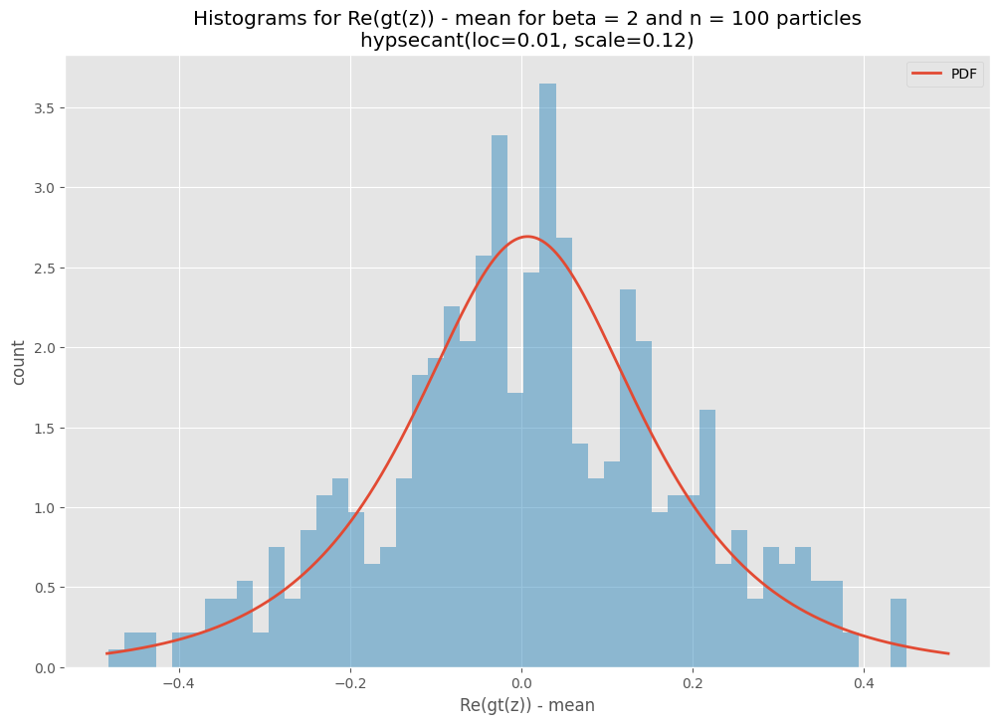

Best Distribution: laplace_asymmetric(kappa=0.22, loc=0.02, scale=0.03)
MSE: 0.041184968884884335


<Figure size 1200x800 with 0 Axes>

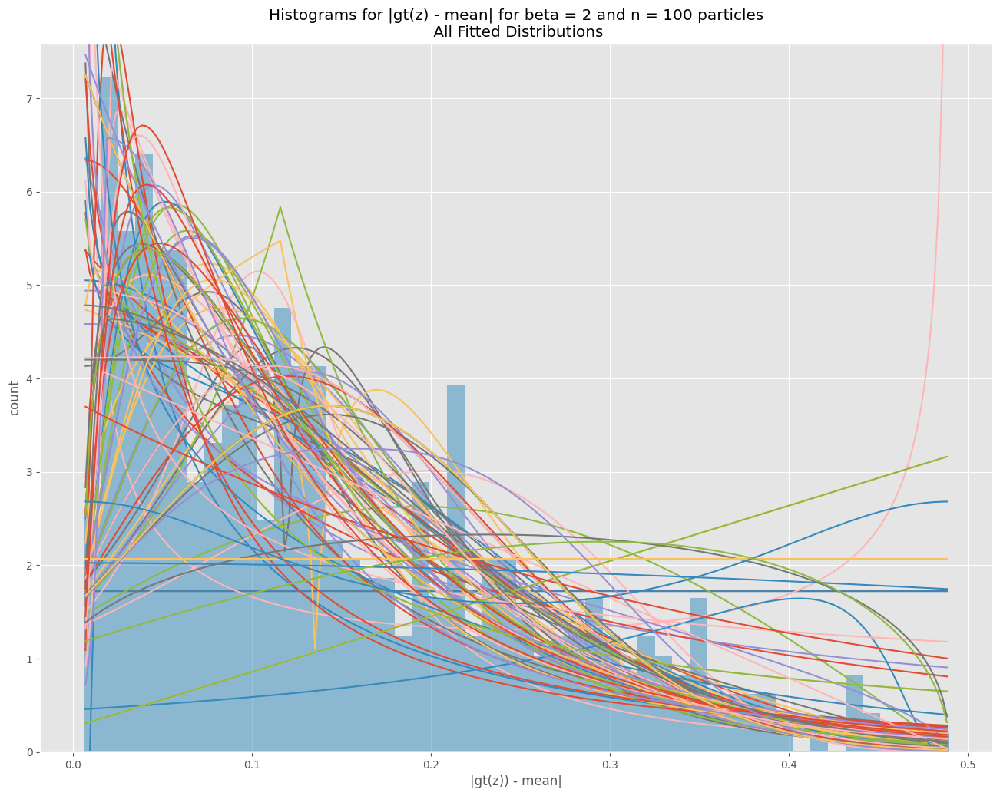

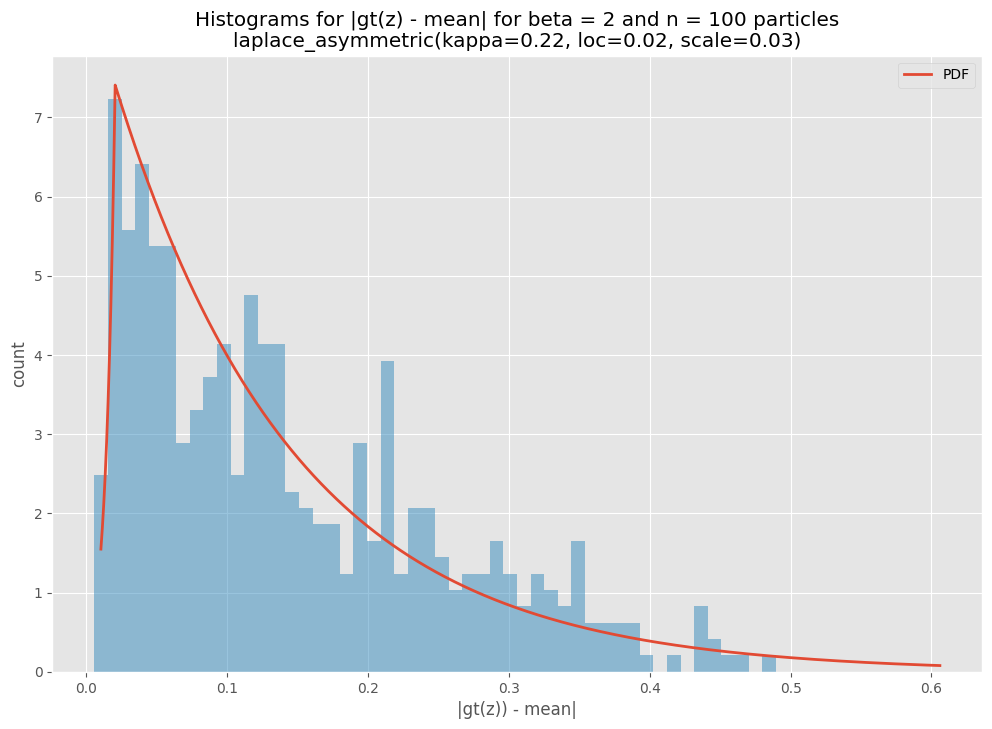

In [131]:
#single DBM
beta = 2 #2, 1, 3/4, 2/3, 1/2, 2/5
num_experiments = 500
num_steps = 10000
T = 0.25
nscale = True
drift = False
E = 0
path = "experiments/FixedEnergyInspired/SingleDBMReal/4/"
prevStart = 0

dist = 0.2 #distance that each particle should start apart
#parts = [10, 50, 100]
parts = [10, 50, 100]
#z0s = [0 + (0 + (2 * np.sqrt(T) + (0.02)))*1j, -1 + (0 + (2 * np.sqrt(T) + (0.02)))*1j, 1 + (0 + (2 * np.sqrt(T) + (0.02)))*1j]
#z0 = 0 + (0 + (2 * np.sqrt(T) + (0.02)))*1j

#z0 = (0.02 + 2 * np.sqrt(T)) * 1j
z0 = 3j

for i in range(len(parts)):
    nParts = parts[i]
    if(1/nParts > 0.25 or 5/nParts > 0.25):
        times = [0.1, 0.2]
    else:
        times = [(1/nParts), (5/nParts)]
    #x01 = 0.0
    x01 = makeX0(nParts, dist)
    finals1, shorts1 = doExperimentsSingleTimes(beta, nParts, num_experiments, num_steps, T, x01, z0, times, imgpath=path, figsize=(8, 6), plotReal=True, nscale=nscale, drift=drift) #+ str(prevStart + i)
    sample_mean1 = np.mean(finals1.real)
    spreads1 = nParts * finals1.real - sample_mean1 if nscale else finals1.real - sample_mean1
    print("N: " + str(nParts))
    plotFit(spreads1, "Histograms for Re(gt(z)) - mean for beta = " + str(beta) + " and n = " + str(nParts) + " particles", "Re(gt(z)) - mean", "count", path + "R_" + str(nParts))
    plt.show()
    sample_mean1 = np.mean(finals1)
    spreads1 = nParts * np.abs(finals1 - sample_mean1) if nscale else np.abs(finals1 - sample_mean1)
    plotFit(spreads1, "Histograms for |gt(z) - mean| for beta = " + str(beta) + " and n = " + str(nParts) + " particles", "|gt(z)) - mean|", "count", path + "A_" + str(nParts))
    plt.show()
#z0 = -0.02 + (0 + (2 * nParts * np.sqrt(T) + (0.02)))*1j
#finals1, final2, shorts1, shorts2 = doExperimentsTimesEnergy(beta, nParts, num_experiments, num_steps, T, x01, x02, z0, times, E, imgpath=path + str(prevStart + i) + "_", figsize=(8, 6), plotReal=True, nscale=nscale)

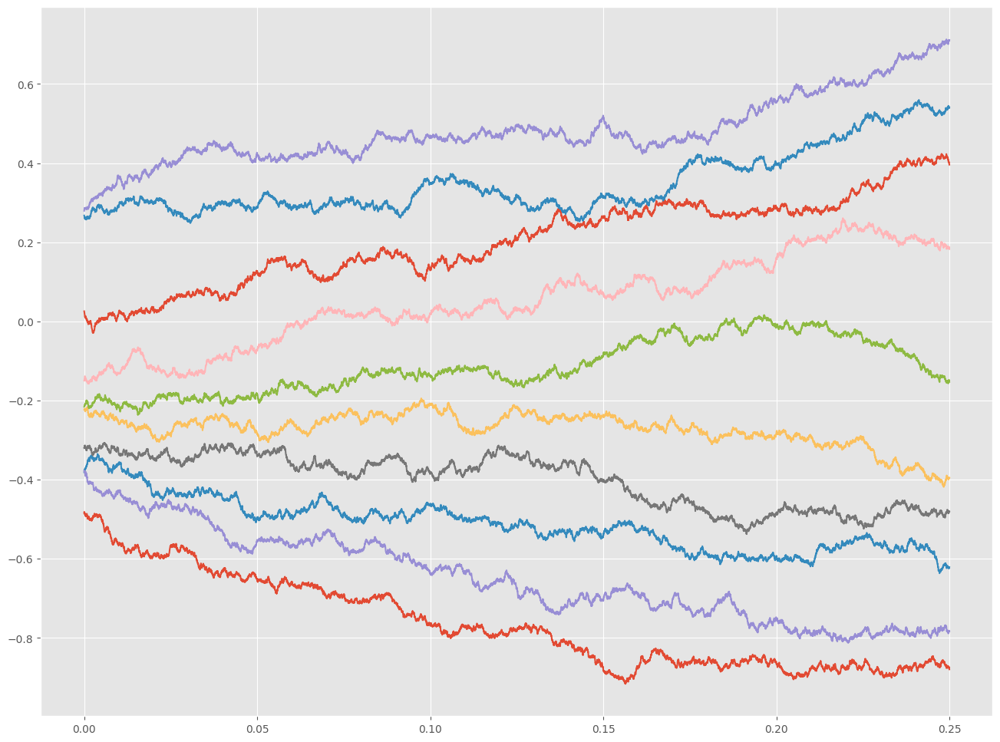

In [133]:
#DBM Test
N = 10
x01 = makeX0(N, 0.2)
deltBM = dBM(beta, num_steps, T, N)
result, times = DBMnp(beta, num_steps, T, N, deltBM, x01)
plt.plot(times, result.T)
plt.show()